In [1]:
# reload packages
%load_ext autoreload
%autoreload 2`

### Choose GPU

In [2]:
%env CUDA_DEVICE_ORDER=PCI_BUS_ID
%env CUDA_VISIBLE_DEVICES=3

env: CUDA_DEVICE_ORDER=PCI_BUS_ID
env: CUDA_VISIBLE_DEVICES=3


In [3]:
import tensorflow as tf
gpu_devices = tf.config.experimental.list_physical_devices('GPU')
if len(gpu_devices)>0:
    tf.config.experimental.set_memory_growth(gpu_devices[0], True)
print(gpu_devices)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [4]:
tf.keras.backend.clear_session()

### dataset information

In [5]:
from datetime import datetime

dataset = "mnist"
dims = (28, 28, 1)
umap_prop = 1.0
num_classes = 10
PROJECTION_DIMS = 1024
labels_per_class = 16  # 'full'
datestring = datetime.now().strftime("%Y_%m_%d_%H_%M_%S_%f")
datestring = (
    str(dataset)
    + "_"
    + str(umap_prop)
    + "_"
    + str(PROJECTION_DIMS)
    + "_"
    + str(labels_per_class)
    + "____"
    + datestring
    + '__linear-umap-euclidean'
)
print(datestring)

mnist_1.0_1024_16____2020_08_07_23_09_37_900420__linear-umap-euclidean


### Load packages

In [6]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tqdm.autonotebook import tqdm
from IPython import display
import pandas as pd
import umap
import copy
import os, tempfile

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


### Load dataset

In [7]:
from tfumap.load_datasets import load_MNIST, mask_labels

In [8]:
X_train, X_test, X_valid, Y_train, Y_test, Y_valid = load_MNIST(flatten=False)
X_train.shape

(50000, 28, 28, 1)

In [9]:
if labels_per_class == "full":
    X_labeled = X_train
    Y_masked = Y_labeled = Y_train
else:
    X_labeled, Y_labeled, Y_masked = mask_labels(
        X_train, Y_train, labels_per_class=labels_per_class
    )

### Build umap graph

In [10]:
from tfumap.semisupervised import build_fuzzy_simplicial_set

In [11]:
n_neighbors = 15  # default = 15
umap_graph = build_fuzzy_simplicial_set(
    X_train.reshape((len(X_train), np.product(np.shape(X_train)[1:]))),
    y=Y_masked,
    n_neighbors=n_neighbors,
)

### Build data iterators

In [12]:
from tfumap.umap import compute_cross_entropy, get_graph_elements
from tfumap.semisupervised import create_edge_iterator, create_validation_iterator, create_classification_iterator

In [13]:
n_epochs = 200
graph, epochs_per_sample, head, tail, weight, n_vertices = get_graph_elements(
            umap_graph, n_epochs
)
batch_size = np.min([n_vertices, 1000])
batch_size

1000

In [14]:
# make sure batch size is no bigger than the number of labels per class
labeled_batch_size = batch_size if batch_size < len(Y_labeled) else len(Y_labeled)
labeled_iter = create_classification_iterator(X_labeled, Y_labeled, batch_size=batch_size)
print(labeled_batch_size)

160


In [15]:
max_sample_repeats_per_epoch = 25
edge_iter, n_edges_per_epoch = create_edge_iterator(
    head,
    tail,
    weight,
    batch_size=batch_size,
    max_sample_repeats_per_epoch=max_sample_repeats_per_epoch,
)

In [16]:
data_valid, n_valid_samp = create_validation_iterator(X_valid, Y_valid, batch_size, repeat=True)

### Build network

In [17]:
encoder = tf.keras.Sequential()
encoder.add(tf.keras.layers.InputLayer(input_shape=dims))
encoder.add(tf.keras.layers.Conv2D(
    filters=32, kernel_size=3, strides=1, padding="same", activation="relu"
))
encoder.add(tf.keras.layers.Conv2D(
    filters=64, kernel_size=3, strides=1, padding="same", activation="relu"
))
encoder.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
encoder.add(tf.keras.layers.Dropout(0.25))
encoder.add(tf.keras.layers.Flatten())
encoder.add(tf.keras.layers.Dense(units=128, activation="relu"))
encoder.add(tf.keras.layers.Dropout(0.25))

In [18]:
classifier = tf.keras.Sequential()
classifier.add(tf.keras.layers.InputLayer(input_shape=128))
classifier.add(tf.keras.layers.Dense(units=128, activation="relu"))
classifier.add(tf.keras.layers.Dense(units=128, activation="relu"))
classifier.add(tf.keras.layers.Dense(num_classes, activation='softmax', name="predictions"))

In [19]:
encoder.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 28, 28, 32)        320       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 28, 28, 64)        18496     
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 14, 14, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 14, 14, 64)        0         
_________________________________________________________________
flatten (Flatten)            (None, 12544)             0         
_________________________________________________________________
dense (Dense)                (None, 128)               1605760   
_________________________________________________________________
dropout_1 (Dropout)          (None, 128)               0

### Create UMAP object

In [20]:
from tfumap.semisupervised_model import PUMAP, compute_classifier_loss

In [21]:
def compute_umap_loss(
    batch_to,
    batch_from,
    encoder,
    _a,
    _b,
    negative_sample_rate=5,
    repulsion_strength=1,
):
    """
        compute the cross entropy loss for learning embeddings

        Parameters
        ----------
        batch_to : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (to)
        batch_from : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (from)

        Returns
        -------
        ce_loss : tf.float
            cross entropy loss for UMAP
        embedding_to : tf.float
            embeddings for verticies (to)
        embedding_from : tf.float
            embeddings for verticies (from)
        """

    # encode
    embedding_to = encoder(batch_to)
    embedding_from = encoder(batch_from)

    # get negative samples
    embedding_neg_to = tf.repeat(embedding_to, negative_sample_rate, axis=0)
    repeat_neg = tf.repeat(embedding_from, negative_sample_rate, axis=0)
    embedding_neg_from = tf.gather(
        repeat_neg, tf.random.shuffle(tf.range(tf.shape(repeat_neg)[0]))
    )

    #  distances between samples
    distance_embedding = tf.concat(
        [
            tf.norm(embedding_to - embedding_from, axis=1),
            tf.norm(embedding_neg_to - embedding_neg_from, axis=1),
        ],
        axis=0,
    )

    # convert probabilities to distances
    probabilities_distance = convert_distance_to_probability(distance_embedding, _a, _b)

    # treat positive samples as p=1, and negative samples as p=0
    probabilities_graph = tf.concat(
        [tf.ones(embedding_to.shape[0]), tf.zeros(embedding_neg_to.shape[0])], axis=0,
    )

    # cross entropy loss
    (attraction_loss, repellant_loss, ce_loss) = compute_cross_entropy(
        probabilities_graph,
        probabilities_distance,
        repulsion_strength=repulsion_strength,
    )

    return (
        attraction_loss,
        repellant_loss,
        ce_loss,
    )


In [22]:
import tensorflow as tf
from tfumap.umap import compute_cross_entropy, convert_distance_to_probability
from tfumap.semisupervised import (
    find_a_b,
    #compute_umap_loss,
    # compute_classifier_loss,
    batch_data,
)
import numpy as np
import os, tempfile
from tqdm.autonotebook import tqdm
from datetime import datetime


@tf.function
def compute_classifier_loss(X, y, encoder, classifier, sparse_ce, acc_func):
    """ compute the cross entropy loss for classification
        """
    d = classifier(encoder(X))
    loss = sparse_ce(y, d)
    acc = acc_func(y, d)
    #acc = tf.keras.metrics.sparse_categorical_accuracy(y, d)
    return loss, acc


class PUMAP(tf.keras.Model):
    def __init__(
        self,
        encoder,
        classifier,
        tensorboard_logdir=None,  # directory for tensorboard log
        min_dist=0.1,
        negative_sample_rate=5.0,
        optimizer=tf.keras.optimizers.SGD(0.1),
        repulsion_strength=1.0,
        # ** kwargs,
    ):
        super(PUMAP, self).__init__()
        # self.__dict__.update(kwargs)

        # subnetworks
        self.encoder = encoder
        self.classifier = classifier


        # optimizer for cross entropy minimization
        self.optimizer = optimizer
        self.repulsion_strength = repulsion_strength
        self.negative_sample_rate = negative_sample_rate

        # get a,b for current min_dist
        self._a, self._b = find_a_b(min_dist)

        # create summary writer to log loss information during training
        if tensorboard_logdir is None:
            self.tensorboard_logdir = os.path.join(
                tempfile.gettempdir(),
                "tensorboard",
                datetime.now().strftime("%Y%m%d-%H%M%S"),
            )
        else:
            self.tensorboard_logdir = tensorboard_logdir
        self.summary_writer_train = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/train"
        )
        self.summary_writer_valid = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/valid"
        )

        # sparse categorical cross entropy
        self.sparse_ce = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
        self.class_acc = tf.keras.metrics.SparseCategoricalAccuracy()
        self.class_acc_val = tf.keras.metrics.SparseCategoricalAccuracy()

        # self.create_summary_metrics()

    @tf.function
    def train(self, batch_to, batch_from, X, y, umap_prop = 1.0, save_loss=False):
        """ One training step 
        Input are points and weights for positive and negative 
        samples for training. 
            
        """
        if umap_prop > 0:
            with tf.GradientTape() as tape:

                (attraction_loss, repellant_loss, umap_loss) = compute_umap_loss(
                    batch_to,
                    batch_from,
                    self.encoder,
                    self._a,
                    self._b,
                    self.negative_sample_rate,
                    self.repulsion_strength,
                )
            
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = (
                    tf.reduce_mean(classifier_loss)
                    + tf.reduce_mean(umap_loss) * umap_prop
                )

            train_vars = (
                self.encoder.trainable_variables
                + self.classifier.trainable_variables
            )
        else:  # ignore running costly UMAP computations if not training on UMAP loss
            with tf.GradientTape() as tape:
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = classifier_loss
            train_vars = (
                self.encoder.trainable_variables + self.classifier.trainable_variables
            )
            attraction_loss = repellant_loss = umap_loss = 0

        # compute gradient for umap
        grad = tape.gradient(loss, train_vars)

        # gradients are cliped in UMAP implementation. Any effect here?
        grad = [tf.clip_by_value(grad, -4.0, 4.0) for grad in grad]

        self.optimizer.apply_gradients(zip(grad, train_vars))

        return (
            attraction_loss,
            repellant_loss,
            tf.reduce_mean(umap_loss),
            classifier_loss,
            classifier_acc,
        )

    @tf.function
    def write_losses(
        self,
        step,
        classifier_acc,
        classifier_loss,
        umap_loss,
        classifier_loss_val,
        classifier_acc_val,
    ):
        # write train loss
        with self.summary_writer_train.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss, step=step,
            )
            tf.summary.scalar(
                "umap_loss", umap_loss, step=step,
            )
            self.summary_writer_train.flush()
        # write valid loss
        with self.summary_writer_valid.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc_val, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss_val, step=step,
            )
            self.summary_writer_valid.flush()



In [23]:
### Initialize model
model = PUMAP(
    min_dist = 0.0,
    negative_sample_rate = 5, # how many negative samples per positive
    optimizer=tf.keras.optimizers.Adam(1e-3), # cross-entropy optimizer
    encoder=encoder,
    classifier=classifier,    
)

### plotting results

In [24]:
def model_data(X, batch_size, model):
    """ embed a set of points in X to Z
    """
    n_batch = int(np.ceil(len(X) / batch_size))
    return np.vstack(
        [
                model(np.array(X[(i) * batch_size : (i + 1) * batch_size, :]))
            for i in tqdm(range(n_batch), leave=False)
        ]
    )

In [25]:
from tfumap.umap import retrieve_tensors
from sklearn.decomposition import PCA
import seaborn as sns
from umap import UMAP 

def plot_umap_classif_results(
    model,
    X_valid,
    Y_valid,
    X_train,
    X_labeled,
    Y_labeled,
    batch_size,
    dralg = PCA, #umap
    cmap="coolwarm",
    cmap2="bwr",
):
    # get loss dataframe from tensorboard
    try:
        loss_df = retrieve_tensors(model.tensorboard_logdir)
        losses_exist = True
    except ValueError as e:
        print(e)
        losses_exist = False

    pred_model = tf.keras.models.Model(model.classifier.input,[model.classifier.get_layer(name="dense_1").get_output_at(0)])

    # embed data
    enc_valid = model_data(X_valid, batch_size, model.encoder)
    class_valid = model_data(enc_valid, batch_size, pred_model)
    pred_valid = model_data(enc_valid, batch_size, model.classifier)

    enc_lab = model_data(X_labeled, batch_size, model.encoder)
    class_lab = model_data(enc_lab, batch_size, pred_model)
    pred_lab = model_data(enc_lab, batch_size, model.classifier)

    # get classifications and correctness
    classifications_valid = np.argmax(pred_valid, axis=1)
    correctness_valid = classifications_valid == Y_valid

    classifications_lab = np.argmax(pred_lab, axis=1)
    correctness_lab = classifications_lab == np.array(Y_labeled)

    confidence_lab  = np.max(pred_lab, axis=1)
    confidence_valid = np.max(pred_valid, axis=1)

    thresh = 0.0 #0.8
    mask_valid = confidence_valid > thresh
    mask_lab = confidence_lab > thresh

    # embed into 2D 
    dr = dralg()
    enc_valid_2 = dr.fit_transform(enc_valid[mask_valid])
    enc_lab_2 = dr.transform(enc_lab[mask_lab])



    dr = dralg()
    class_valid_2 = dr.fit_transform(class_valid[mask_valid])
    class_lab_2 = dr.transform(class_lab[mask_lab])
    
    fig, axs = plt.subplots(ncols=4, nrows=2, figsize=(14, 6), gridspec_kw = {'wspace':0, 'hspace':0})
    for row, (z_val, z_lab, z_title) in enumerate([
        [enc_valid_2, enc_lab_2, 'encoder'], 
        [class_valid_2, class_lab_2, 'last_layer_classifier'], 

    ]):
        for col, (y_valid, y_labeled, label_name) in enumerate([
            [Y_valid, Y_labeled, 'ground_truth'],
            [classifications_valid, classifications_lab, 'predictions'],
            [correctness_valid, correctness_lab, 'correctness'],
            [confidence_valid, confidence_lab, 'confidence'],
        ]):
            ax = axs[row, col]
            #ax.axis('off')
            if col == 0:
                ax.set_ylabel(z_title)
            if row == 0:
                ax.set_title(label_name)
            #ax.set_title(z_title + '_' + label_name)
            ax.scatter(
                z_val[:, 0],
                z_val[:, 1],
                c=y_valid[mask_valid],
                cmap=cmap if label_name not in ["correctness", "confidence"]  else 'viridis',  # "tab10"
                s=2,
                alpha=0.25,
                rasterized=True,
            )
            if False:
                ax.scatter(
                    z_lab[:, 0],
                    z_lab[:, 1],
                    c=y_labeled[mask_lab],
                    cmap=cmap if label_name not in ["correctness", "confidence"] else 'viridis',  # "tab10"
                    s=20,
                    alpha=0.25,
                    rasterized=True,
                )
            ax.set_xticks([])
            ax.set_yticks([])
        
    plt.show()
    
    fig, axs = plt.subplots(ncols=3, figsize=(14,2))
    if losses_exist:
        ax = axs[0]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "umap_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.legend(loc="upper right")
        ax.set_xscale("log")
        ax.set_title("UMAP loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[1]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="upper right")
        # ax.set_yscale("log")
        ax.set_title("Classif loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[2]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_acc"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="lower right")
        ax.set_title("Classif acc", fontsize=24)
        ax.set_ylabel("Acc")
    plt.show()

No objects to concatenate


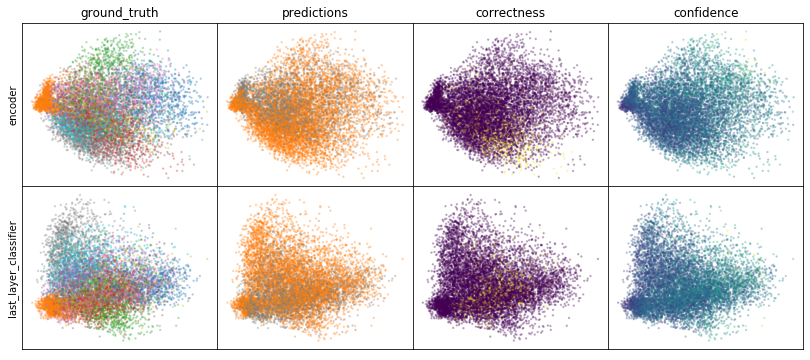

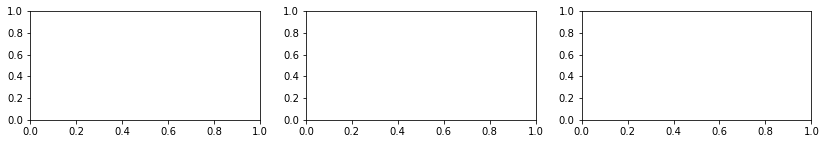

In [26]:
plot_umap_classif_results(model, X_valid, Y_valid, X_train, X_labeled, Y_labeled, batch_size, dralg=PCA, cmap='tab10', cmap2='tab10')

### Train model

In [27]:
N_EPOCHS = 50
n_neighbors=15
batch_size = 256 # 500
max_sample_repeats_per_epoch = 25
max_save_delta = 0.005

In [28]:
from tfumap.semisupervised import build_fuzzy_simplicial_set

In [29]:
from tfumap.paths import MODEL_DIR

In [30]:
# where to save checkpoints
cpt_path = MODEL_DIR / 'semisupervised' / dataset / datestring

In [31]:
BATCHES_PER_EPOCH = int(n_edges_per_epoch / batch_size)

In [32]:
patience = 10000 # wait this many batches without improvement before early stopping
min_delta = 0.0001 # threshold for what counts as an improvement
best_acc = 0 # the best current accuracy score
best_saved_acc = 0 # best accuracy on valid data that has been checkpointed
best_saved_batch = 0 # batch number for last good batch
max_reinitialize_delta = .01 # minimum loss in accuracy resulting in reinitialized weights
plot_frequency = 1000 # how frequently to plot
max_reloads = 10 # how often can we reload weights?
batch = 0; epoch = 0
batches_since_last_reload = 0

In [33]:
epochs_without_improvement = 0
max_epochs_without_improvement = 5 # allow the network 
reload_tolerance = 100 # allow the network at least reload_tolerance batches before reloading last weights

In [34]:
n_reloads = 0

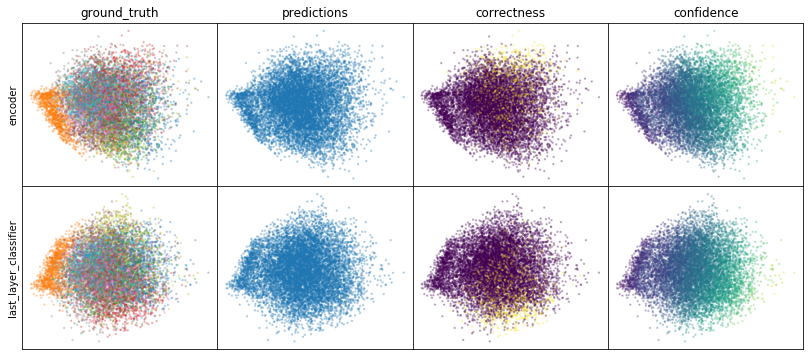

W0807 23:10:44.038026 139838875297536 legend.py:1282] No handles with labels found to put in legend.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:118: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:132: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
W0807 23:10:44.092165 139838875297536 legend.py:1282] No handles with labels found to put in legend.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:148: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
W0807 23:10:44.144256 139838875297536 legend.py:1282] No handles with labels found to put in legend.


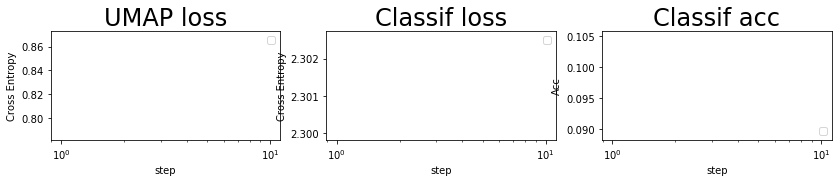

batch: 0 | train acc: 0.089 | val acc: 0.105
saving weights | batch = 100 | acc = 73.523
saving weights | batch = 104 | acc = 74.043
saving weights | batch = 108 | acc = 74.633
saving weights | batch = 113 | acc = 75.205
saving weights | batch = 118 | acc = 75.833
saving weights | batch = 123 | acc = 76.349
saving weights | batch = 128 | acc = 76.878
saving weights | batch = 135 | acc = 77.467
saving weights | batch = 141 | acc = 77.989
saving weights | batch = 148 | acc = 78.531
saving weights | batch = 156 | acc = 79.071
saving weights | batch = 164 | acc = 79.585
saving weights | batch = 173 | acc = 80.113
saving weights | batch = 183 | acc = 80.638
saving weights | batch = 194 | acc = 81.163
saving weights | batch = 206 | acc = 81.689
saving weights | batch = 219 | acc = 82.235
saving weights | batch = 234 | acc = 82.736
saving weights | batch = 249 | acc = 83.246
saving weights | batch = 268 | acc = 83.755
saving weights | batch = 288 | acc = 84.262
saving weights | batch = 311 | 

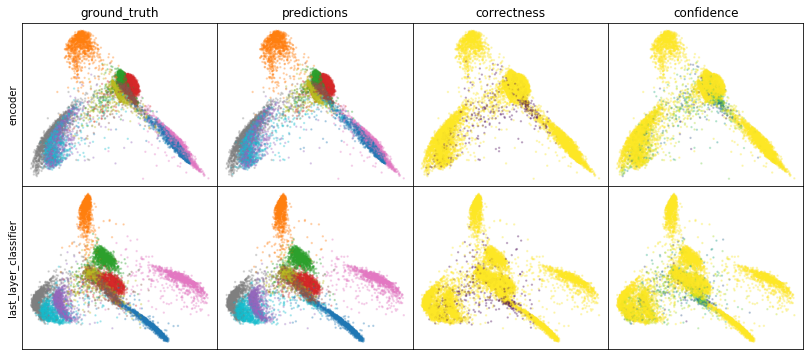

W0807 23:12:08.499740 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:12:08.569525 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:12:08.628265 139838875297536 legend.py:1282] No handles with labels found to put in legend.


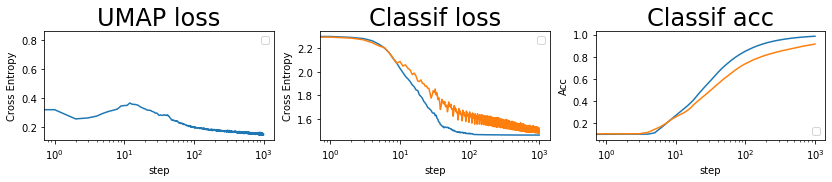

batch: 1000 | train acc: 0.9847 | val acc: 0.9136
saving weights | batch = 1118 | acc = 91.863
saving weights | batch = 1265 | acc = 92.363
saving weights | batch = 1444 | acc = 92.866
saving weights | batch = 1665 | acc = 93.367
saving weights | batch = 1941 | acc = 93.867


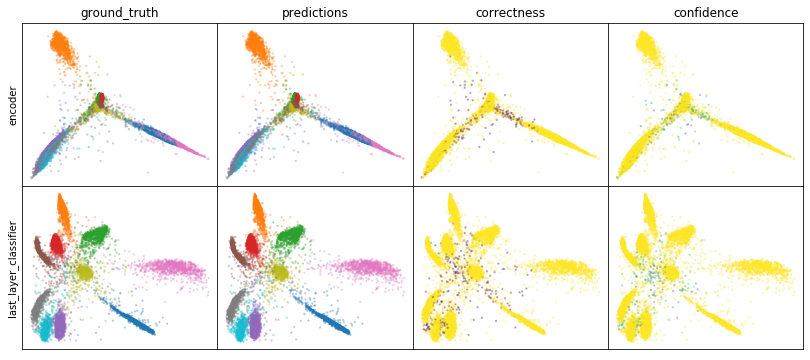

W0807 23:13:31.275238 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:13:31.336591 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:13:31.397302 139838875297536 legend.py:1282] No handles with labels found to put in legend.


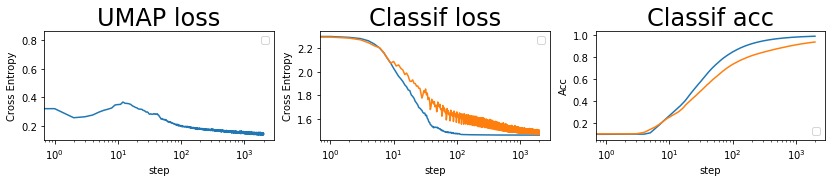

batch: 2000 | train acc: 0.9923 | val acc: 0.9396
saving weights | batch = 2297 | acc = 94.368
saving weights | batch = 2788 | acc = 94.868


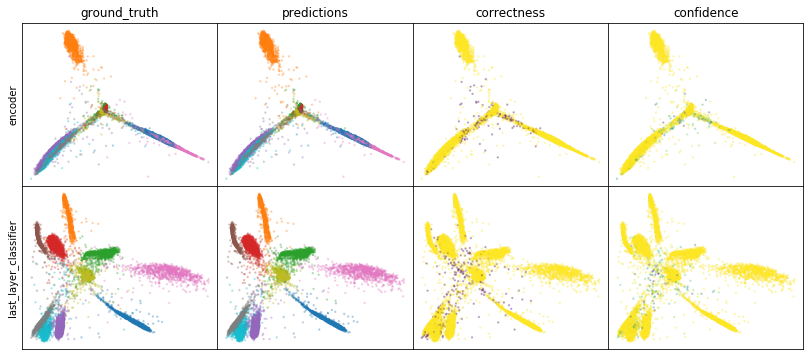

W0807 23:15:29.476902 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:15:29.542760 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:15:29.616434 139838875297536 legend.py:1282] No handles with labels found to put in legend.


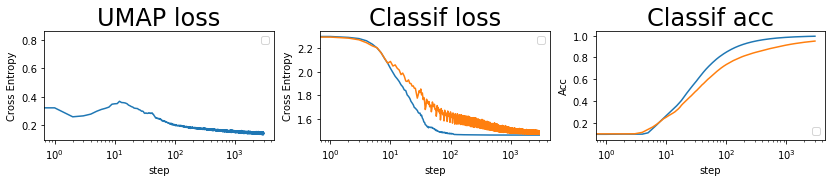

batch: 3000 | train acc: 0.9949 | val acc: 0.9504
saving weights | batch = 3495 | acc = 95.368


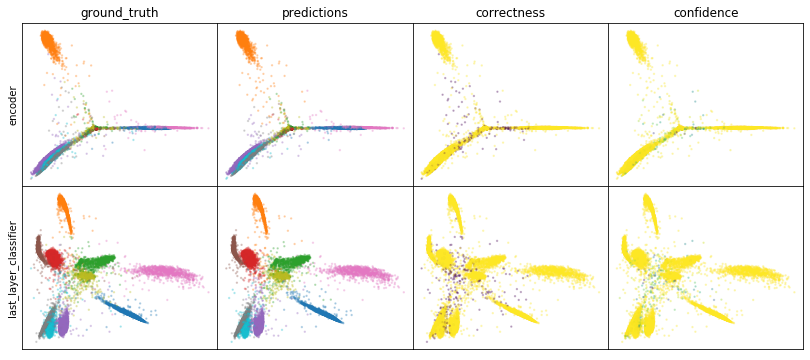

W0807 23:17:36.876565 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:17:36.943797 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:17:37.010502 139838875297536 legend.py:1282] No handles with labels found to put in legend.


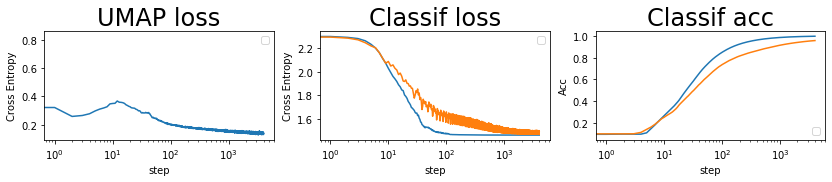

batch: 4000 | train acc: 0.9962 | val acc: 0.9562
saving weights | batch = 4654 | acc = 95.868


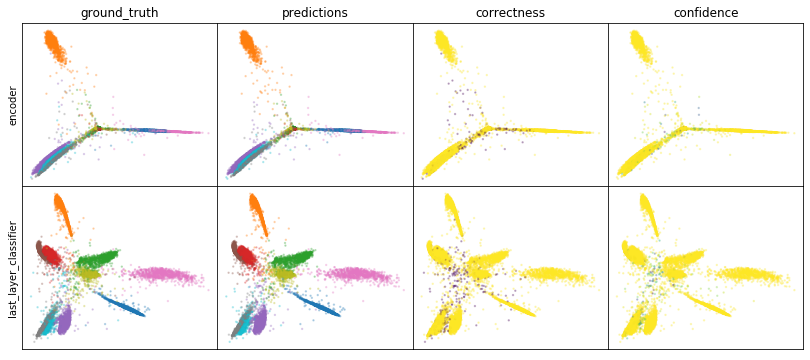

W0807 23:18:59.161321 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:18:59.230284 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:18:59.298496 139838875297536 legend.py:1282] No handles with labels found to put in legend.


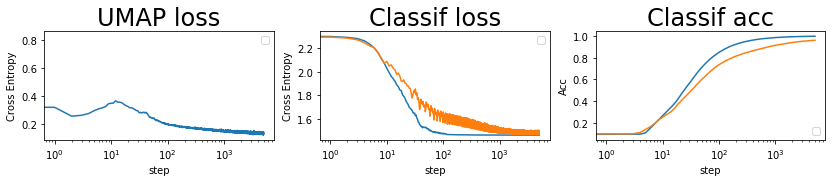

batch: 5000 | train acc: 0.9969 | val acc: 0.9598


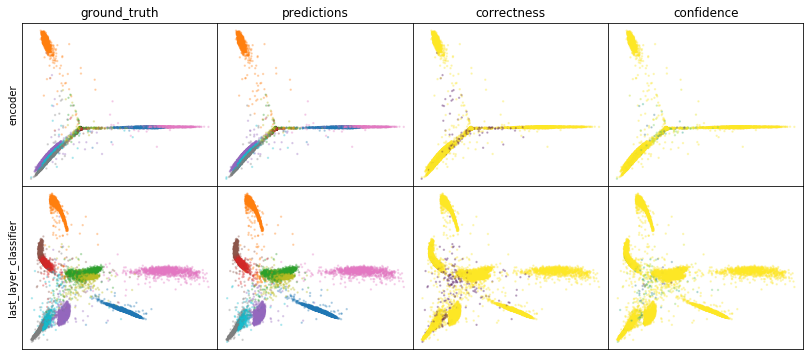

W0807 23:20:21.371361 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:20:21.447860 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:20:21.520269 139838875297536 legend.py:1282] No handles with labels found to put in legend.


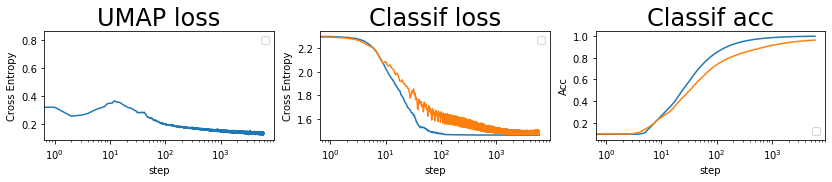

batch: 6000 | train acc: 0.9974 | val acc: 0.9622
saving weights | batch = 6864 | acc = 96.368


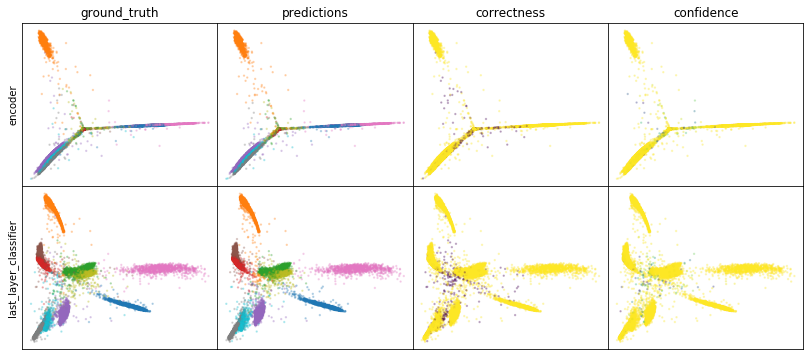

W0807 23:22:23.224529 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:22:23.307380 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:22:23.384921 139838875297536 legend.py:1282] No handles with labels found to put in legend.


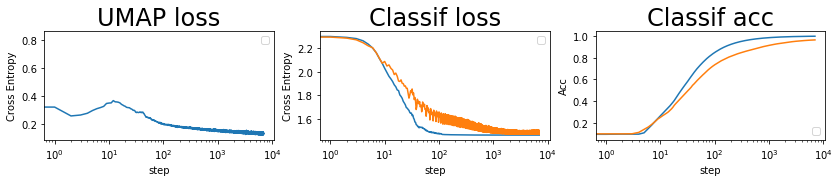

batch: 7000 | train acc: 0.9978 | val acc: 0.9639


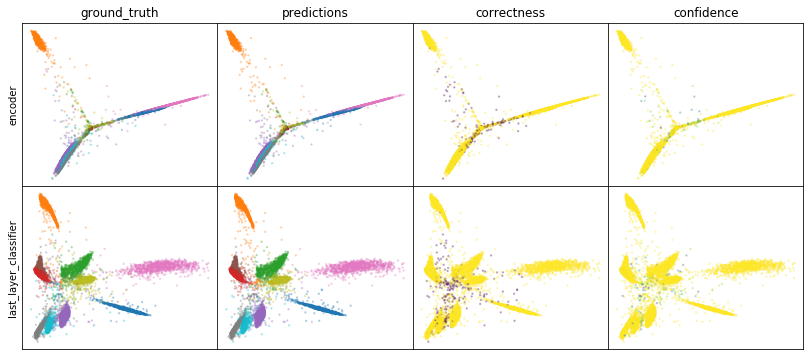

W0807 23:24:19.284818 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:24:19.361374 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:24:19.439126 139838875297536 legend.py:1282] No handles with labels found to put in legend.


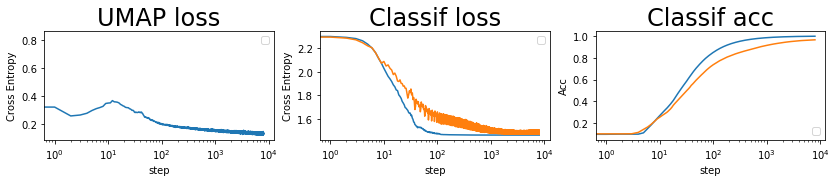

batch: 8000 | train acc: 0.9981 | val acc: 0.965


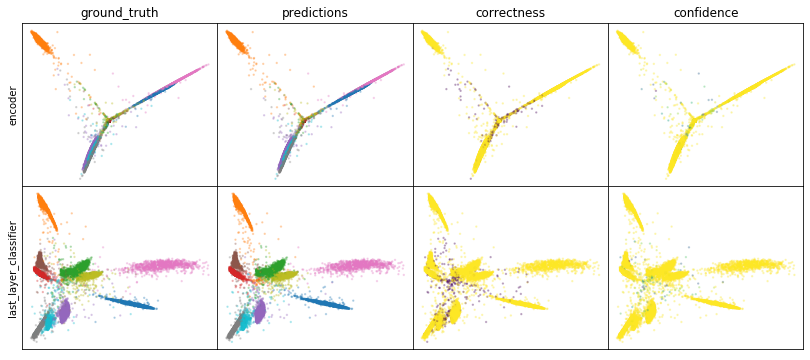

W0807 23:25:46.627495 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:25:46.705527 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:25:46.781608 139838875297536 legend.py:1282] No handles with labels found to put in legend.


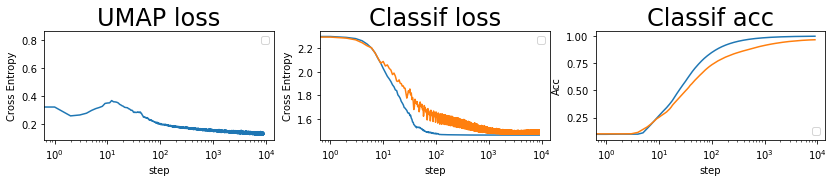

batch: 9000 | train acc: 0.9983 | val acc: 0.9658


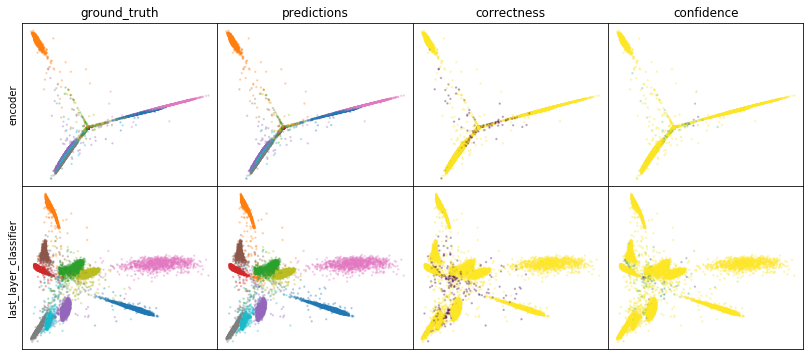

W0807 23:27:11.884480 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:27:11.979825 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:27:12.060165 139838875297536 legend.py:1282] No handles with labels found to put in legend.


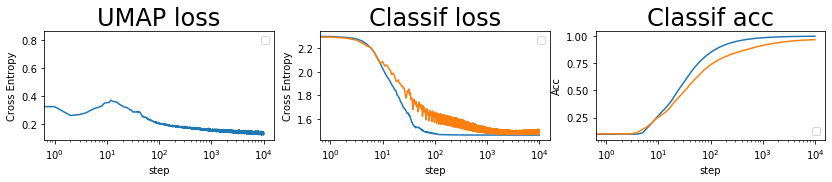

batch: 10000 | train acc: 0.9985 | val acc: 0.9663


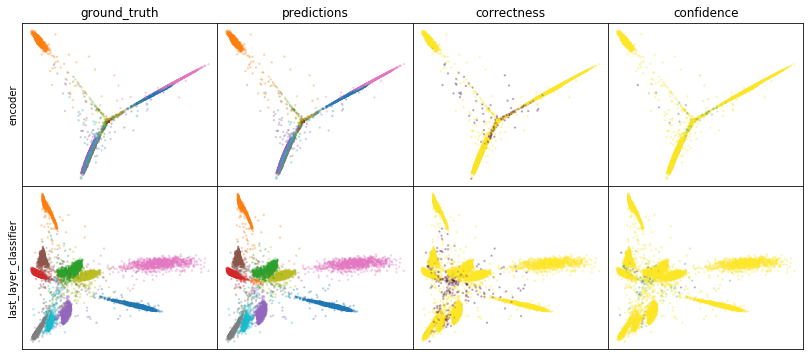

W0807 23:28:59.666101 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:28:59.751885 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:28:59.839387 139838875297536 legend.py:1282] No handles with labels found to put in legend.


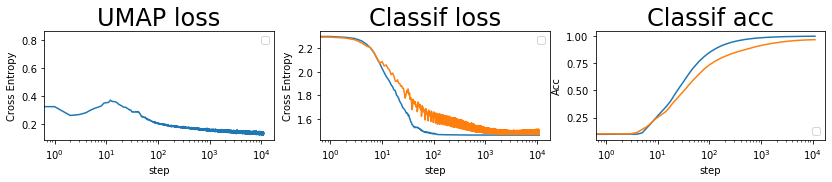

batch: 11000 | train acc: 0.9986 | val acc: 0.9667


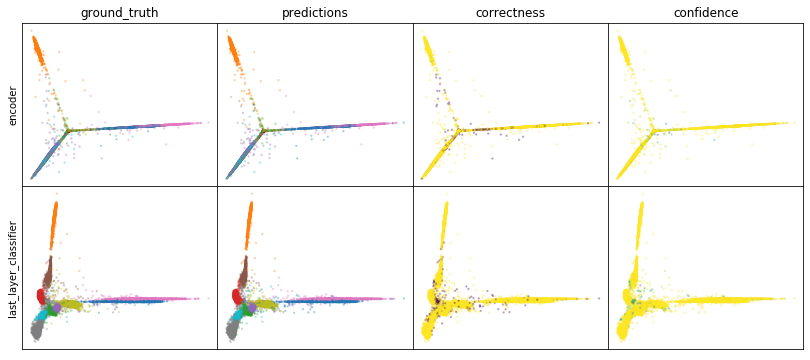

W0807 23:31:23.019597 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:31:23.128923 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:31:23.219166 139838875297536 legend.py:1282] No handles with labels found to put in legend.


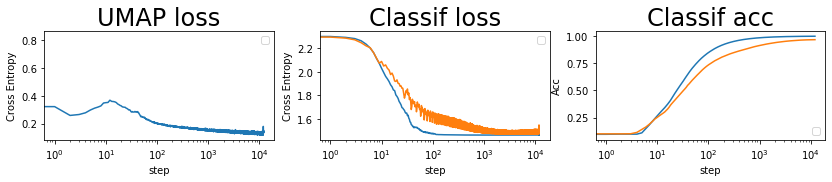

batch: 12000 | train acc: 0.9987 | val acc: 0.9669


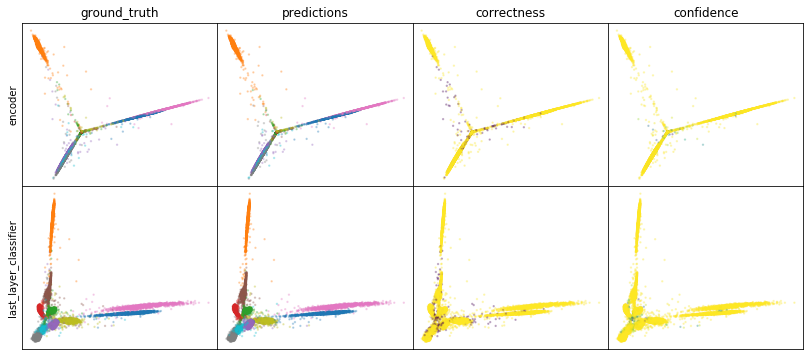

W0807 23:32:49.560578 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:32:49.652831 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:32:49.742386 139838875297536 legend.py:1282] No handles with labels found to put in legend.


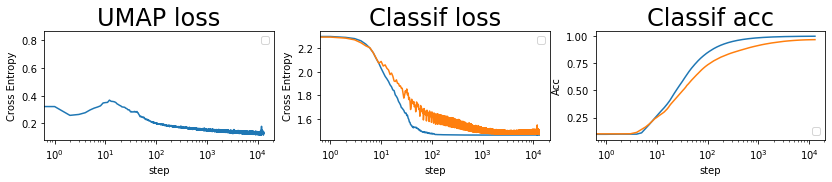

batch: 13000 | train acc: 0.9988 | val acc: 0.9674


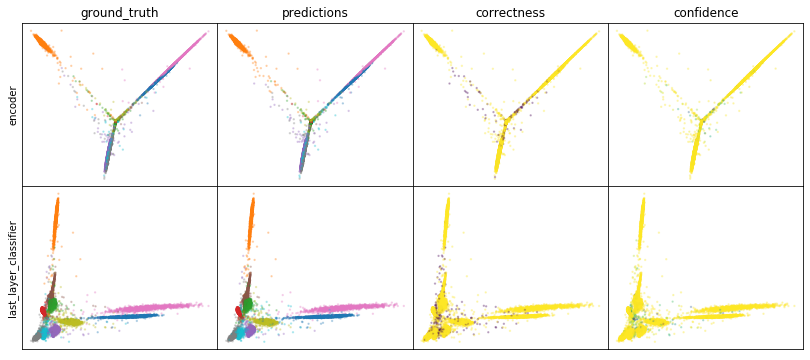

W0807 23:34:16.088189 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:34:16.181455 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:34:16.276774 139838875297536 legend.py:1282] No handles with labels found to put in legend.


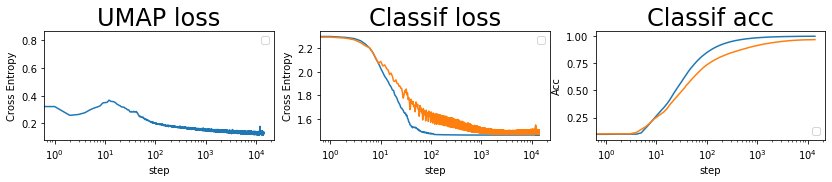

batch: 14000 | train acc: 0.9989 | val acc: 0.9678


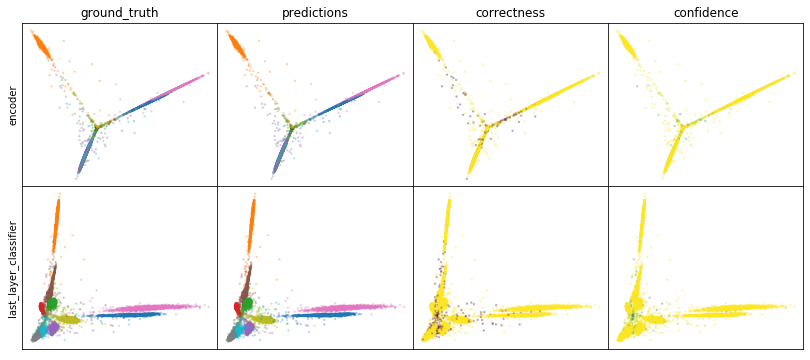

W0807 23:36:15.160410 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:36:15.263243 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:36:15.361827 139838875297536 legend.py:1282] No handles with labels found to put in legend.


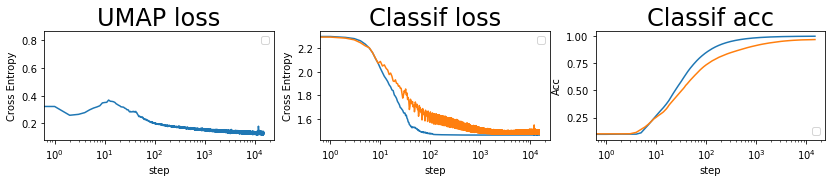

batch: 15000 | train acc: 0.9989 | val acc: 0.9683


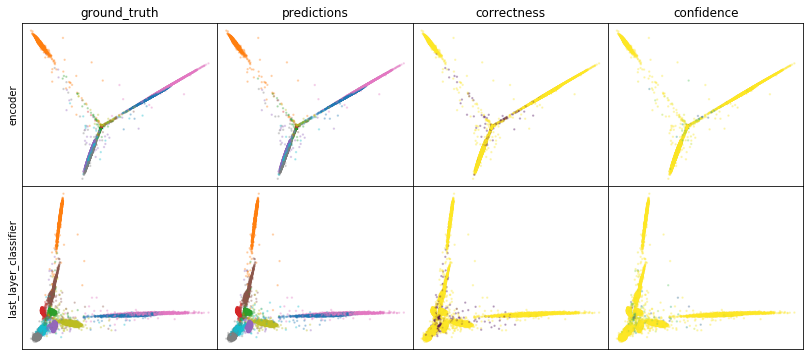

W0807 23:38:13.943709 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:38:14.041898 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:38:14.137789 139838875297536 legend.py:1282] No handles with labels found to put in legend.


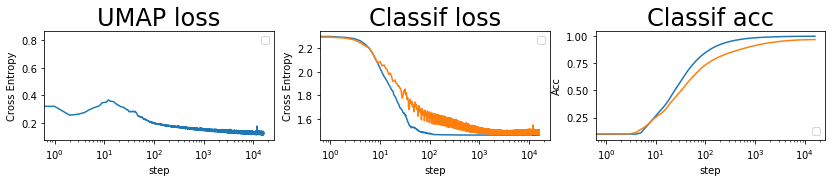

batch: 16000 | train acc: 0.999 | val acc: 0.9686
saving weights | batch = 16313 | acc = 96.868


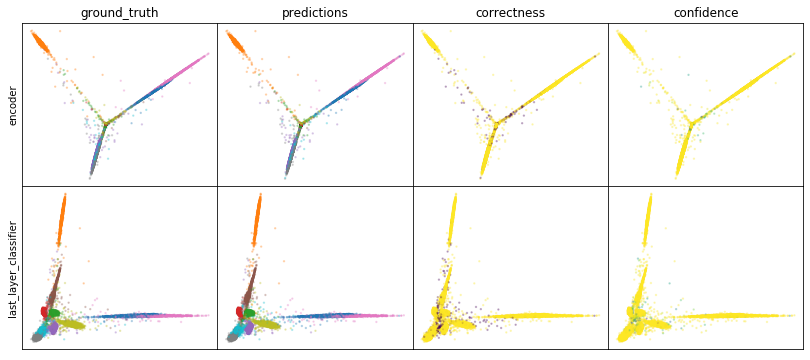

W0807 23:39:46.201902 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:39:46.302965 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:39:46.401354 139838875297536 legend.py:1282] No handles with labels found to put in legend.


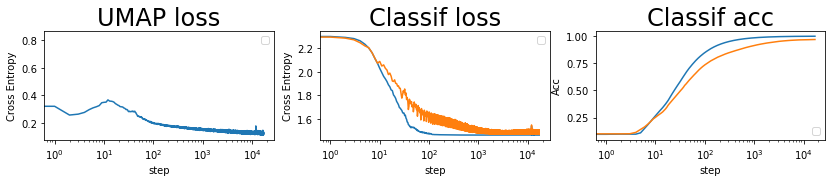

batch: 17000 | train acc: 0.9991 | val acc: 0.9688


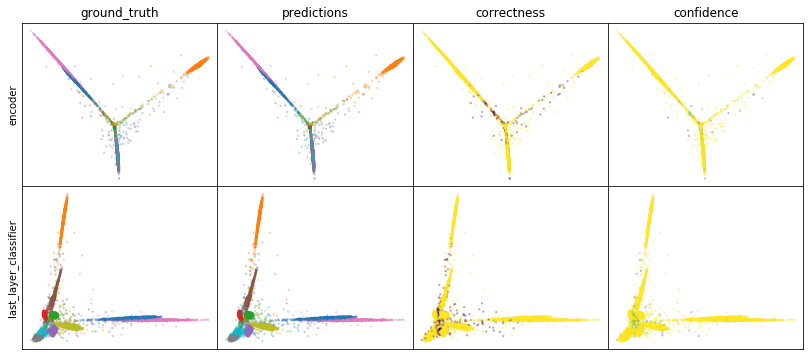

W0807 23:41:13.285889 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:41:13.391257 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:41:13.493494 139838875297536 legend.py:1282] No handles with labels found to put in legend.


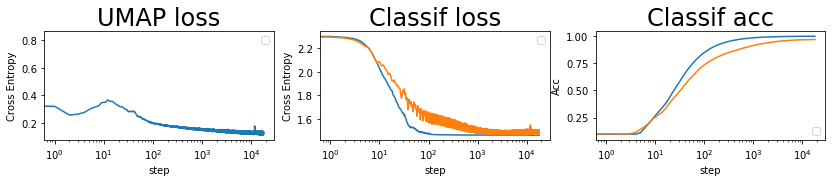

batch: 18000 | train acc: 0.9991 | val acc: 0.969


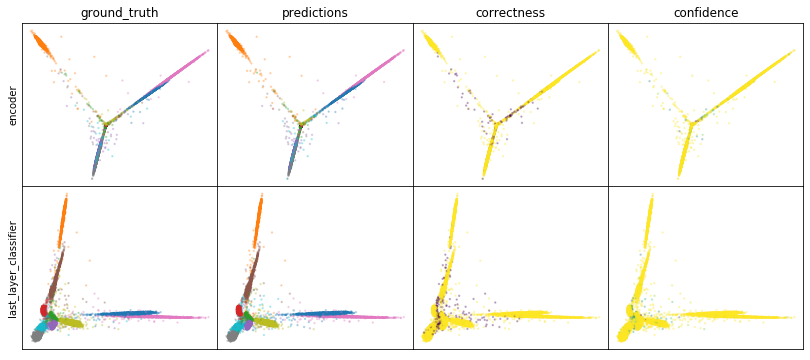

W0807 23:43:05.279617 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:43:05.389274 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:43:05.494386 139838875297536 legend.py:1282] No handles with labels found to put in legend.


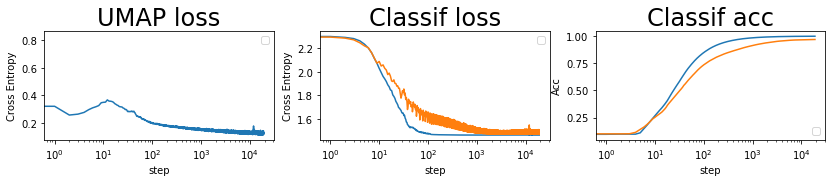

batch: 19000 | train acc: 0.9992 | val acc: 0.9691


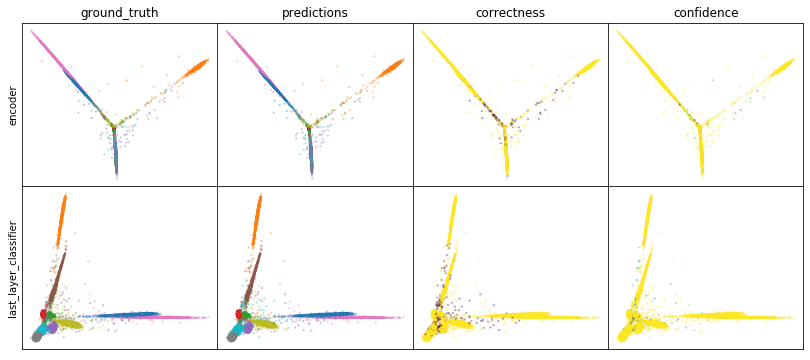

W0807 23:45:26.969184 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:45:27.078713 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:45:27.187368 139838875297536 legend.py:1282] No handles with labels found to put in legend.


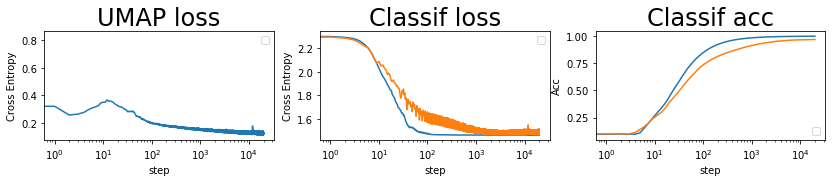

batch: 20000 | train acc: 0.9992 | val acc: 0.9691


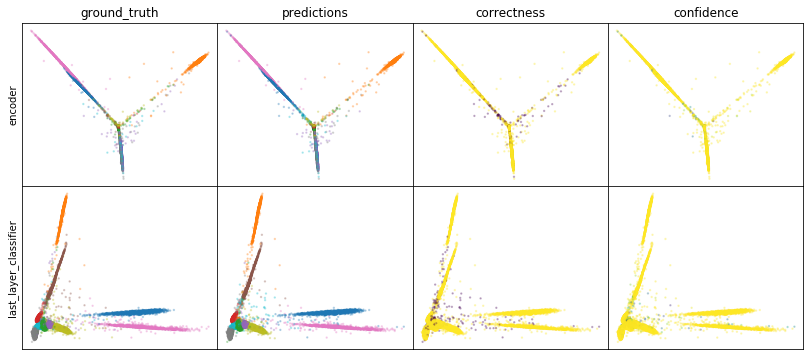

W0807 23:46:57.121484 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:46:57.236000 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:46:57.349872 139838875297536 legend.py:1282] No handles with labels found to put in legend.


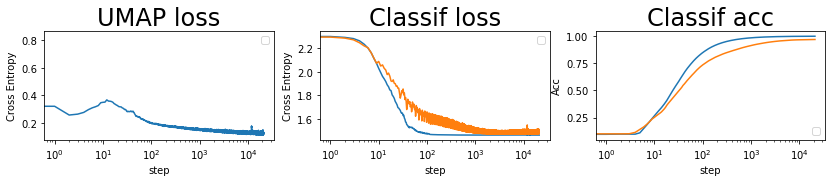

batch: 21000 | train acc: 0.9992 | val acc: 0.9692


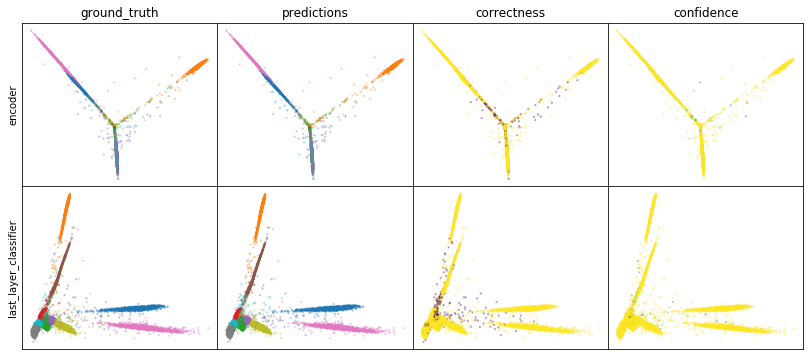

W0807 23:48:27.825554 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:48:27.941684 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:48:28.062418 139838875297536 legend.py:1282] No handles with labels found to put in legend.


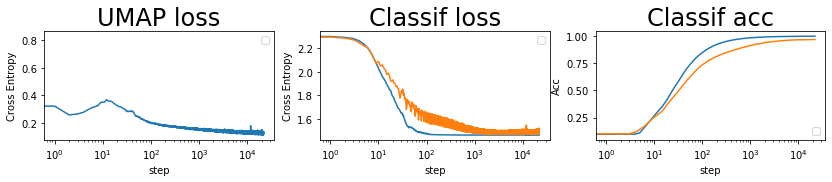

batch: 22000 | train acc: 0.9993 | val acc: 0.969


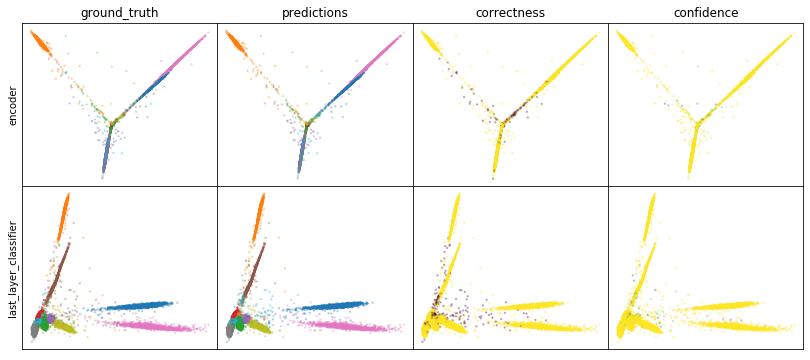

W0807 23:50:43.301179 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:50:43.421869 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:50:43.543744 139838875297536 legend.py:1282] No handles with labels found to put in legend.


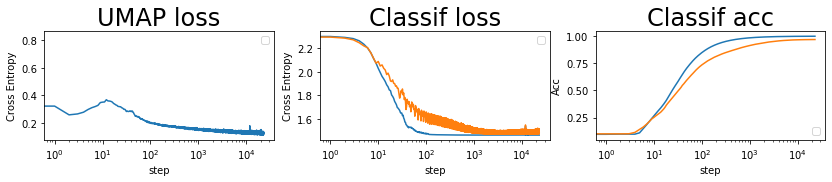

batch: 23000 | train acc: 0.9993 | val acc: 0.9689


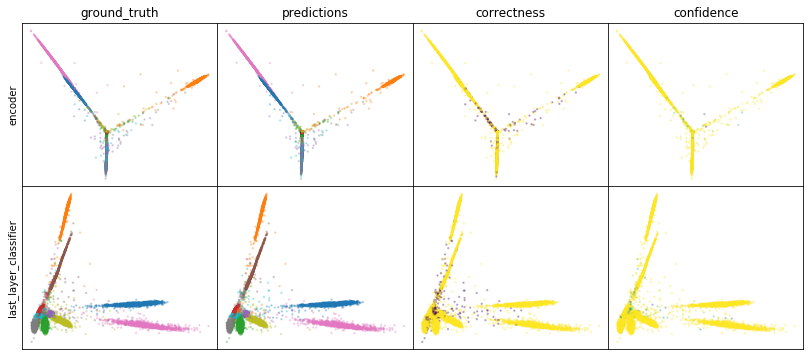

W0807 23:52:44.662719 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:52:44.786077 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:52:44.906588 139838875297536 legend.py:1282] No handles with labels found to put in legend.


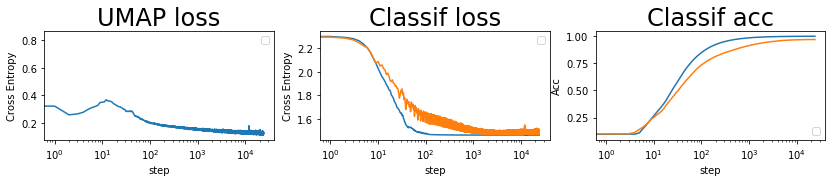

batch: 24000 | train acc: 0.9993 | val acc: 0.9689


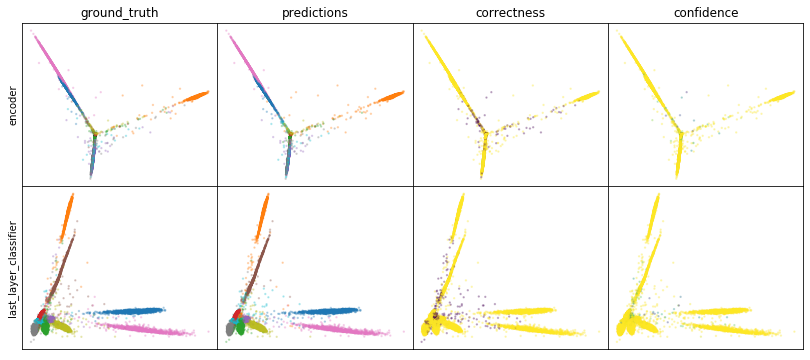

W0807 23:54:33.139471 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:54:33.263175 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:54:33.386605 139838875297536 legend.py:1282] No handles with labels found to put in legend.


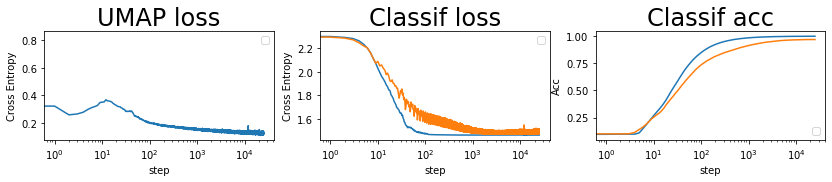

batch: 25000 | train acc: 0.9994 | val acc: 0.9689


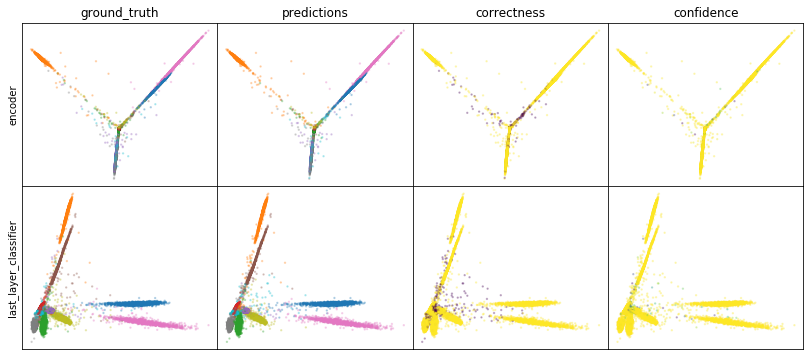

W0807 23:56:06.156993 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:56:06.288907 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:56:06.417284 139838875297536 legend.py:1282] No handles with labels found to put in legend.


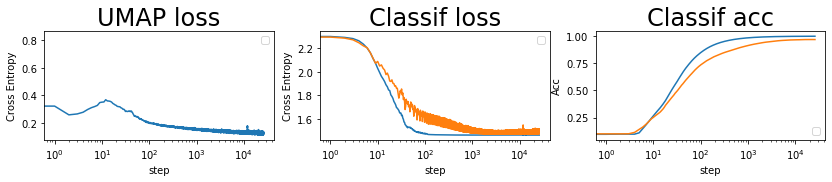

batch: 26000 | train acc: 0.9994 | val acc: 0.9688


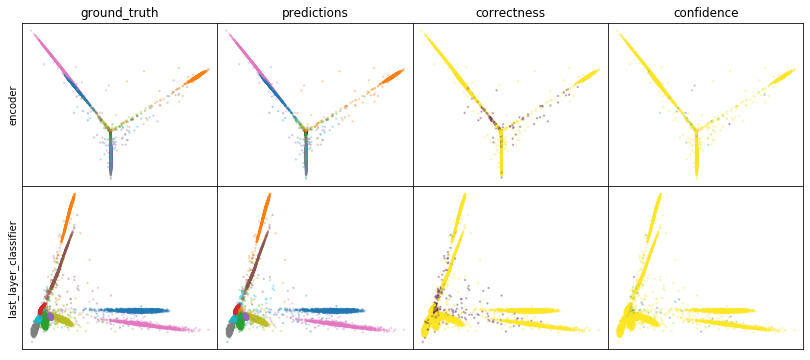

W0807 23:58:36.963308 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:58:37.101101 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0807 23:58:37.232015 139838875297536 legend.py:1282] No handles with labels found to put in legend.


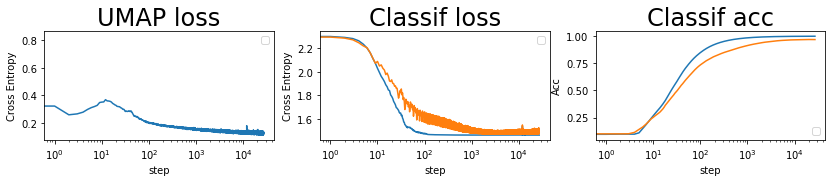

batch: 27000 | train acc: 0.9994 | val acc: 0.9686


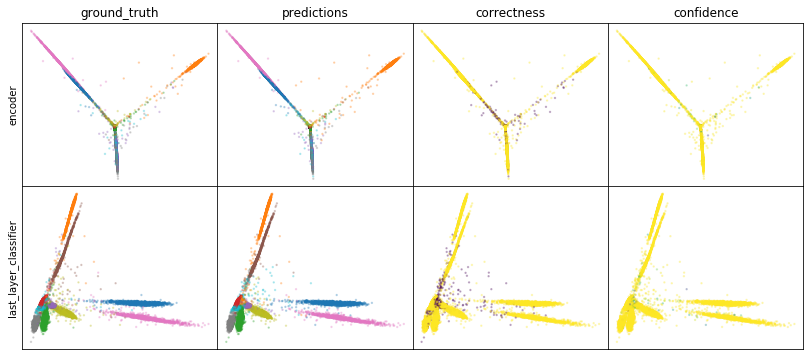

W0808 00:00:25.783330 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:00:25.918128 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:00:26.052284 139838875297536 legend.py:1282] No handles with labels found to put in legend.


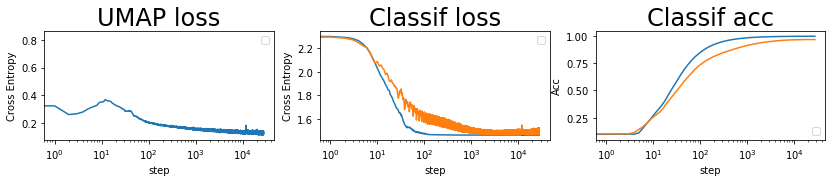

batch: 28000 | train acc: 0.9994 | val acc: 0.9685
leaving epoch because no improvement in 10000 batches


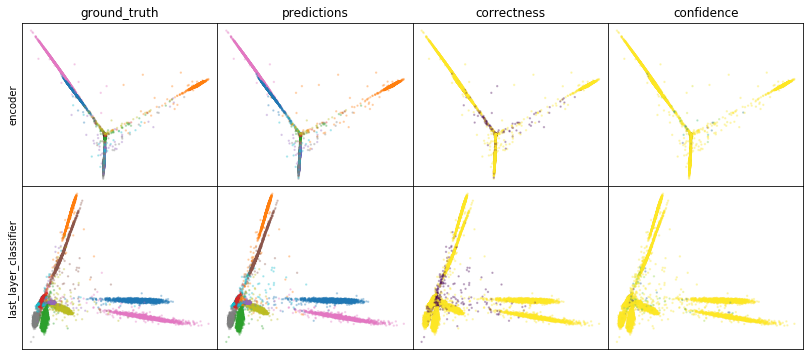

W0808 00:02:00.130635 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:02:00.270087 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:02:00.407473 139838875297536 legend.py:1282] No handles with labels found to put in legend.


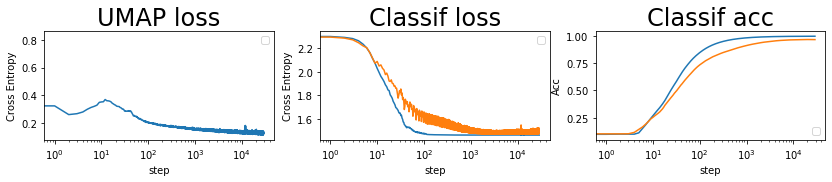

batch: 29000 | train acc: 0.9995 | val acc: 0.9683


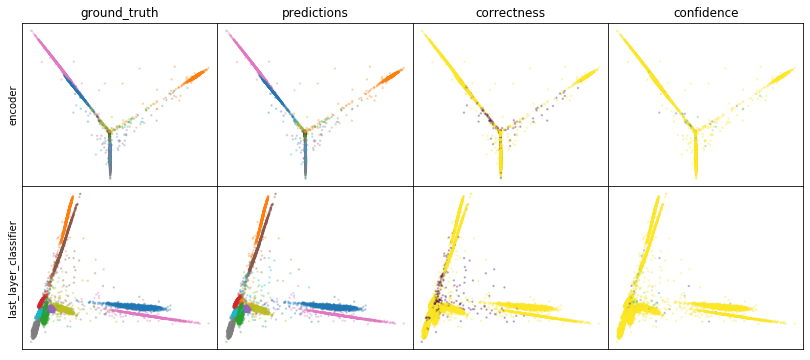

W0808 00:03:51.297327 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:03:51.442693 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:03:51.585500 139838875297536 legend.py:1282] No handles with labels found to put in legend.


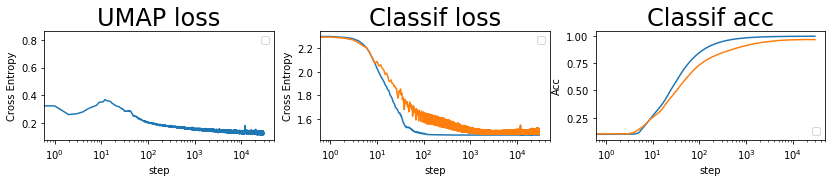

batch: 30000 | train acc: 0.9995 | val acc: 0.9681


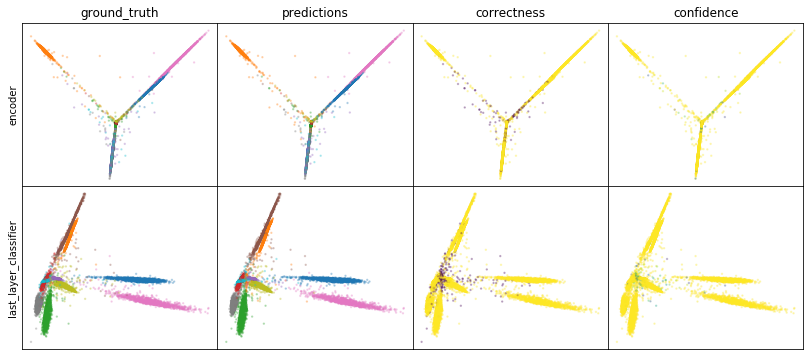

W0808 00:05:56.358496 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:05:56.502002 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:05:56.644920 139838875297536 legend.py:1282] No handles with labels found to put in legend.


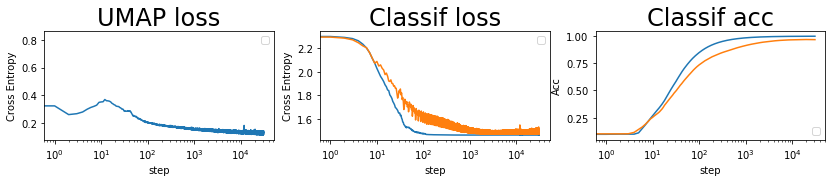

batch: 31000 | train acc: 0.9995 | val acc: 0.9681


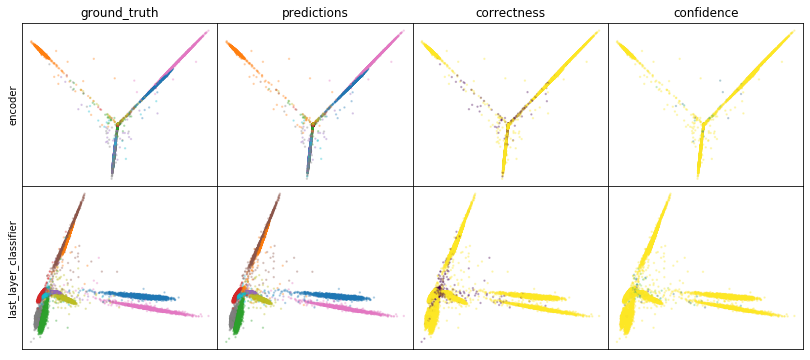

W0808 00:07:41.623443 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:07:41.767678 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:07:41.907126 139838875297536 legend.py:1282] No handles with labels found to put in legend.


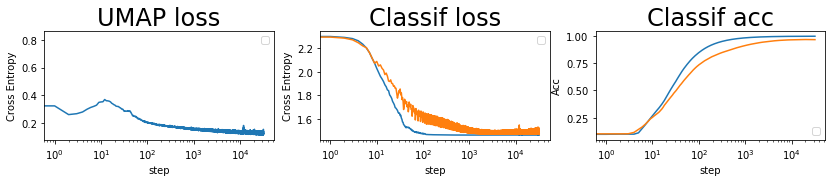

batch: 32000 | train acc: 0.9995 | val acc: 0.9681


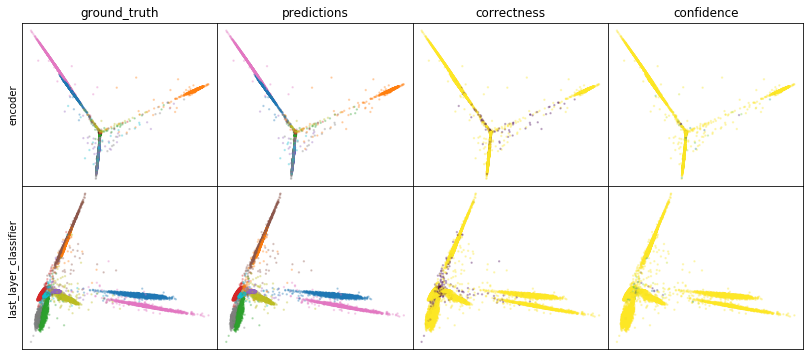

W0808 00:09:16.856368 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:09:17.006249 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:09:17.150546 139838875297536 legend.py:1282] No handles with labels found to put in legend.


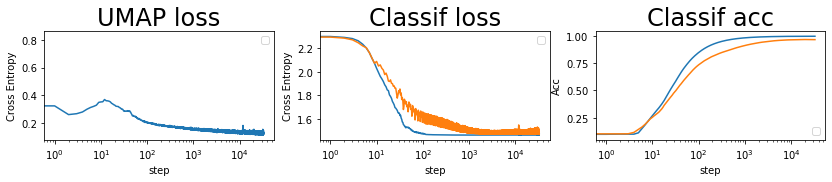

batch: 33000 | train acc: 0.9993 | val acc: 0.9681


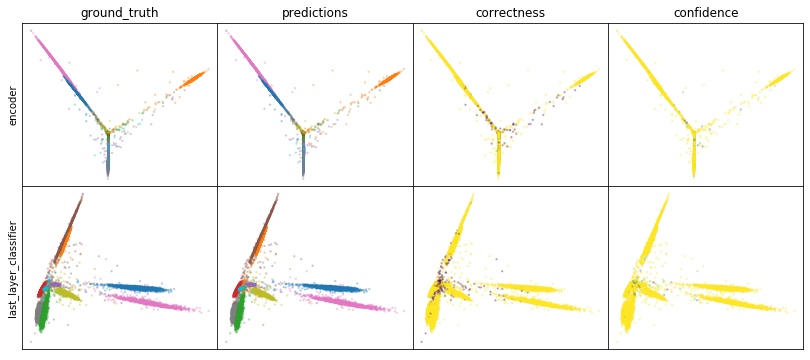

W0808 00:11:17.519371 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:11:17.667439 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:11:17.814970 139838875297536 legend.py:1282] No handles with labels found to put in legend.


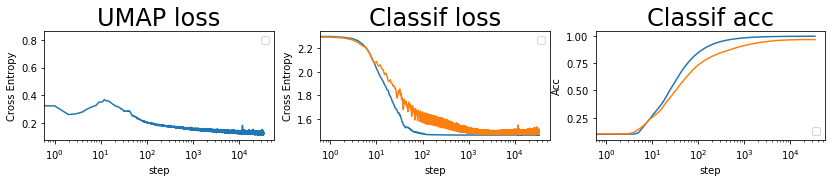

batch: 34000 | train acc: 0.9991 | val acc: 0.9683


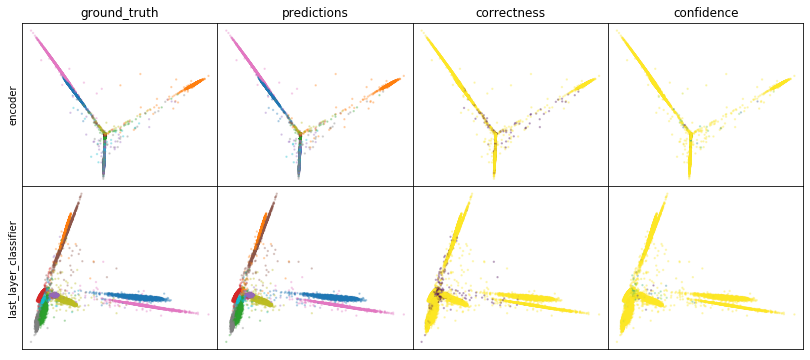

W0808 00:13:38.647528 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:13:38.801198 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:13:38.952004 139838875297536 legend.py:1282] No handles with labels found to put in legend.


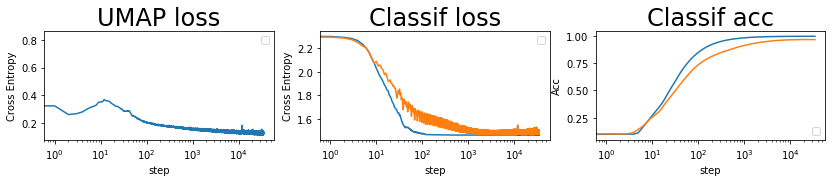

batch: 35000 | train acc: 0.9989 | val acc: 0.9684


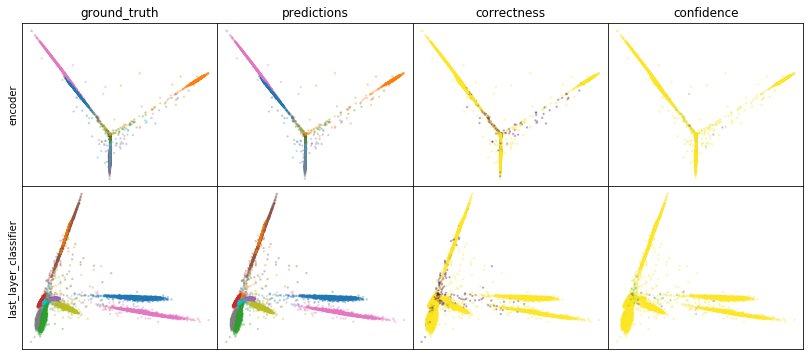

W0808 00:15:15.645631 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:15:15.808072 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:15:15.962513 139838875297536 legend.py:1282] No handles with labels found to put in legend.


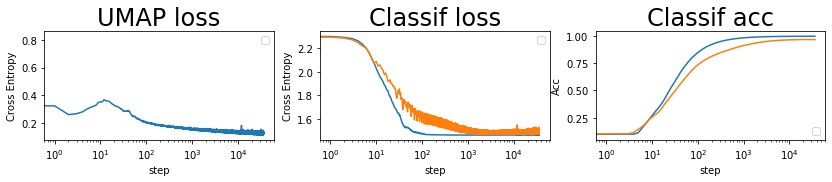

batch: 36000 | train acc: 0.9988 | val acc: 0.9684


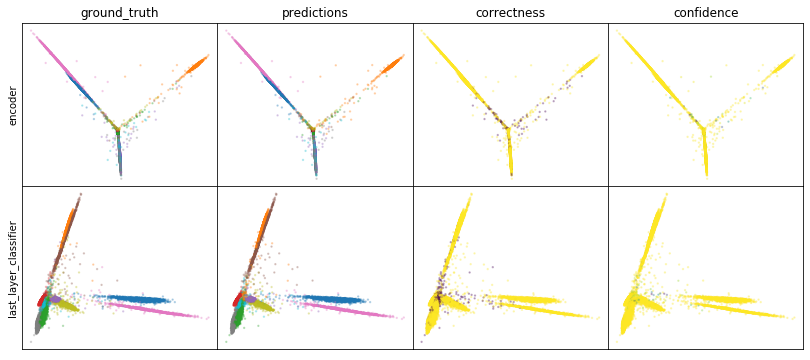

W0808 00:16:54.011471 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:16:54.174399 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:16:54.333693 139838875297536 legend.py:1282] No handles with labels found to put in legend.


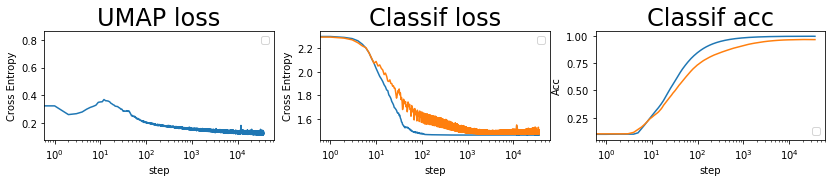

batch: 37000 | train acc: 0.9988 | val acc: 0.9685


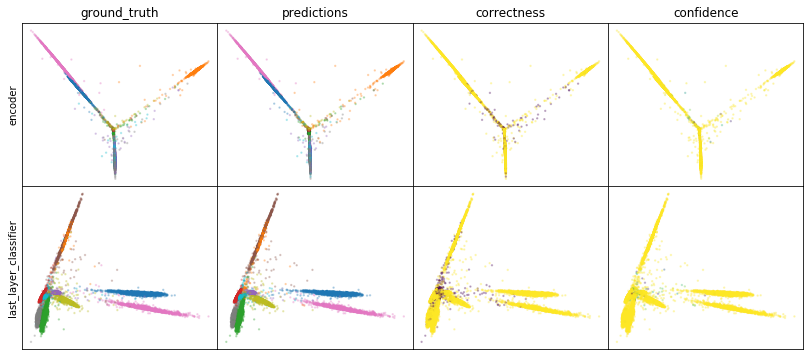

W0808 00:19:14.834104 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:19:15.003485 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:19:15.169848 139838875297536 legend.py:1282] No handles with labels found to put in legend.


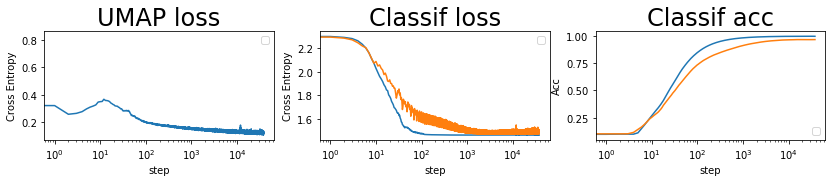

batch: 38000 | train acc: 0.9988 | val acc: 0.9685
leaving epoch because no improvement in 10000 batches


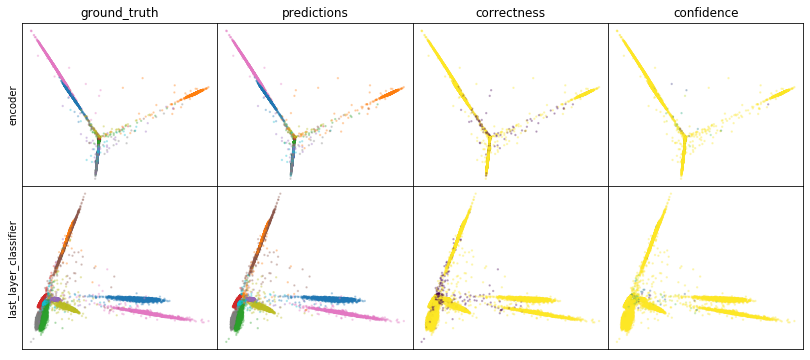

W0808 00:21:20.520047 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:21:20.688013 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:21:20.858428 139838875297536 legend.py:1282] No handles with labels found to put in legend.


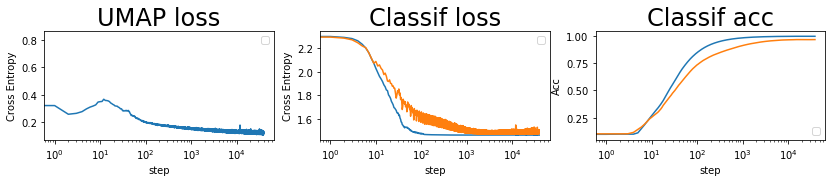

batch: 39000 | train acc: 0.9989 | val acc: 0.9686


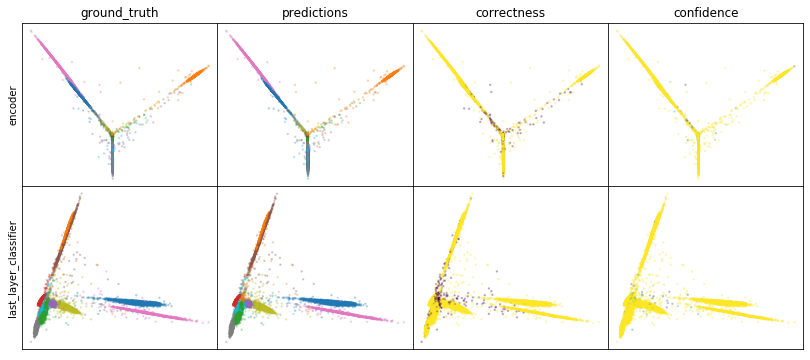

W0808 00:22:58.611531 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:22:58.778764 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:22:58.948469 139838875297536 legend.py:1282] No handles with labels found to put in legend.


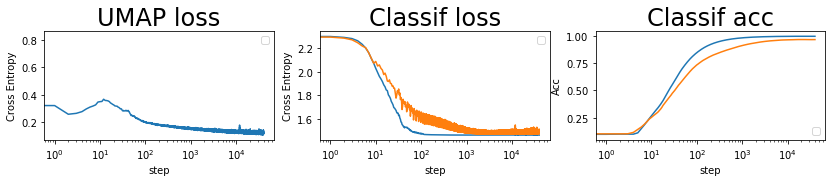

batch: 40000 | train acc: 0.9989 | val acc: 0.9685


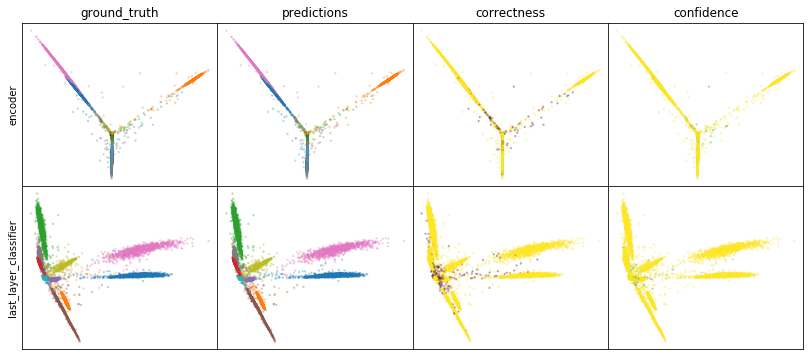

W0808 00:24:52.527581 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:24:52.718610 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:24:52.897354 139838875297536 legend.py:1282] No handles with labels found to put in legend.


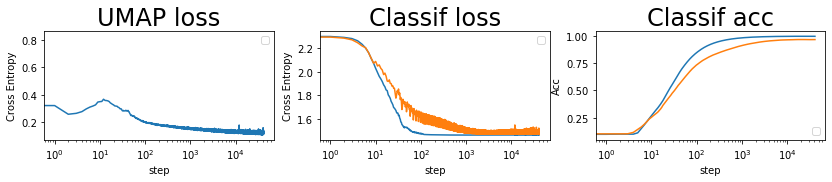

batch: 41000 | train acc: 0.9987 | val acc: 0.9686


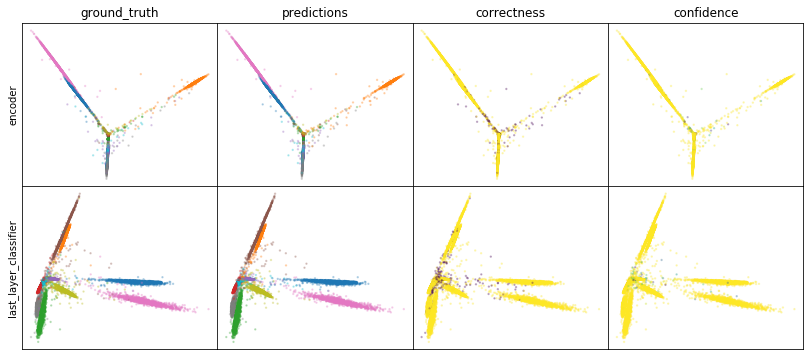

W0808 00:27:26.303625 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:27:26.493824 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:27:26.670730 139838875297536 legend.py:1282] No handles with labels found to put in legend.


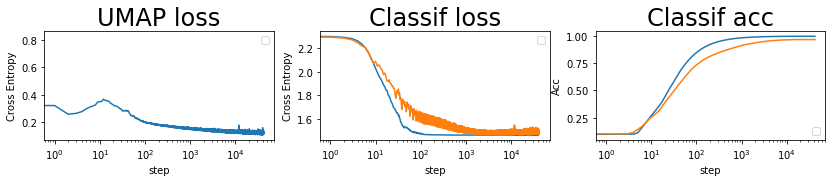

batch: 42000 | train acc: 0.9984 | val acc: 0.9687


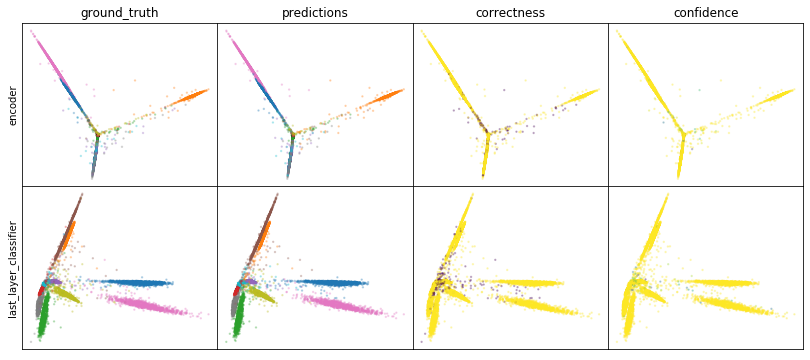

W0808 00:29:06.112885 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:29:06.289882 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:29:06.469145 139838875297536 legend.py:1282] No handles with labels found to put in legend.


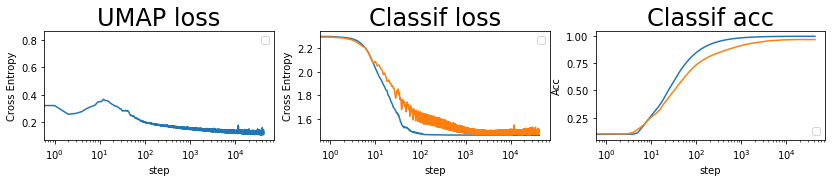

batch: 43000 | train acc: 0.9982 | val acc: 0.9688


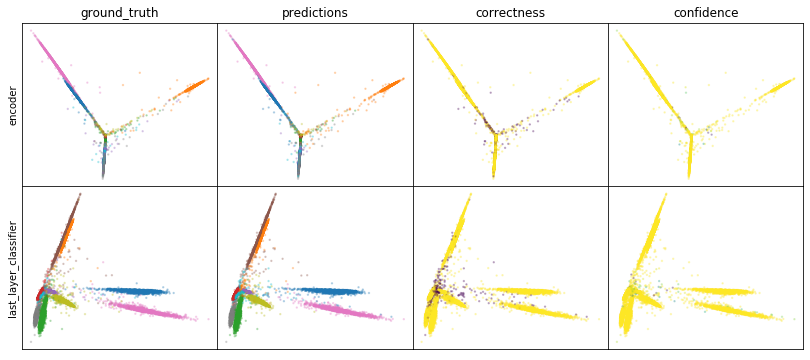

W0808 00:30:47.231252 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:30:47.413195 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:30:47.594314 139838875297536 legend.py:1282] No handles with labels found to put in legend.


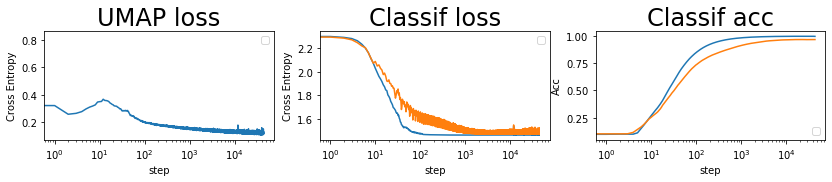

batch: 44000 | train acc: 0.9982 | val acc: 0.9688


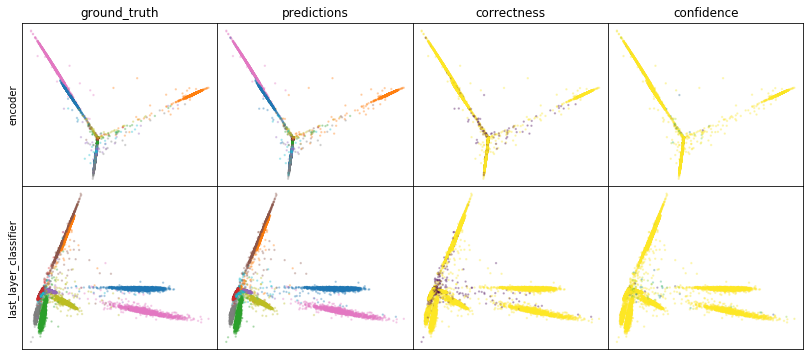

W0808 00:33:10.263952 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:33:10.449230 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:33:10.633360 139838875297536 legend.py:1282] No handles with labels found to put in legend.


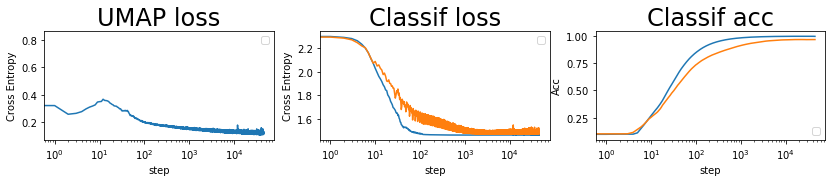

batch: 45000 | train acc: 0.9983 | val acc: 0.9688


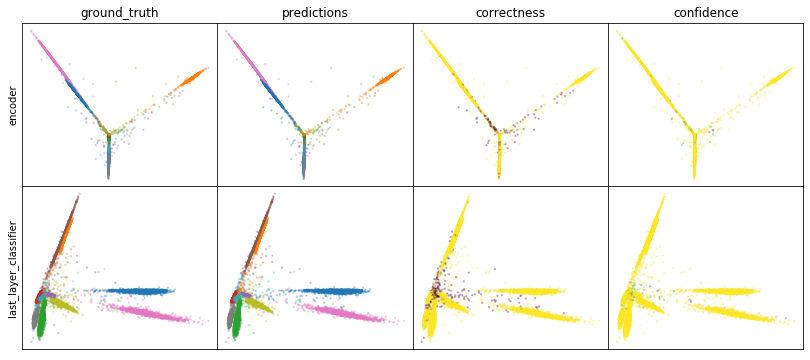

W0808 00:35:19.725529 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:35:19.909434 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:35:20.093340 139838875297536 legend.py:1282] No handles with labels found to put in legend.


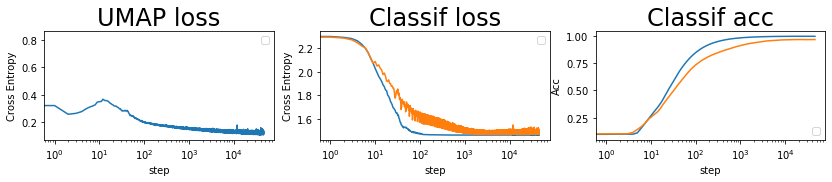

batch: 46000 | train acc: 0.9983 | val acc: 0.9688


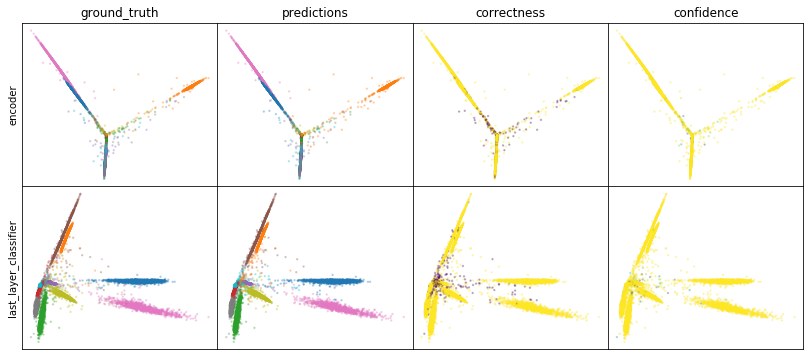

W0808 00:37:01.987000 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:37:02.172664 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:37:02.362187 139838875297536 legend.py:1282] No handles with labels found to put in legend.


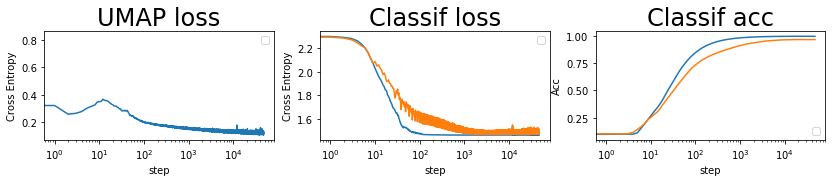

batch: 47000 | train acc: 0.9984 | val acc: 0.9687


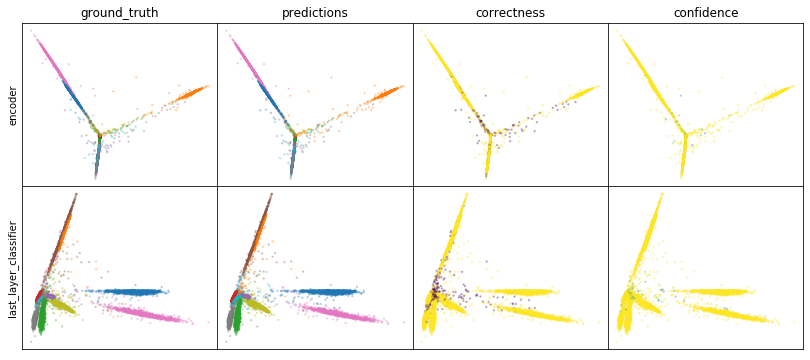

W0808 00:38:58.524120 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:38:58.718052 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:38:58.911481 139838875297536 legend.py:1282] No handles with labels found to put in legend.


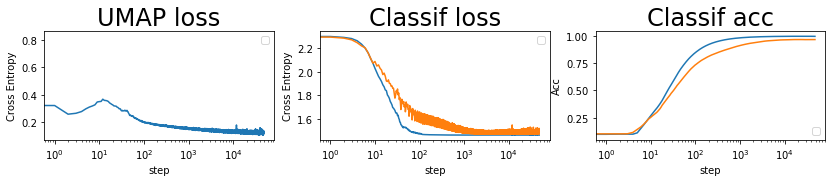

batch: 48000 | train acc: 0.9984 | val acc: 0.9687
leaving epoch because no improvement in 10000 batches


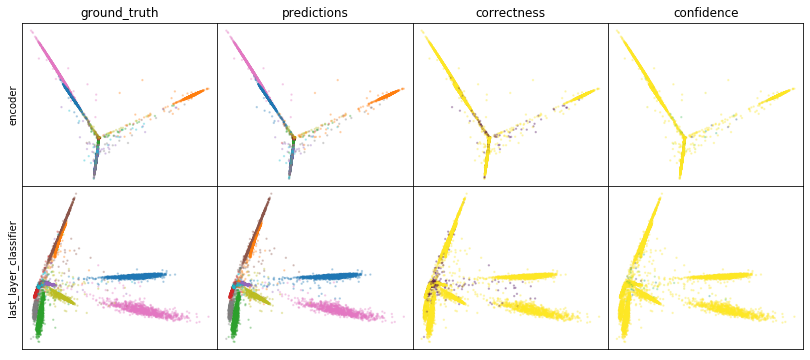

W0808 00:41:31.748759 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:41:31.949348 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:41:32.148186 139838875297536 legend.py:1282] No handles with labels found to put in legend.


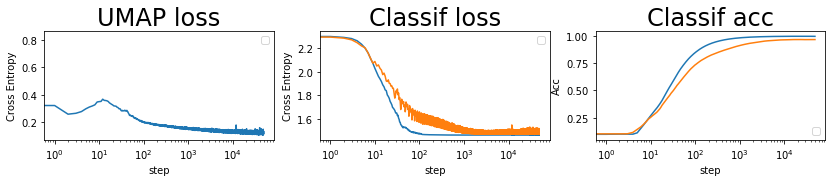

batch: 49000 | train acc: 0.9984 | val acc: 0.9687


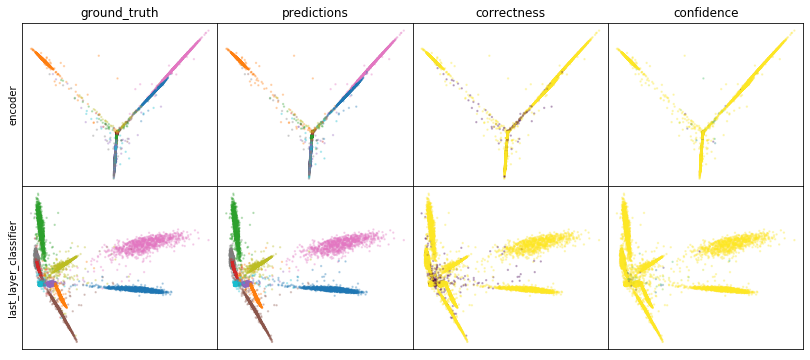

W0808 00:43:15.150839 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:43:15.348164 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:43:15.545455 139838875297536 legend.py:1282] No handles with labels found to put in legend.


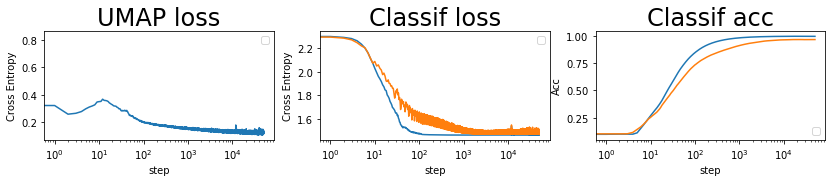

batch: 50000 | train acc: 0.9984 | val acc: 0.9688


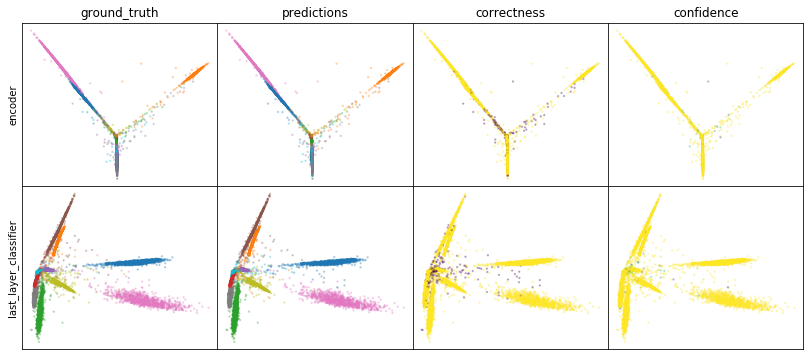

W0808 00:44:59.722715 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:44:59.940962 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:45:00.145449 139838875297536 legend.py:1282] No handles with labels found to put in legend.


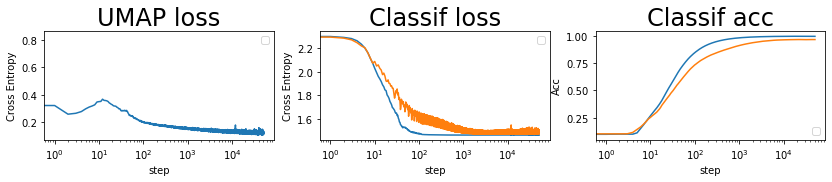

batch: 51000 | train acc: 0.9985 | val acc: 0.9688


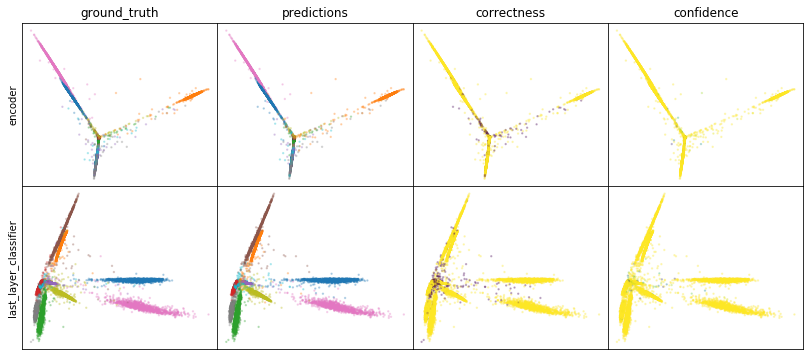

W0808 00:47:13.036771 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:47:13.251877 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:47:13.458594 139838875297536 legend.py:1282] No handles with labels found to put in legend.


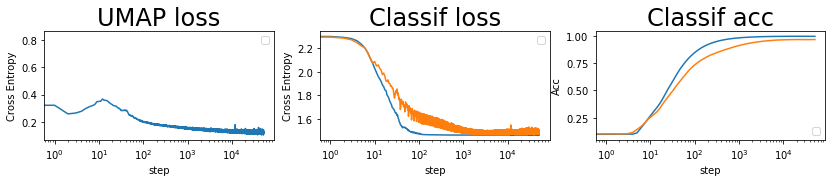

batch: 52000 | train acc: 0.9985 | val acc: 0.9688


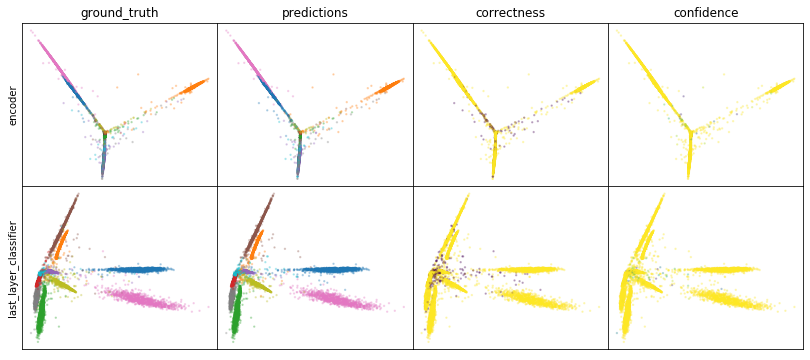

W0808 00:49:16.163193 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:49:16.375719 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:49:16.580824 139838875297536 legend.py:1282] No handles with labels found to put in legend.


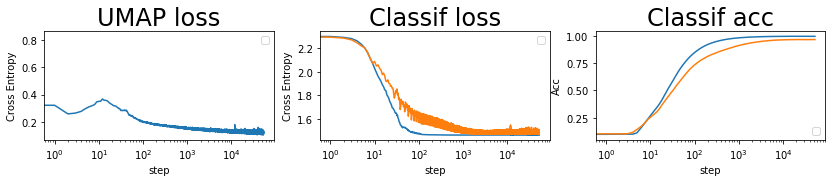

batch: 53000 | train acc: 0.9985 | val acc: 0.9688


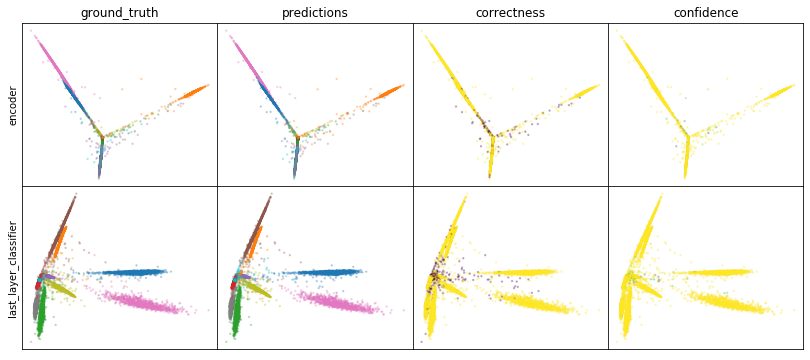

W0808 00:51:01.156226 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:51:01.365800 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:51:01.575124 139838875297536 legend.py:1282] No handles with labels found to put in legend.


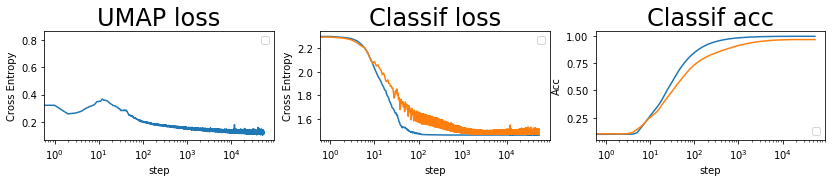

batch: 54000 | train acc: 0.9986 | val acc: 0.9688


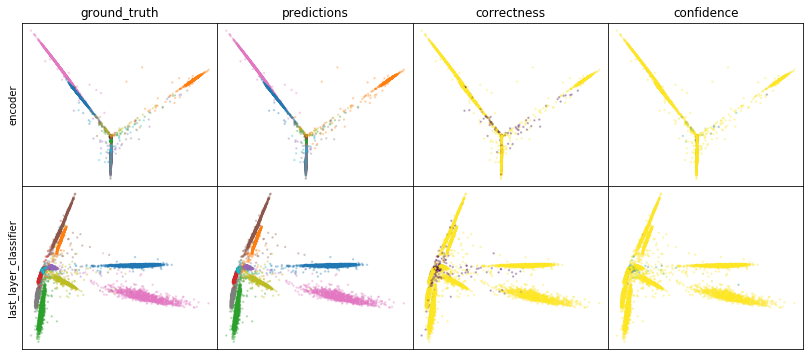

W0808 00:53:18.932770 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:53:19.154037 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:53:19.364508 139838875297536 legend.py:1282] No handles with labels found to put in legend.


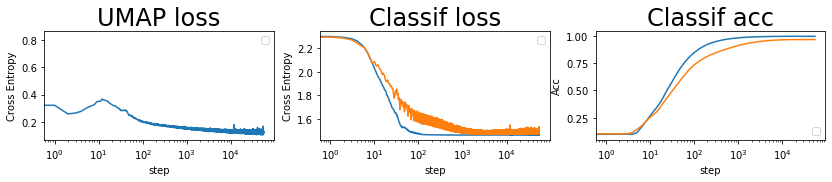

batch: 55000 | train acc: 0.9986 | val acc: 0.9688


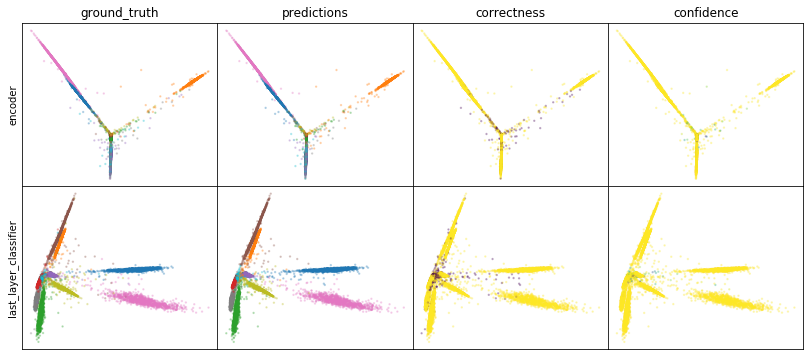

W0808 00:55:36.428954 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:55:36.645512 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:55:36.858411 139838875297536 legend.py:1282] No handles with labels found to put in legend.


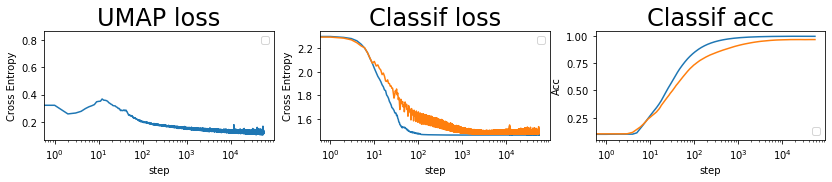

batch: 56000 | train acc: 0.9986 | val acc: 0.9688


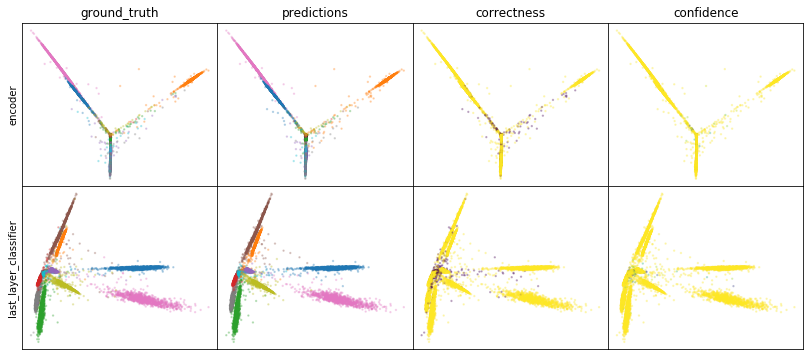

W0808 00:57:23.101440 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:57:23.322655 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:57:23.538137 139838875297536 legend.py:1282] No handles with labels found to put in legend.


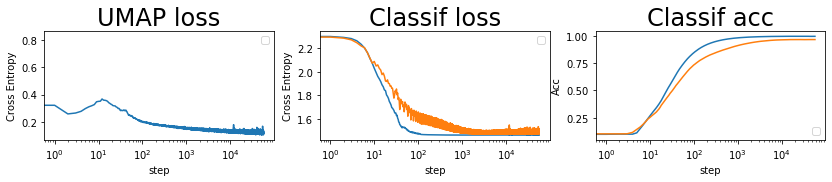

batch: 57000 | train acc: 0.9986 | val acc: 0.9687


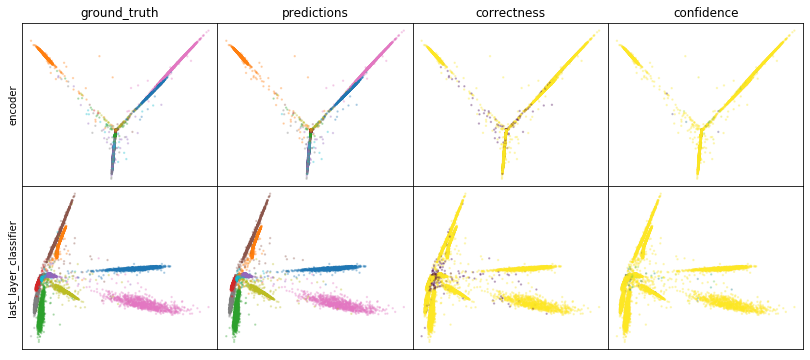

W0808 00:59:28.800757 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:59:29.036722 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 00:59:29.258219 139838875297536 legend.py:1282] No handles with labels found to put in legend.


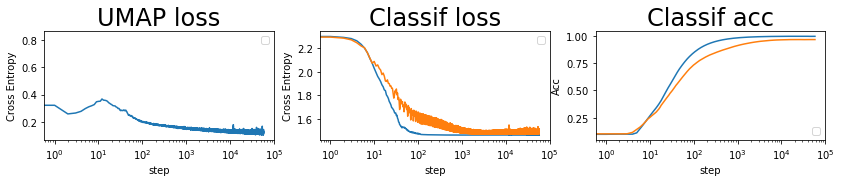

batch: 58000 | train acc: 0.9986 | val acc: 0.9687
leaving epoch because no improvement in 10000 batches


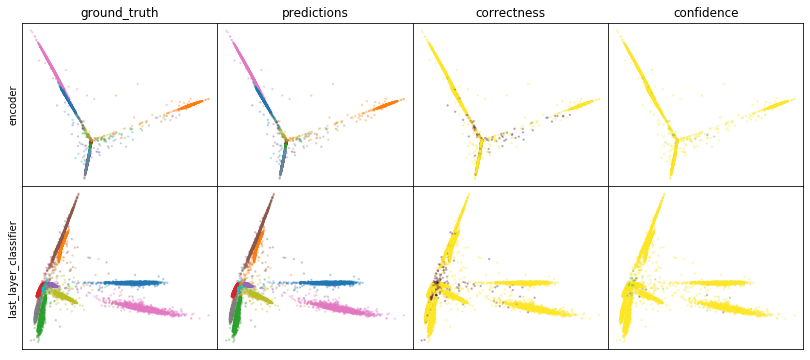

W0808 01:01:48.547550 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:01:48.776456 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:01:49.018194 139838875297536 legend.py:1282] No handles with labels found to put in legend.


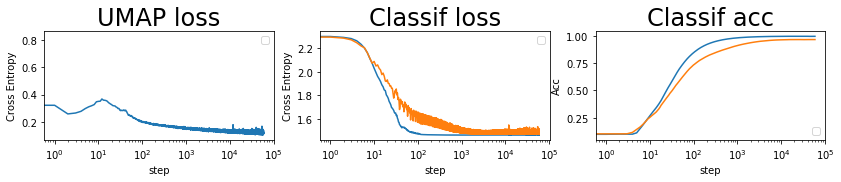

batch: 59000 | train acc: 0.9986 | val acc: 0.9688


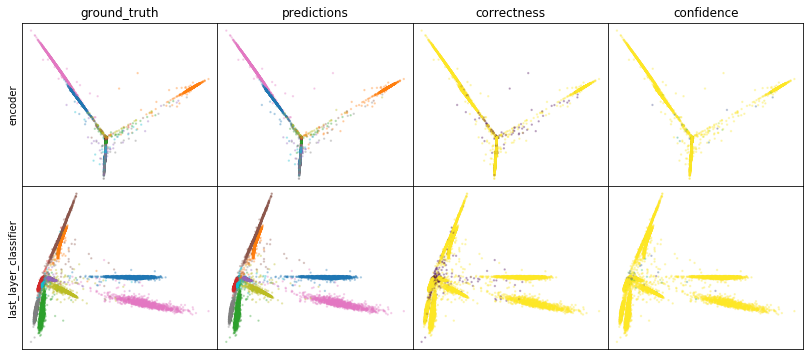

W0808 01:03:35.806536 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:03:36.039376 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:03:36.265884 139838875297536 legend.py:1282] No handles with labels found to put in legend.


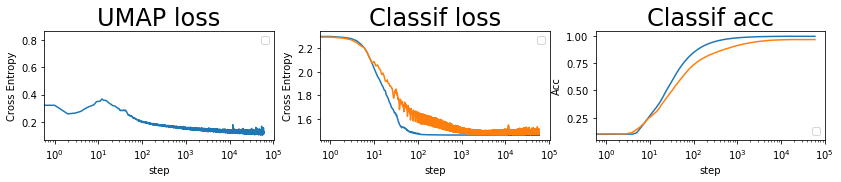

batch: 60000 | train acc: 0.9987 | val acc: 0.9688


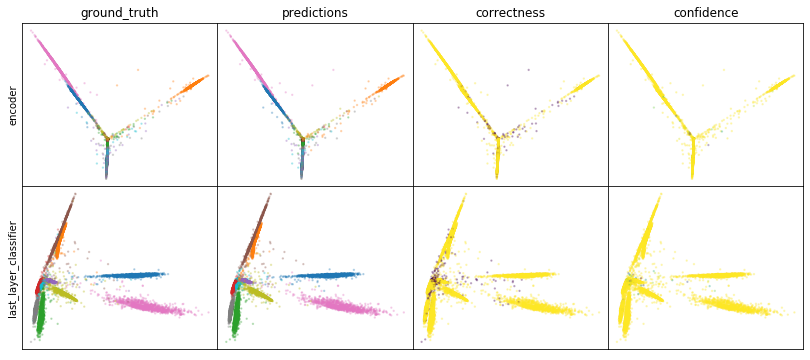

W0808 01:05:23.136135 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:05:23.372138 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:05:23.604026 139838875297536 legend.py:1282] No handles with labels found to put in legend.


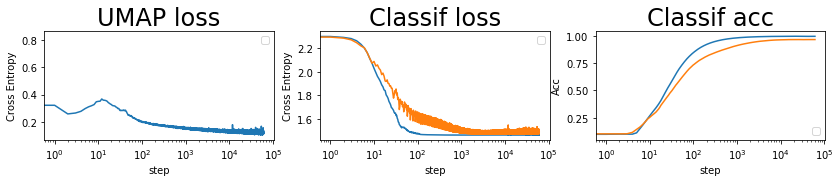

batch: 61000 | train acc: 0.9987 | val acc: 0.9688


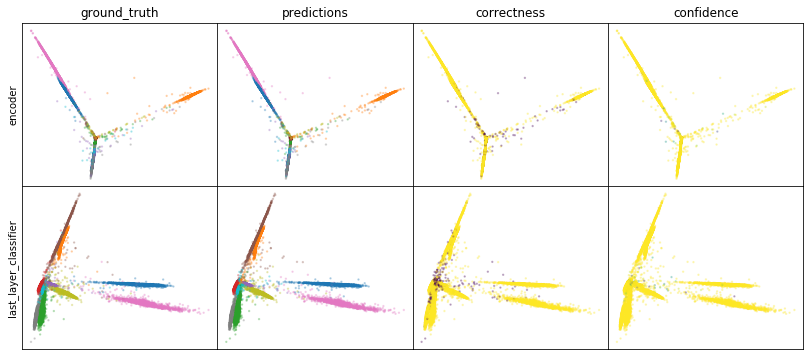

W0808 01:08:12.883483 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:08:13.135030 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:08:13.381311 139838875297536 legend.py:1282] No handles with labels found to put in legend.


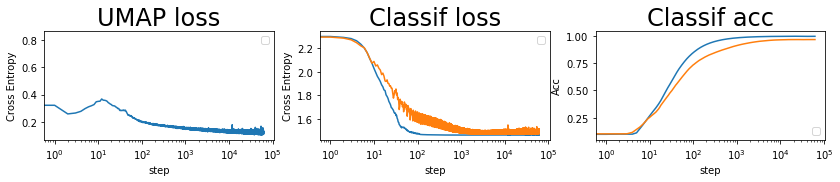

batch: 62000 | train acc: 0.9987 | val acc: 0.9688


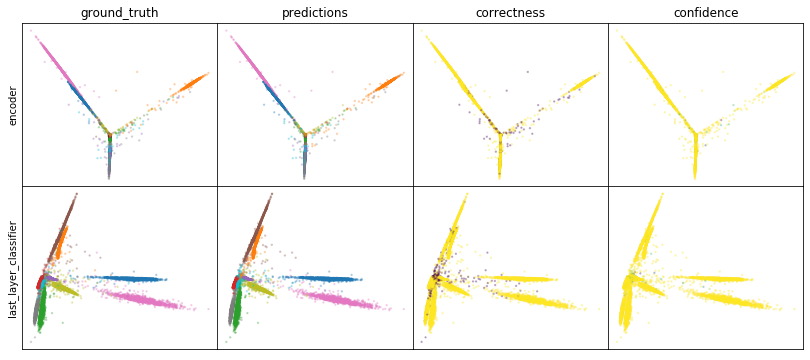

W0808 01:10:03.011841 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:10:03.251122 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:10:03.484670 139838875297536 legend.py:1282] No handles with labels found to put in legend.


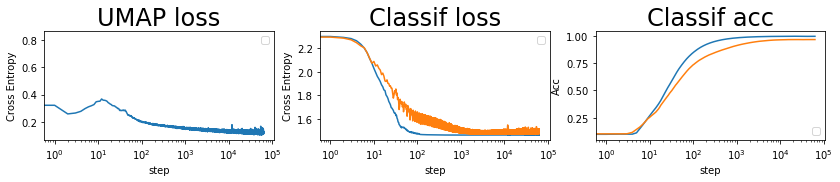

batch: 63000 | train acc: 0.9987 | val acc: 0.9688


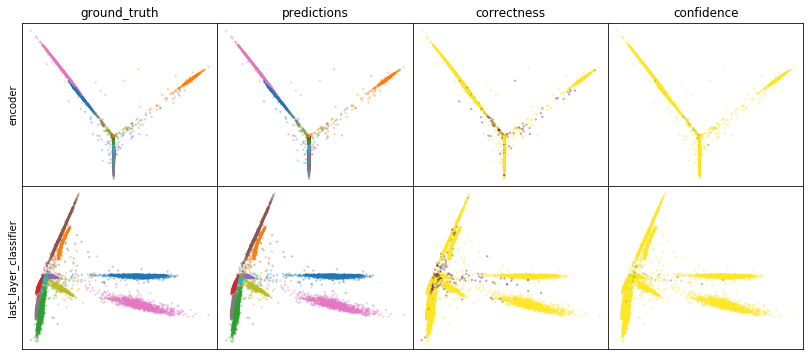

W0808 01:11:52.049691 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:11:52.290182 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:11:52.524151 139838875297536 legend.py:1282] No handles with labels found to put in legend.


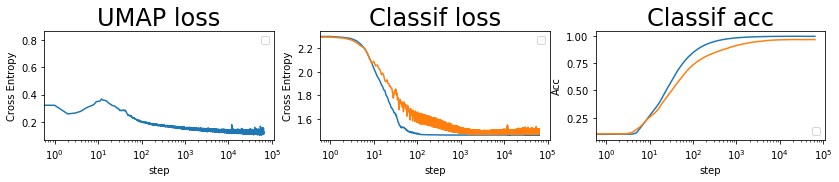

batch: 64000 | train acc: 0.9988 | val acc: 0.9688


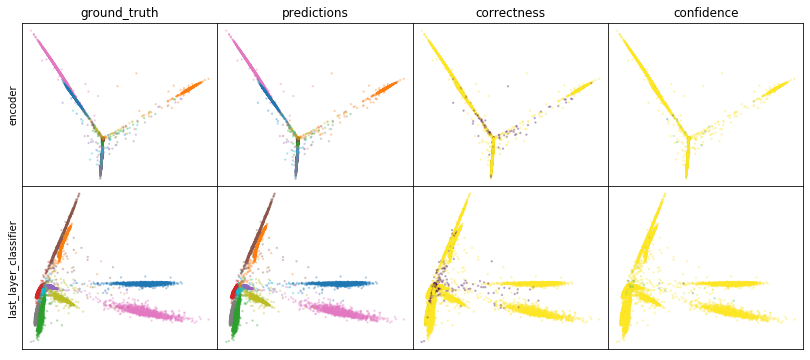

W0808 01:14:23.325465 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:14:23.568238 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:14:23.804120 139838875297536 legend.py:1282] No handles with labels found to put in legend.


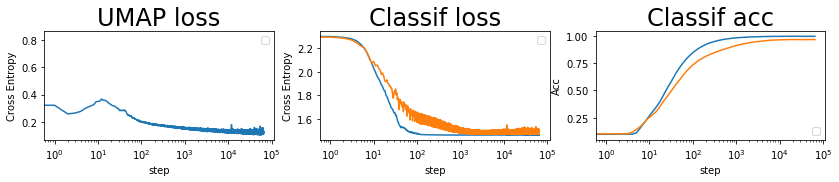

batch: 65000 | train acc: 0.9988 | val acc: 0.9688


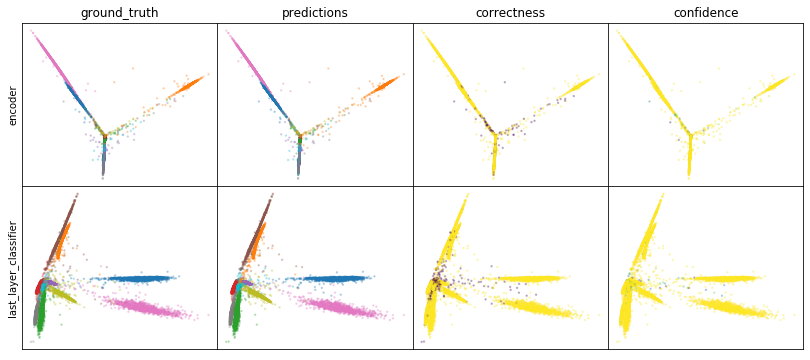

W0808 01:16:48.084347 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:16:48.339523 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:16:48.579841 139838875297536 legend.py:1282] No handles with labels found to put in legend.


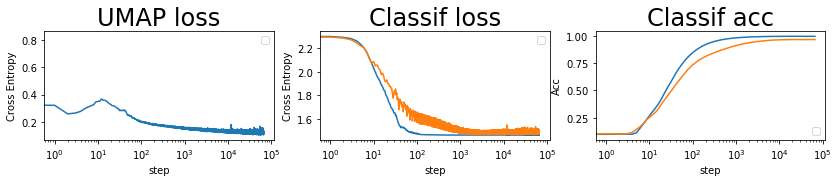

batch: 66000 | train acc: 0.9988 | val acc: 0.9689


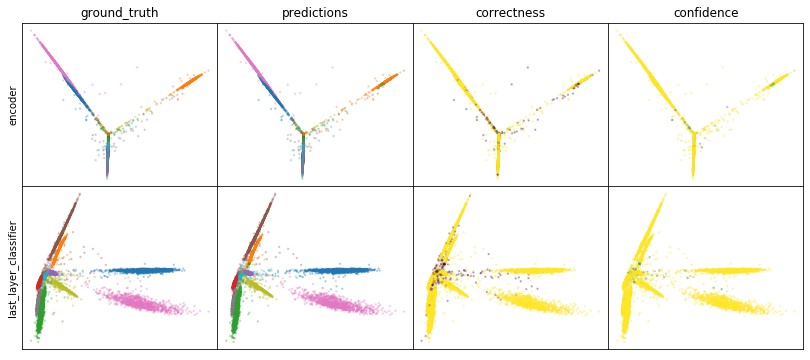

W0808 01:18:39.337140 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:18:39.588948 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:18:39.832422 139838875297536 legend.py:1282] No handles with labels found to put in legend.


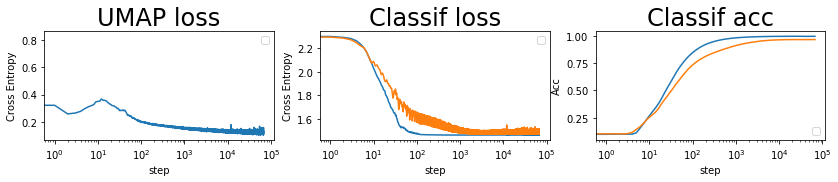

batch: 67000 | train acc: 0.9988 | val acc: 0.9689


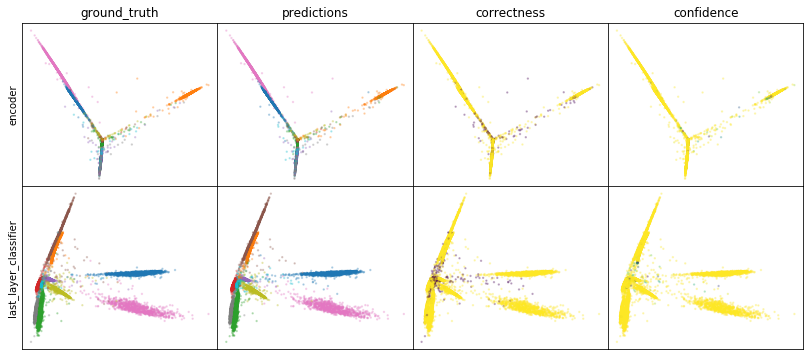

W0808 01:20:54.689610 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:20:54.945080 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:20:55.197462 139838875297536 legend.py:1282] No handles with labels found to put in legend.


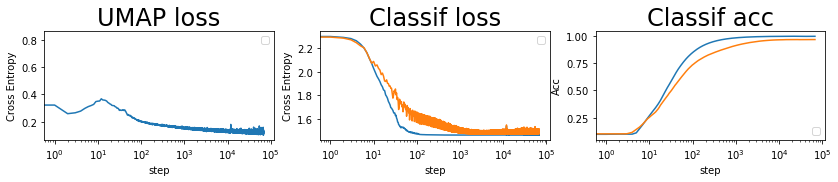

batch: 68000 | train acc: 0.9988 | val acc: 0.9689
leaving epoch because no improvement in 10000 batches


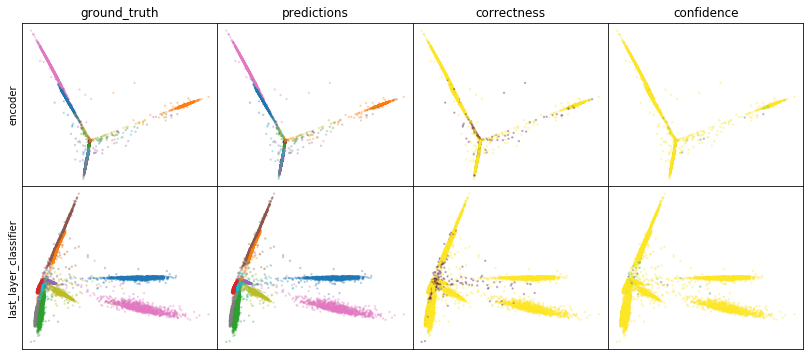

W0808 01:23:22.945016 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:23:23.204193 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:23:23.458819 139838875297536 legend.py:1282] No handles with labels found to put in legend.


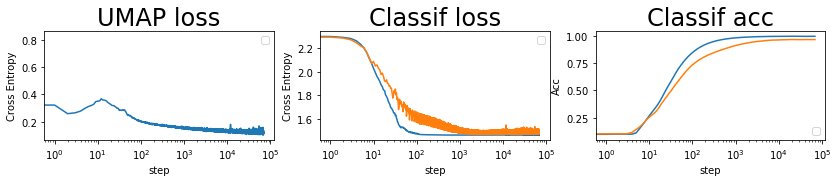

batch: 69000 | train acc: 0.9988 | val acc: 0.9689


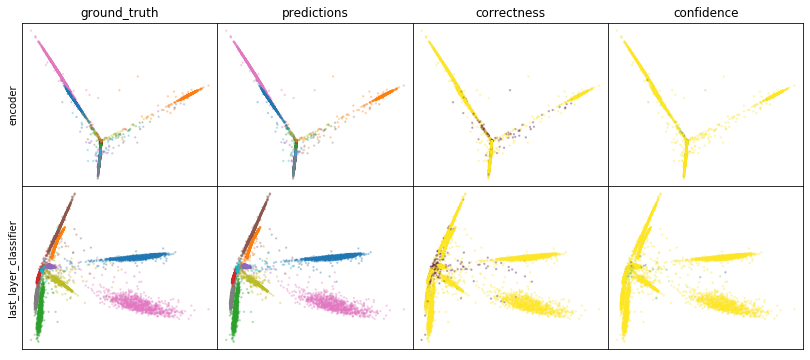

W0808 01:25:15.448860 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:25:15.707306 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:25:15.966140 139838875297536 legend.py:1282] No handles with labels found to put in legend.


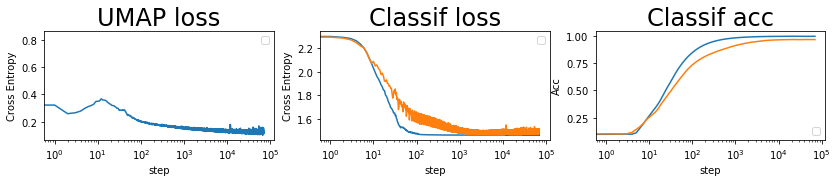

batch: 70000 | train acc: 0.9989 | val acc: 0.9688


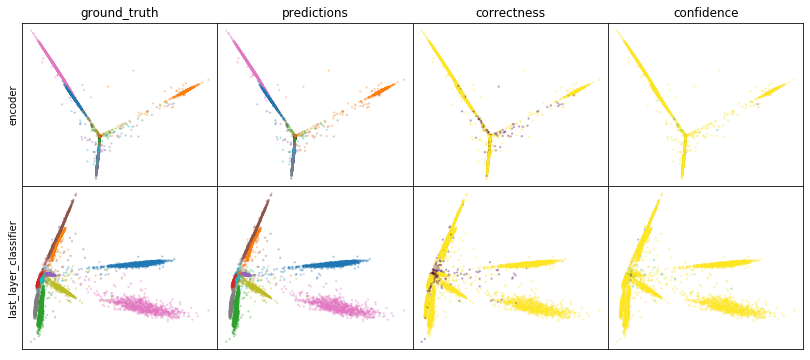

W0808 01:27:30.529258 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:27:30.794733 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:27:31.049042 139838875297536 legend.py:1282] No handles with labels found to put in legend.


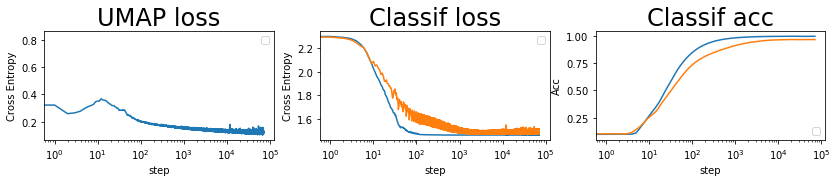

batch: 71000 | train acc: 0.9989 | val acc: 0.9688


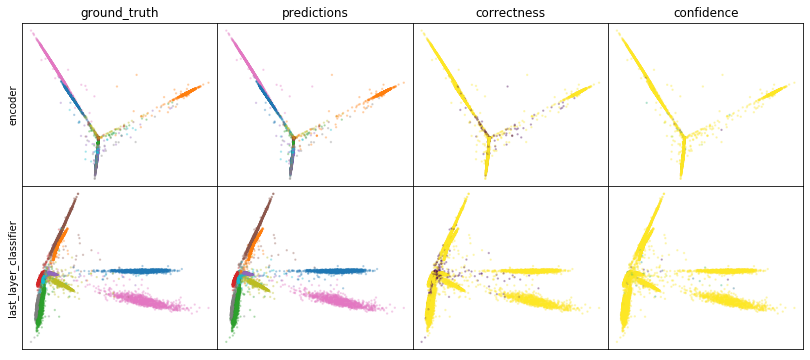

W0808 01:30:12.383152 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:30:12.646226 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:30:12.902088 139838875297536 legend.py:1282] No handles with labels found to put in legend.


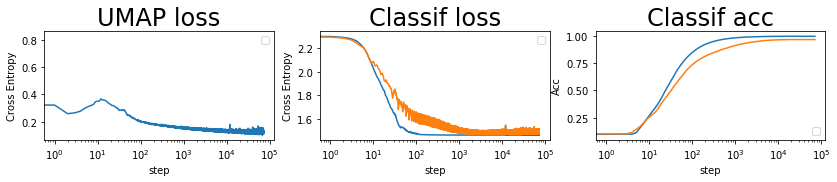

batch: 72000 | train acc: 0.9989 | val acc: 0.9688


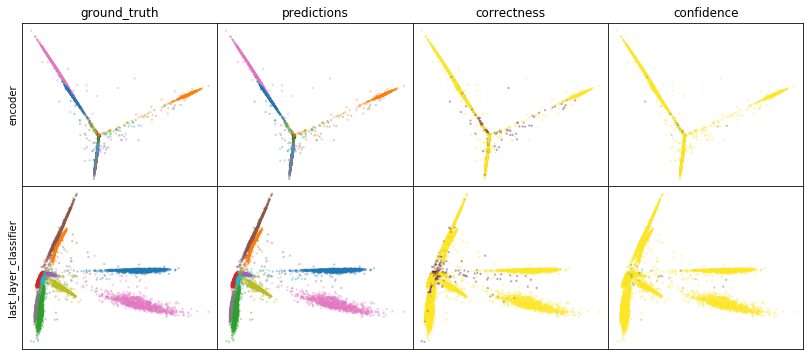

W0808 01:32:06.373464 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:32:06.639213 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:32:06.899642 139838875297536 legend.py:1282] No handles with labels found to put in legend.


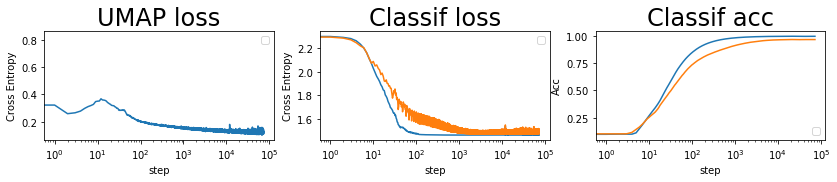

batch: 73000 | train acc: 0.9989 | val acc: 0.9688


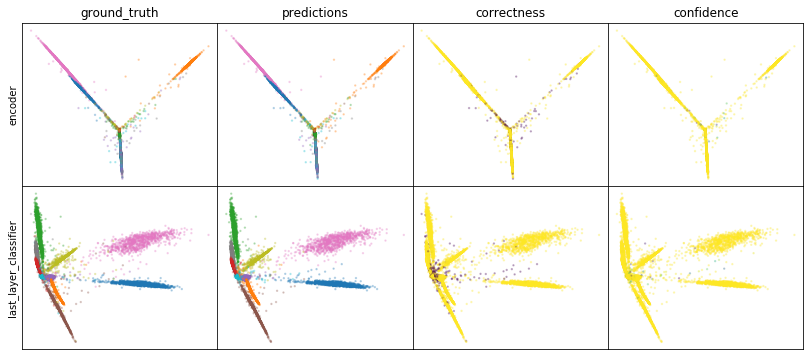

W0808 01:34:00.090202 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:34:00.359138 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:34:00.625211 139838875297536 legend.py:1282] No handles with labels found to put in legend.


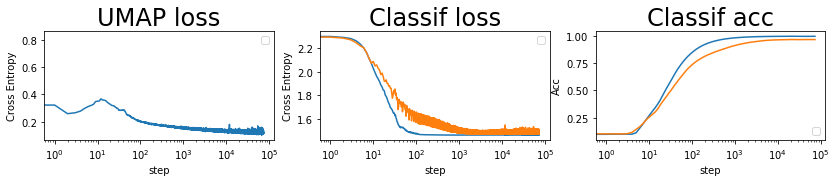

batch: 74000 | train acc: 0.9989 | val acc: 0.9688


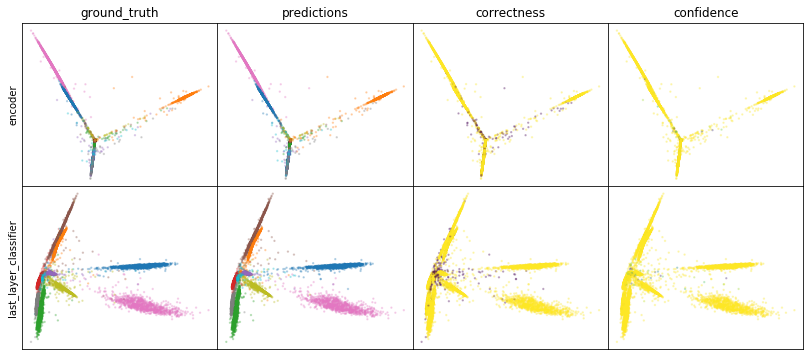

W0808 01:36:52.589857 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:36:52.863134 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:36:53.128266 139838875297536 legend.py:1282] No handles with labels found to put in legend.


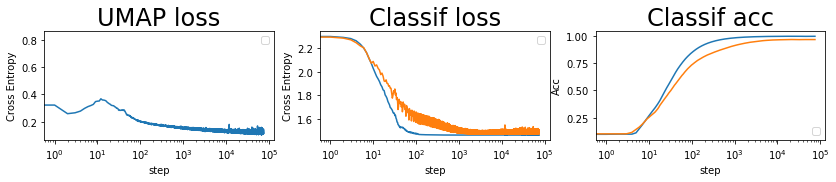

batch: 75000 | train acc: 0.9989 | val acc: 0.9688


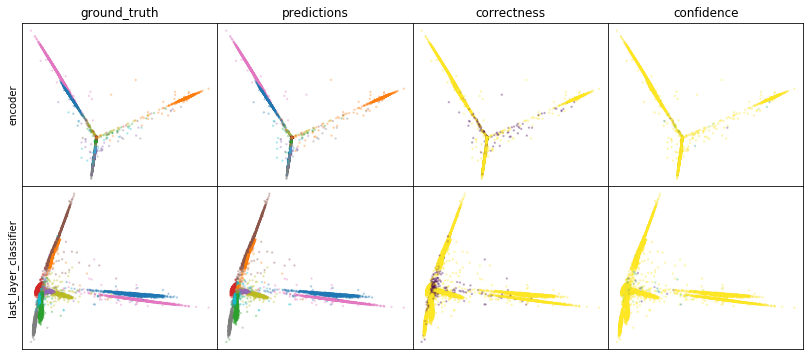

W0808 01:38:48.024517 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:38:48.295570 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:38:48.572897 139838875297536 legend.py:1282] No handles with labels found to put in legend.


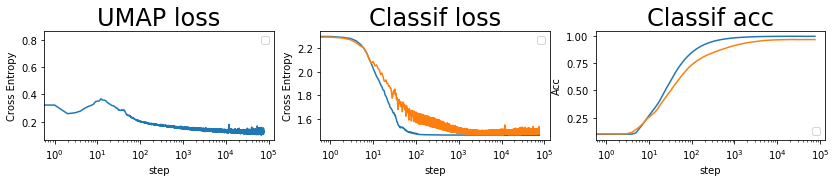

batch: 76000 | train acc: 0.9989 | val acc: 0.9688


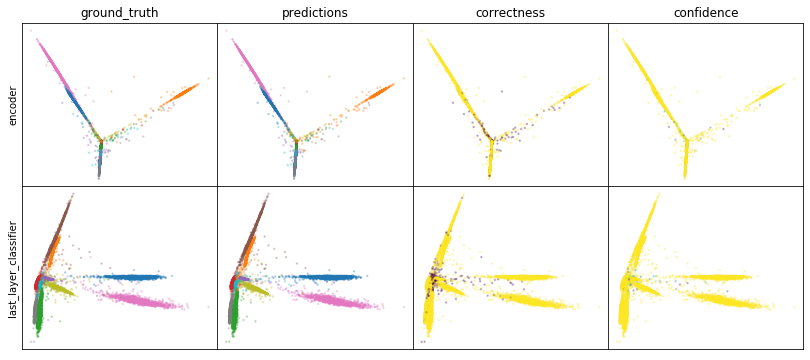

W0808 01:40:44.829162 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:40:45.107491 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:40:45.380143 139838875297536 legend.py:1282] No handles with labels found to put in legend.


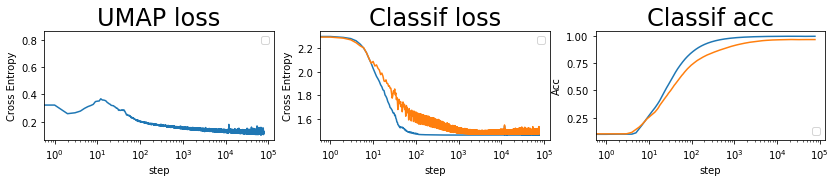

batch: 77000 | train acc: 0.999 | val acc: 0.9688


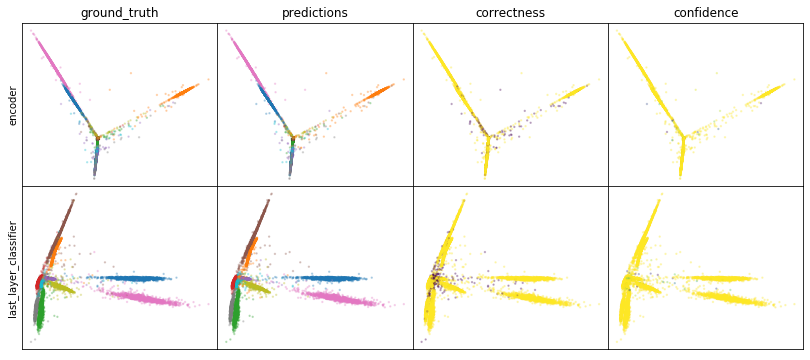

W0808 01:43:12.485983 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:43:12.777257 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:43:13.060628 139838875297536 legend.py:1282] No handles with labels found to put in legend.


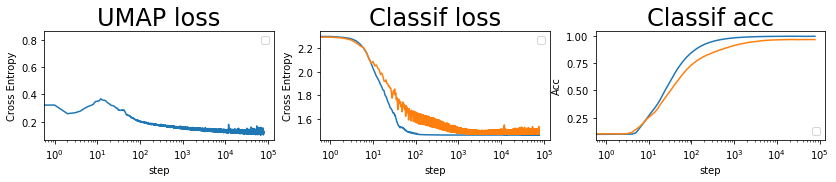

batch: 78000 | train acc: 0.999 | val acc: 0.9688
leaving epoch because no improvement in 10000 batches


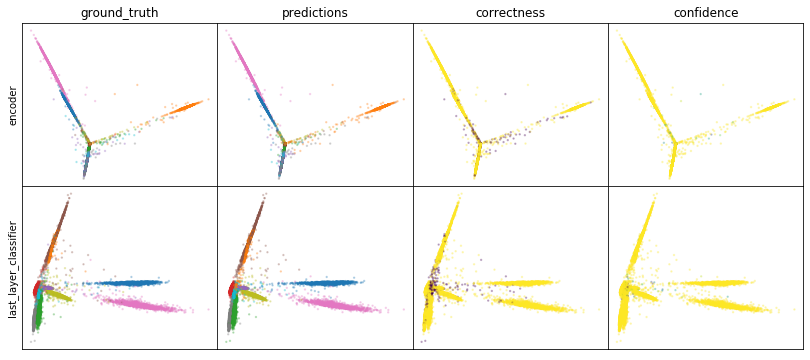

W0808 01:45:09.906965 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:45:10.190936 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:45:10.469481 139838875297536 legend.py:1282] No handles with labels found to put in legend.


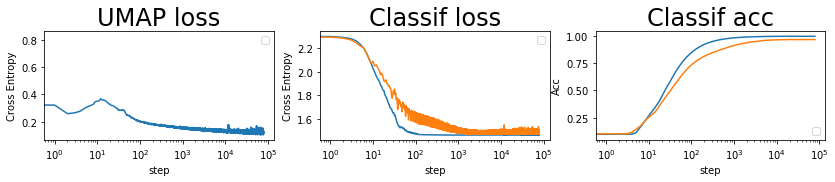

batch: 79000 | train acc: 0.999 | val acc: 0.9688


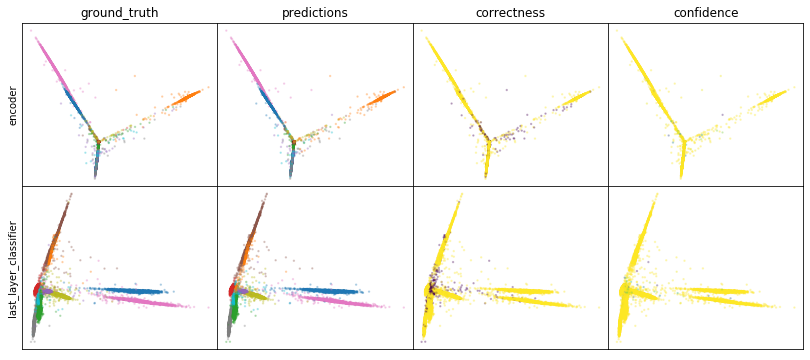

W0808 01:47:07.289623 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:47:07.573632 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:47:07.857888 139838875297536 legend.py:1282] No handles with labels found to put in legend.


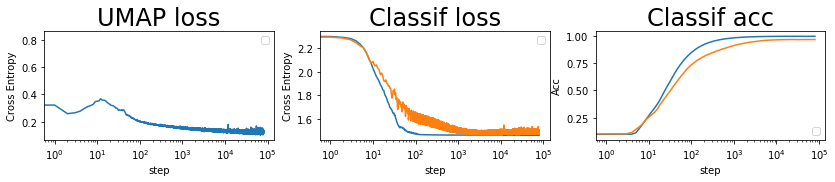

batch: 80000 | train acc: 0.999 | val acc: 0.9688


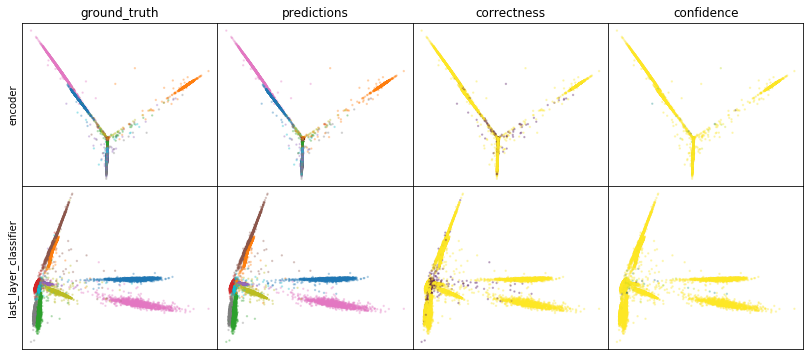

W0808 01:50:04.300981 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:50:04.589749 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:50:04.872017 139838875297536 legend.py:1282] No handles with labels found to put in legend.


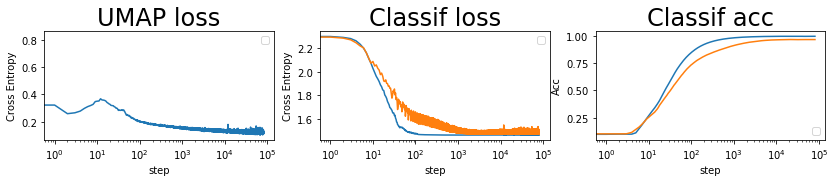

batch: 81000 | train acc: 0.999 | val acc: 0.9687


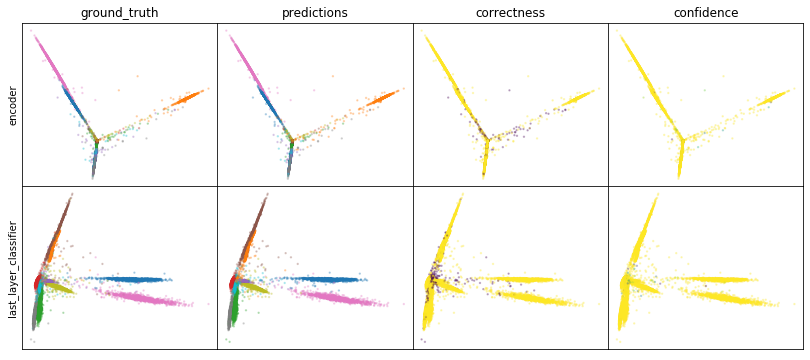

W0808 01:52:02.647667 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:52:02.955384 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:52:03.243463 139838875297536 legend.py:1282] No handles with labels found to put in legend.


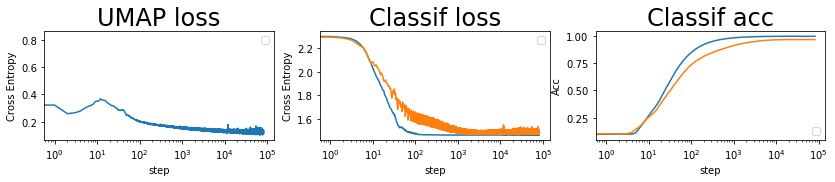

batch: 82000 | train acc: 0.999 | val acc: 0.9687


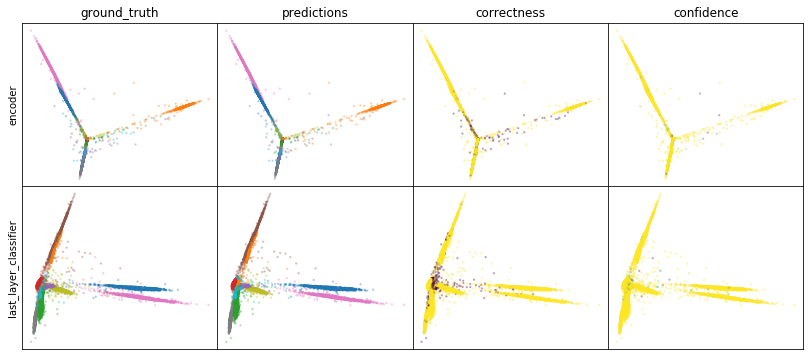

W0808 01:54:01.145066 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:54:01.438644 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:54:01.729105 139838875297536 legend.py:1282] No handles with labels found to put in legend.


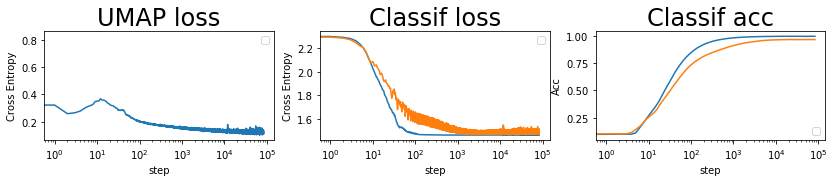

batch: 83000 | train acc: 0.999 | val acc: 0.9687


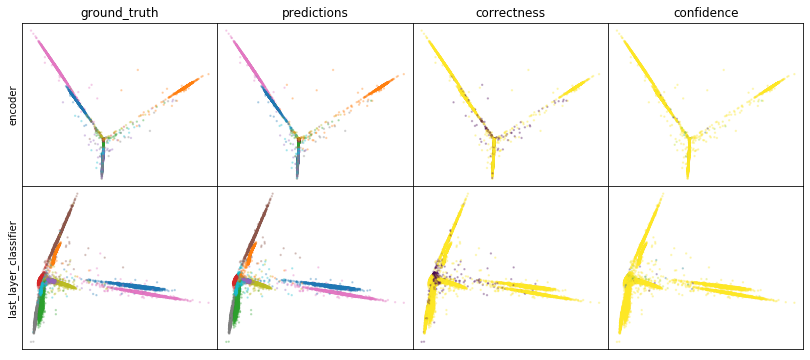

W0808 01:56:30.812614 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:56:31.112261 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:56:31.412696 139838875297536 legend.py:1282] No handles with labels found to put in legend.


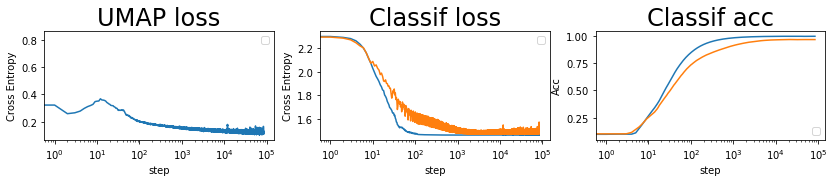

batch: 84000 | train acc: 0.999 | val acc: 0.9687


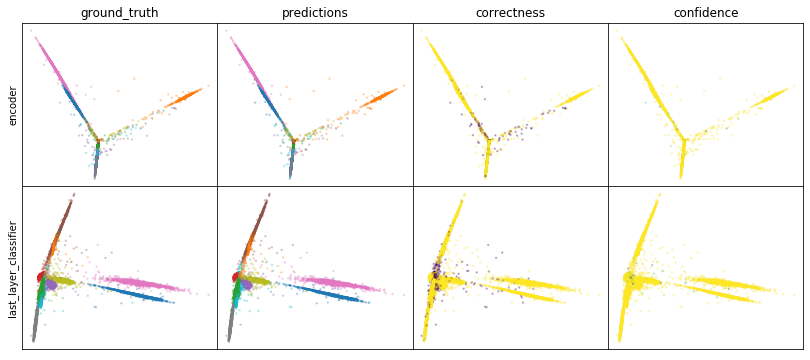

W0808 01:58:35.680255 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:58:35.980963 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 01:58:36.272780 139838875297536 legend.py:1282] No handles with labels found to put in legend.


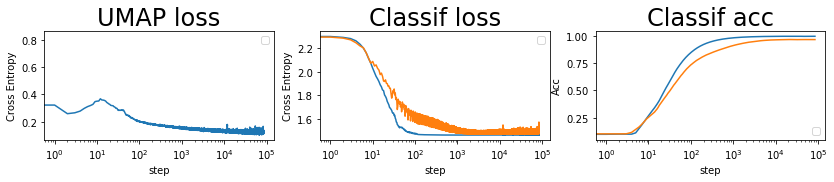

batch: 85000 | train acc: 0.9991 | val acc: 0.9686


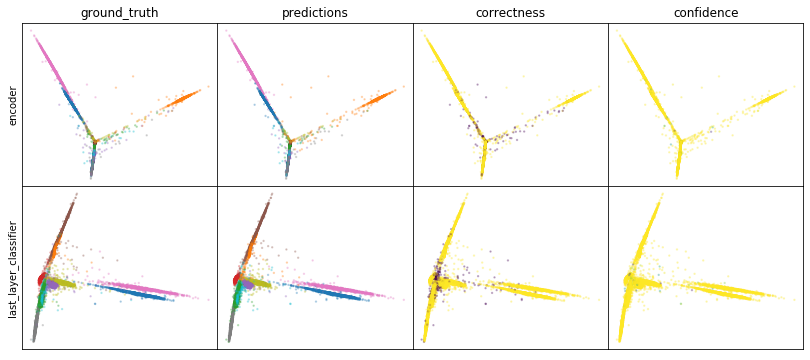

W0808 02:00:36.352480 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:00:36.657474 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:00:36.951594 139838875297536 legend.py:1282] No handles with labels found to put in legend.


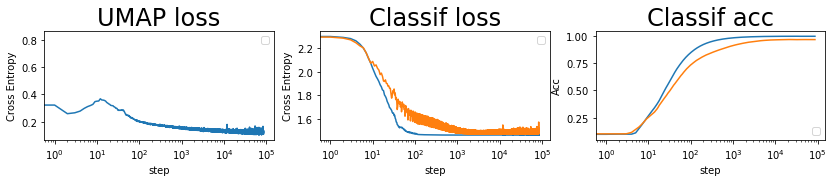

batch: 86000 | train acc: 0.9991 | val acc: 0.9685


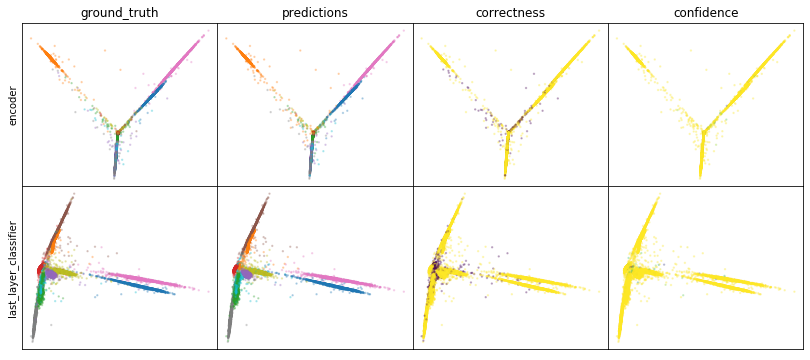

W0808 02:03:35.457002 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:03:35.762816 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:03:36.059451 139838875297536 legend.py:1282] No handles with labels found to put in legend.


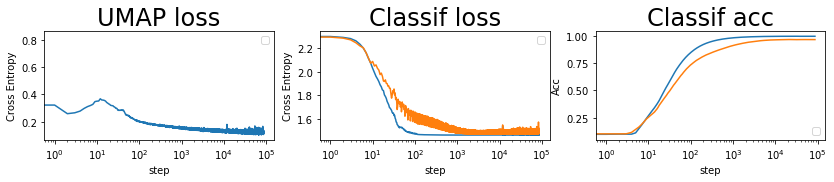

batch: 87000 | train acc: 0.9991 | val acc: 0.9685


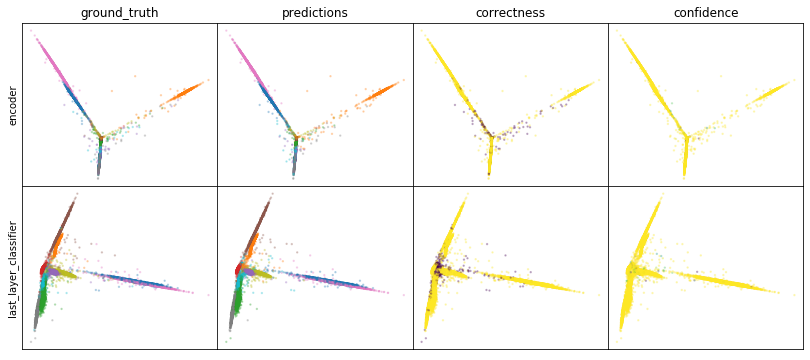

W0808 02:05:35.946210 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:05:36.251205 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:05:36.552522 139838875297536 legend.py:1282] No handles with labels found to put in legend.


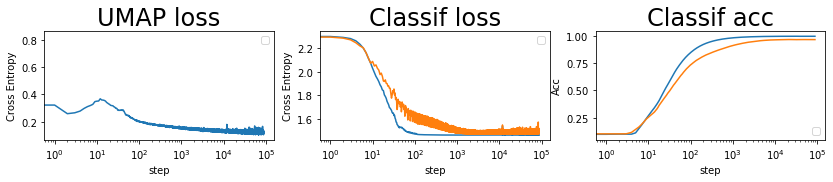

batch: 88000 | train acc: 0.9991 | val acc: 0.9684
leaving epoch because no improvement in 10000 batches


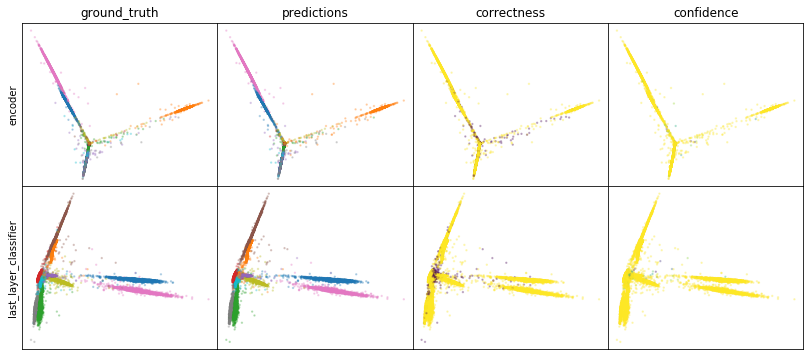

W0808 02:07:38.555215 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:07:38.880917 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:07:39.202505 139838875297536 legend.py:1282] No handles with labels found to put in legend.


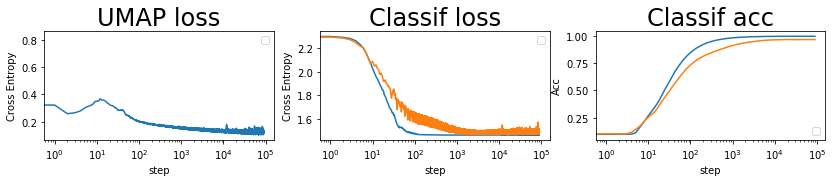

batch: 89000 | train acc: 0.9991 | val acc: 0.9684


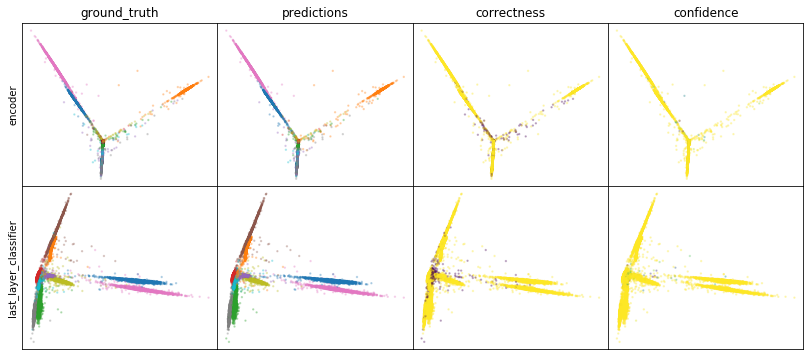

W0808 02:10:10.023503 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:10:10.342460 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:10:10.651829 139838875297536 legend.py:1282] No handles with labels found to put in legend.


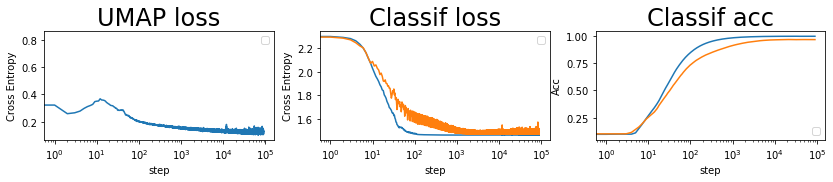

batch: 90000 | train acc: 0.9991 | val acc: 0.9684


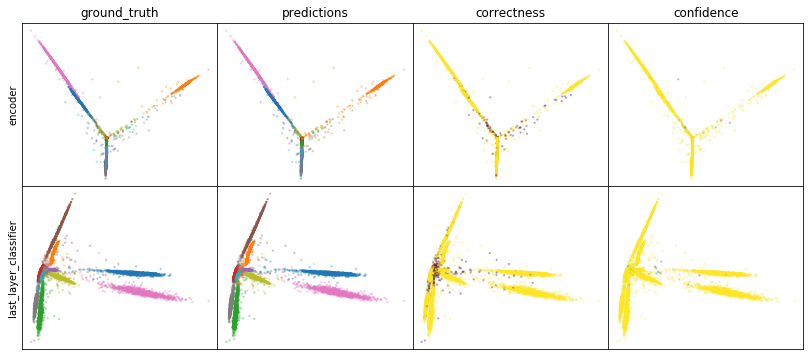

W0808 02:12:17.963202 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:12:18.295263 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:12:18.594038 139838875297536 legend.py:1282] No handles with labels found to put in legend.


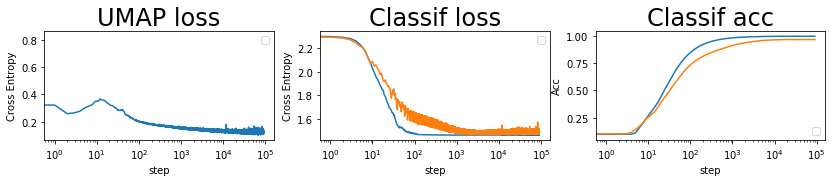

batch: 91000 | train acc: 0.9991 | val acc: 0.9684


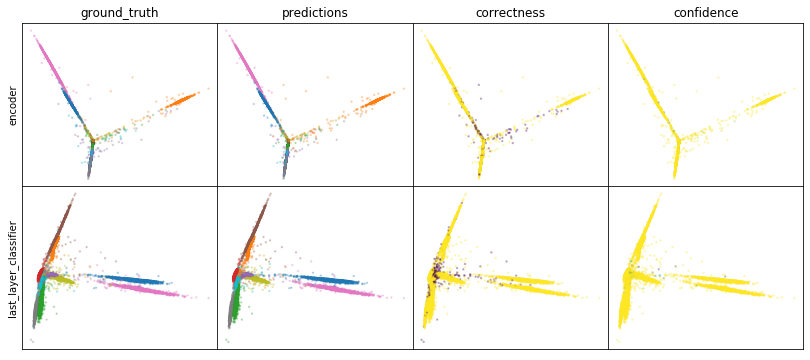

W0808 02:14:21.983333 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:14:22.332747 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:14:22.671661 139838875297536 legend.py:1282] No handles with labels found to put in legend.


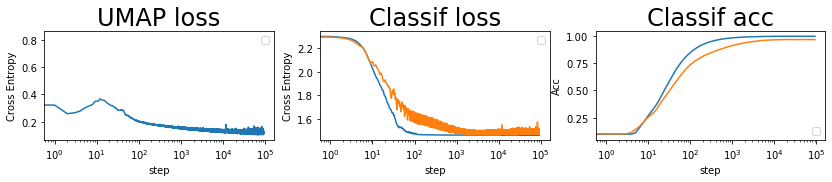

batch: 92000 | train acc: 0.9991 | val acc: 0.9684


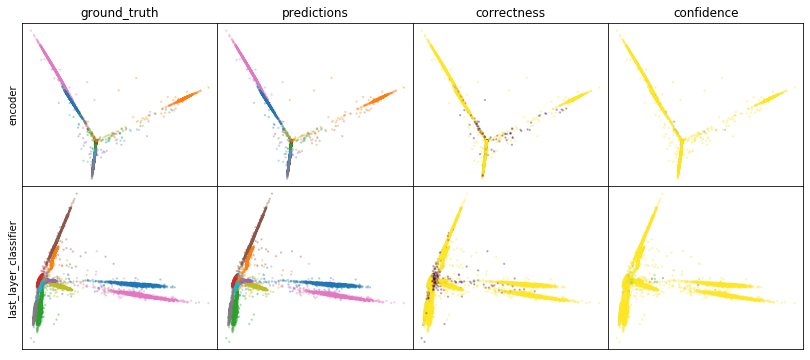

W0808 02:17:25.582935 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:17:25.912814 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:17:26.228536 139838875297536 legend.py:1282] No handles with labels found to put in legend.


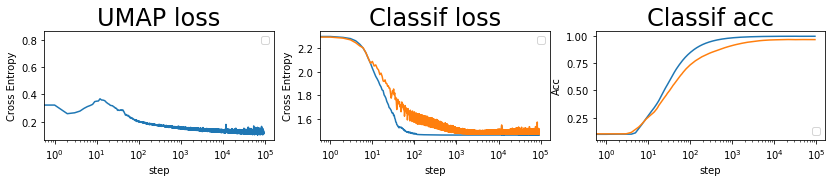

batch: 93000 | train acc: 0.9991 | val acc: 0.9684


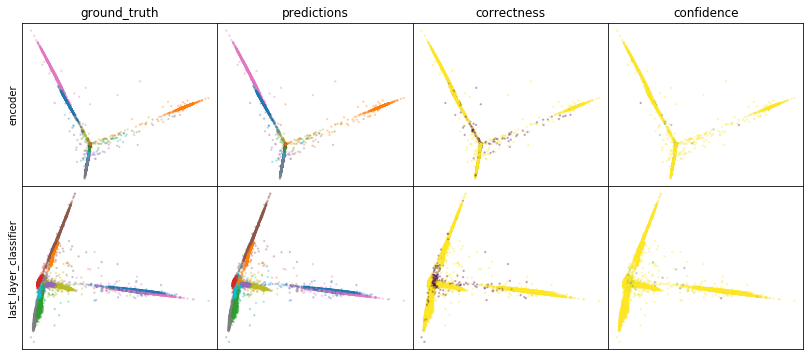

W0808 02:19:27.293950 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:19:27.628960 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:19:27.949834 139838875297536 legend.py:1282] No handles with labels found to put in legend.


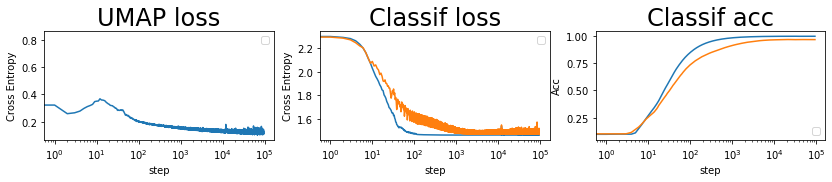

batch: 94000 | train acc: 0.9991 | val acc: 0.9684


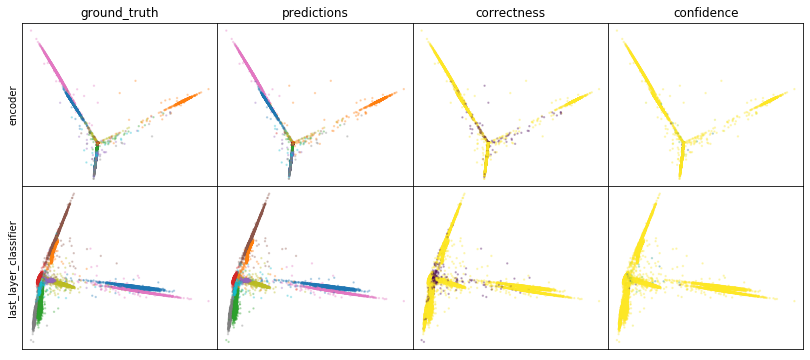

W0808 02:21:31.615964 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:21:31.947411 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:21:32.263025 139838875297536 legend.py:1282] No handles with labels found to put in legend.


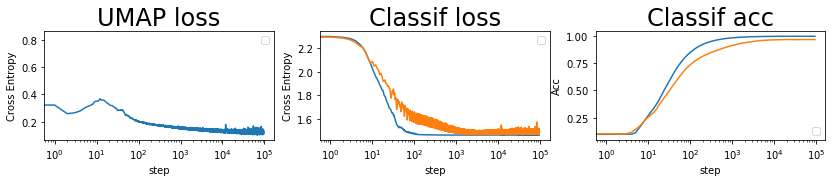

batch: 95000 | train acc: 0.9992 | val acc: 0.9684


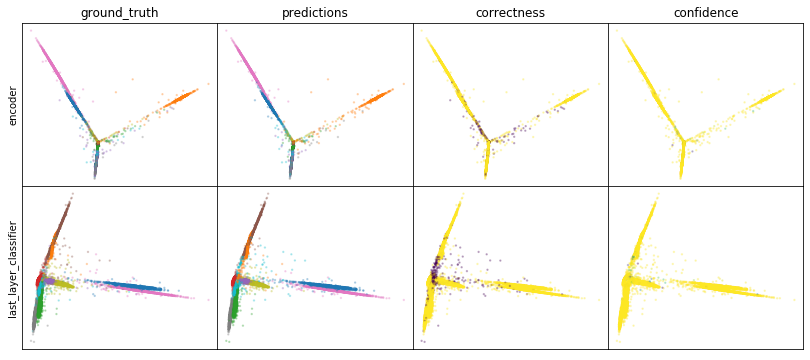

W0808 02:24:16.899390 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:24:17.226133 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:24:17.540137 139838875297536 legend.py:1282] No handles with labels found to put in legend.


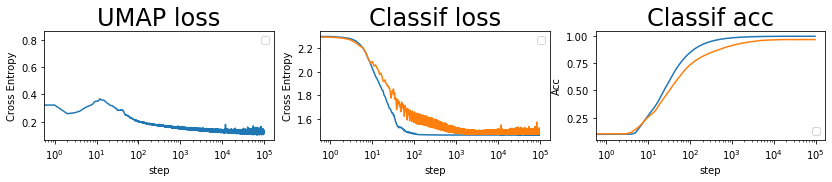

batch: 96000 | train acc: 0.9992 | val acc: 0.9683


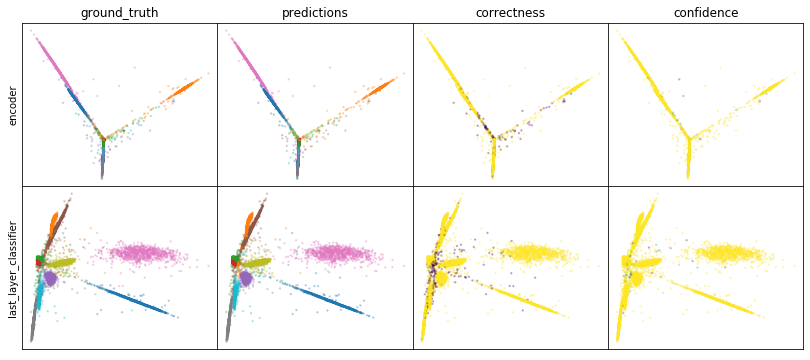

W0808 02:26:22.088071 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:26:22.434720 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:26:22.818375 139838875297536 legend.py:1282] No handles with labels found to put in legend.


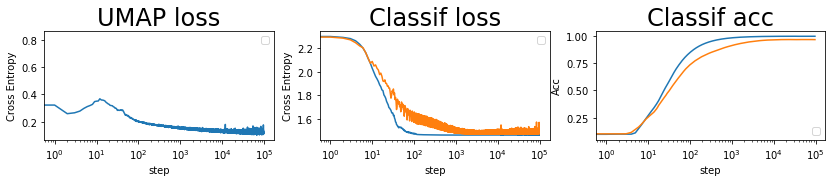

batch: 97000 | train acc: 0.9992 | val acc: 0.9683


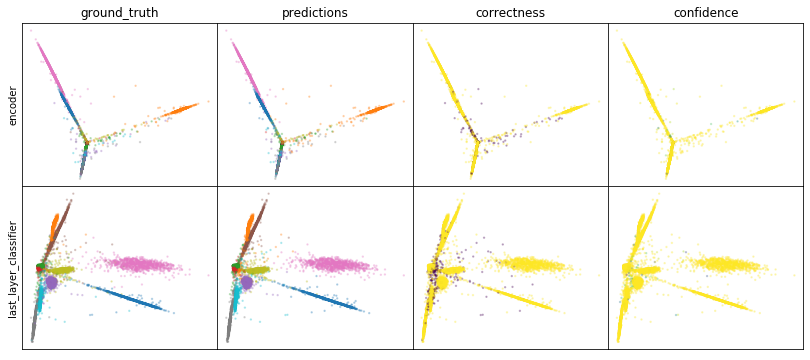

W0808 02:28:25.599390 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:28:25.951634 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:28:26.274370 139838875297536 legend.py:1282] No handles with labels found to put in legend.


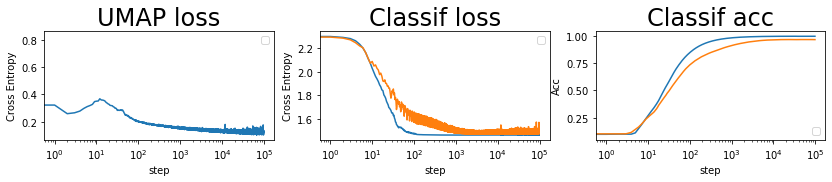

batch: 98000 | train acc: 0.9992 | val acc: 0.9683
leaving epoch because no improvement in 10000 batches


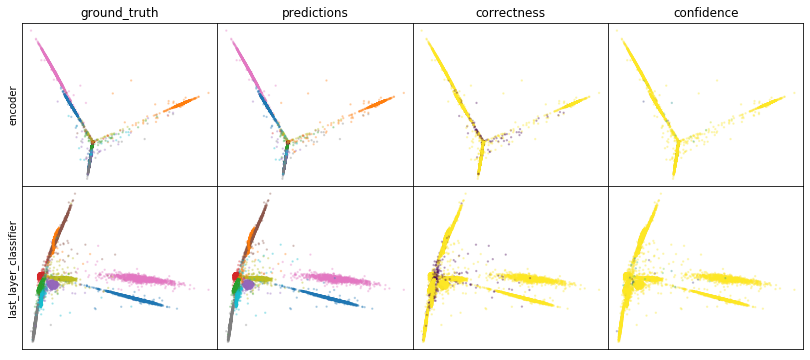

W0808 02:31:31.792604 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:31:32.125676 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:31:32.450888 139838875297536 legend.py:1282] No handles with labels found to put in legend.


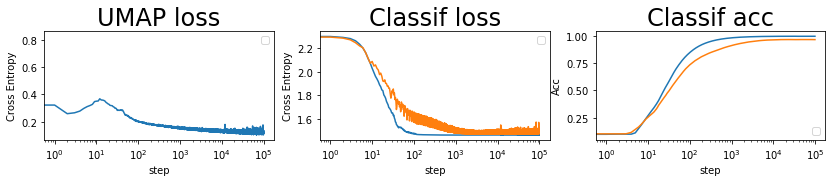

batch: 99000 | train acc: 0.9992 | val acc: 0.9683


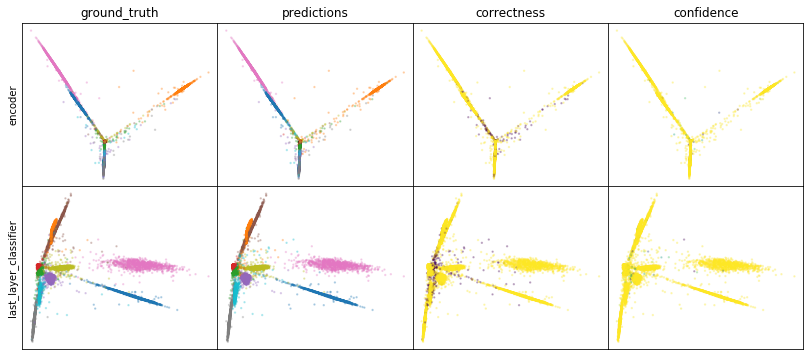

W0808 02:33:38.019717 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:33:38.359846 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:33:38.685620 139838875297536 legend.py:1282] No handles with labels found to put in legend.


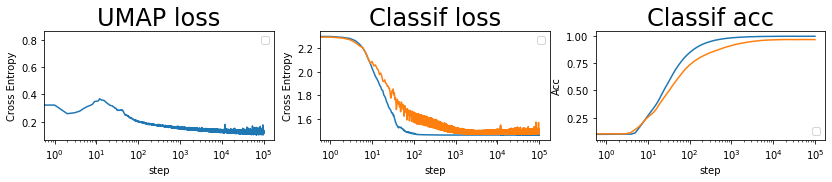

batch: 100000 | train acc: 0.9992 | val acc: 0.9683


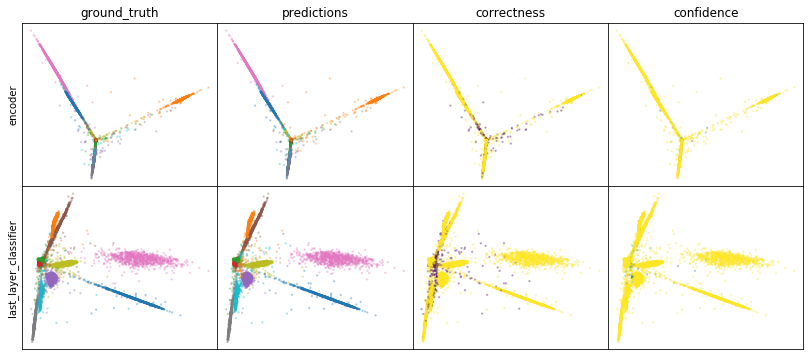

W0808 02:35:50.026857 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:35:50.382628 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:35:50.738279 139838875297536 legend.py:1282] No handles with labels found to put in legend.


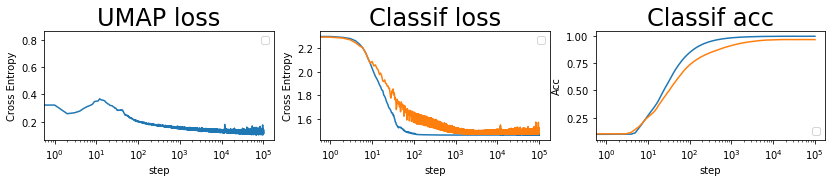

batch: 101000 | train acc: 0.9992 | val acc: 0.9682


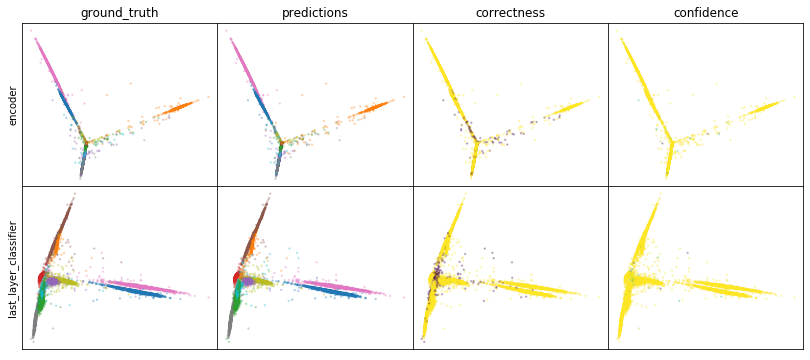

W0808 02:38:20.757503 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:38:21.111084 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:38:21.460554 139838875297536 legend.py:1282] No handles with labels found to put in legend.


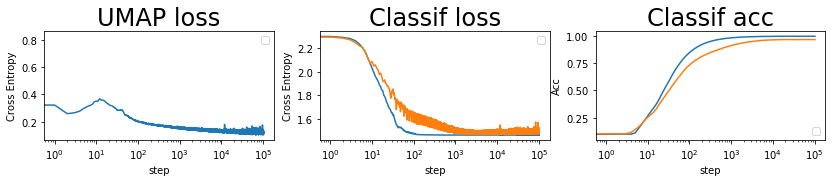

batch: 102000 | train acc: 0.9992 | val acc: 0.9682


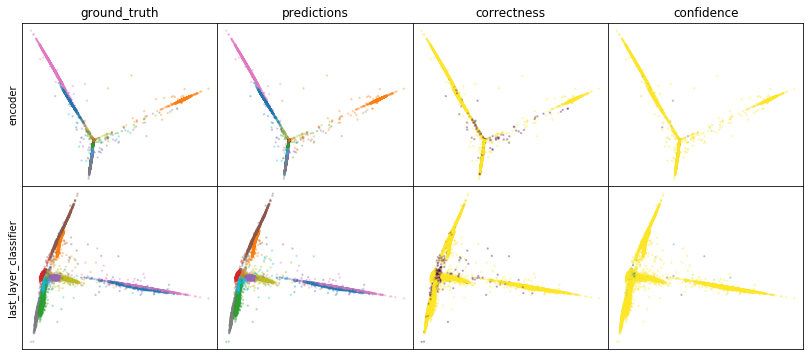

W0808 02:40:44.489391 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:40:44.851274 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:40:45.202171 139838875297536 legend.py:1282] No handles with labels found to put in legend.


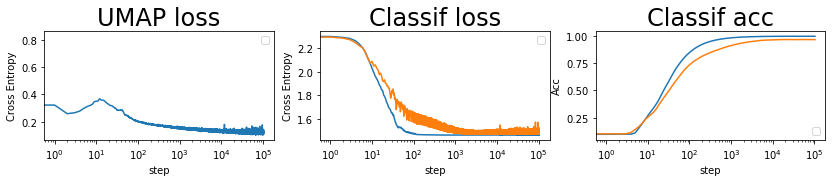

batch: 103000 | train acc: 0.9992 | val acc: 0.9683


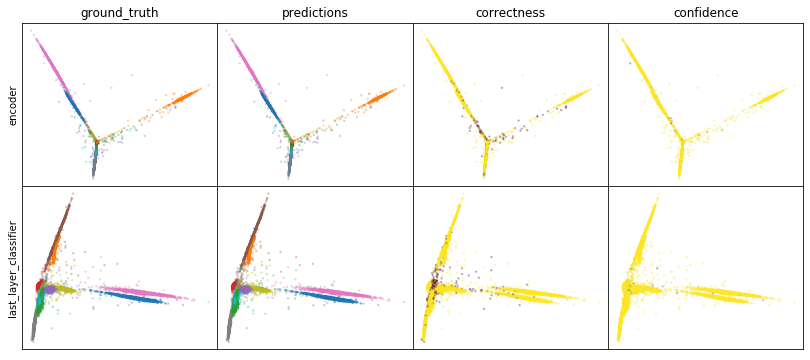

W0808 02:42:52.246291 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:42:52.610269 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:42:52.973118 139838875297536 legend.py:1282] No handles with labels found to put in legend.


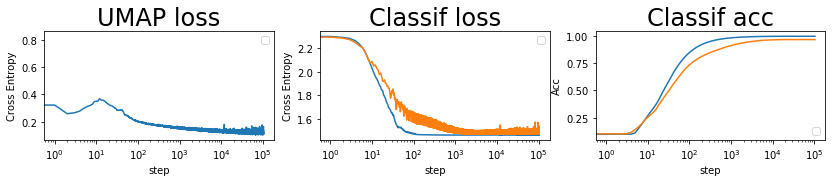

batch: 104000 | train acc: 0.9992 | val acc: 0.9682


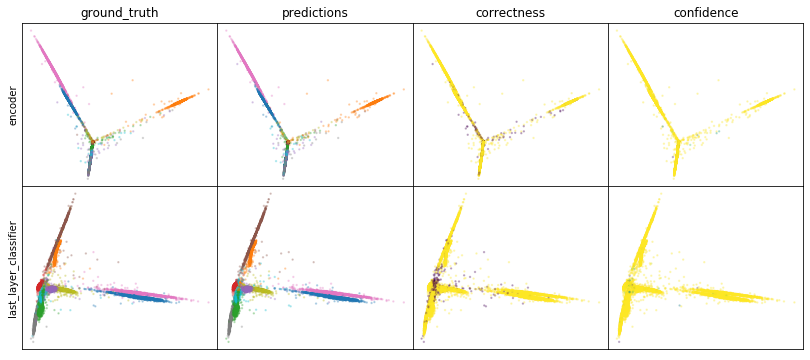

W0808 02:45:57.791969 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:45:58.154752 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:45:58.513566 139838875297536 legend.py:1282] No handles with labels found to put in legend.


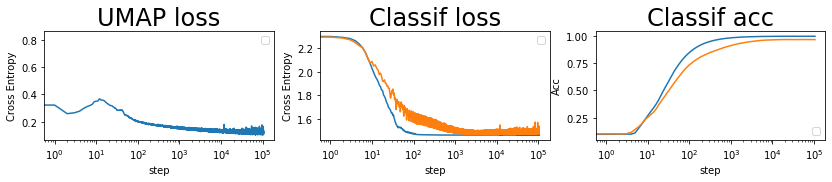

batch: 105000 | train acc: 0.9992 | val acc: 0.9682


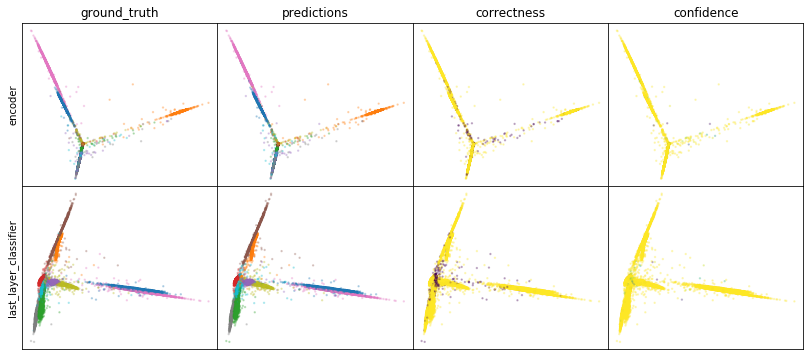

W0808 02:48:06.143984 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:48:06.512410 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:48:06.881772 139838875297536 legend.py:1282] No handles with labels found to put in legend.


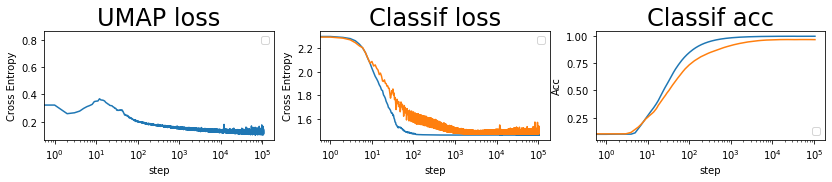

batch: 106000 | train acc: 0.9992 | val acc: 0.9682


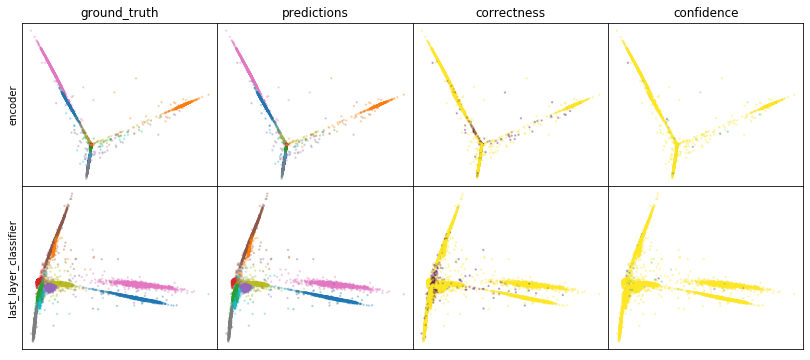

W0808 02:50:16.991437 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:50:17.361314 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:50:17.722036 139838875297536 legend.py:1282] No handles with labels found to put in legend.


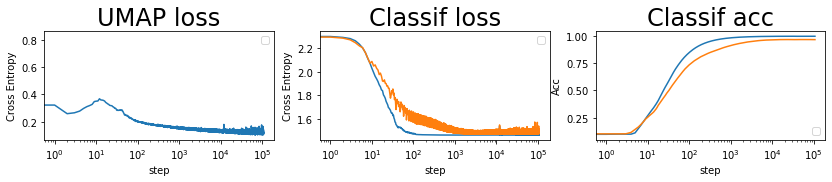

batch: 107000 | train acc: 0.9992 | val acc: 0.9682


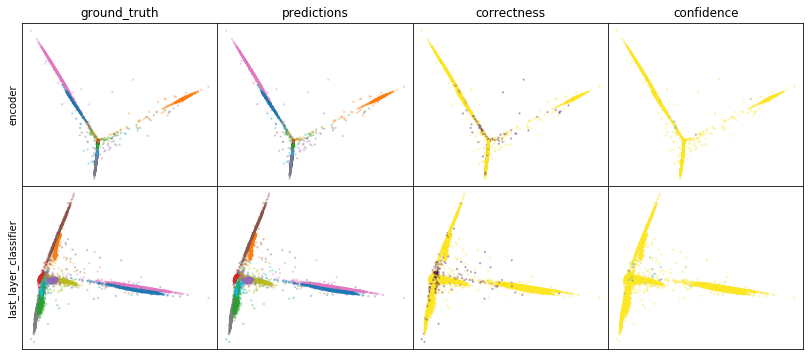

W0808 02:52:56.978574 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:52:57.368893 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:52:57.741834 139838875297536 legend.py:1282] No handles with labels found to put in legend.


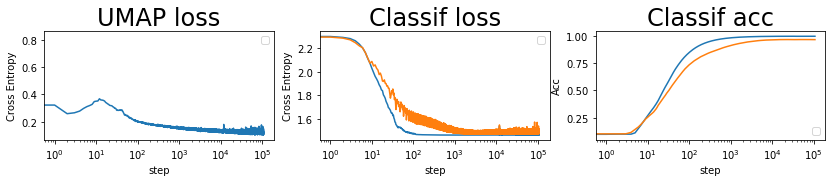

batch: 108000 | train acc: 0.9992 | val acc: 0.9682
leaving epoch because no improvement in 10000 batches


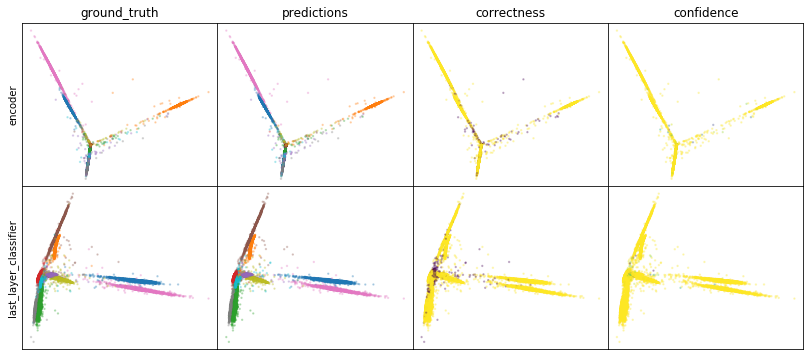

W0808 02:55:08.775377 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:55:09.151872 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:55:09.521234 139838875297536 legend.py:1282] No handles with labels found to put in legend.


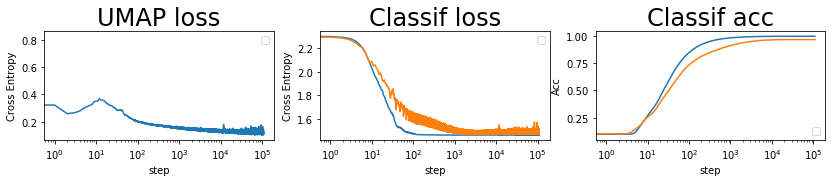

batch: 109000 | train acc: 0.9992 | val acc: 0.9682


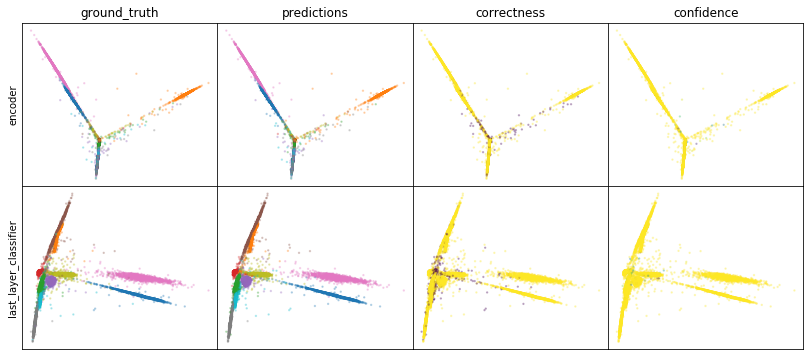

W0808 02:57:20.193426 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:57:20.567892 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 02:57:20.966154 139838875297536 legend.py:1282] No handles with labels found to put in legend.


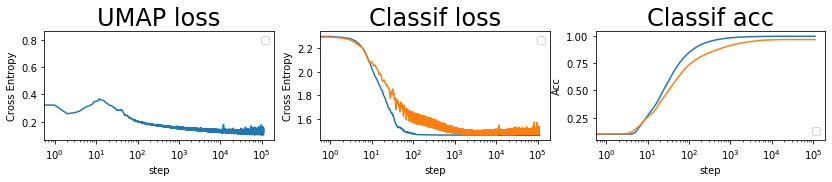

batch: 110000 | train acc: 0.9992 | val acc: 0.9682


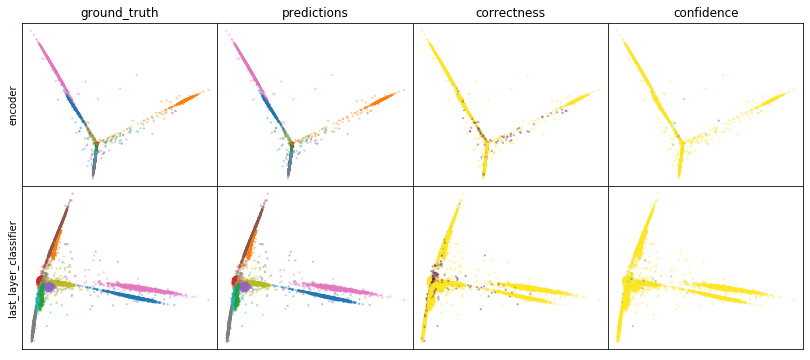

W0808 03:00:17.361941 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:00:17.777602 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:00:18.161976 139838875297536 legend.py:1282] No handles with labels found to put in legend.


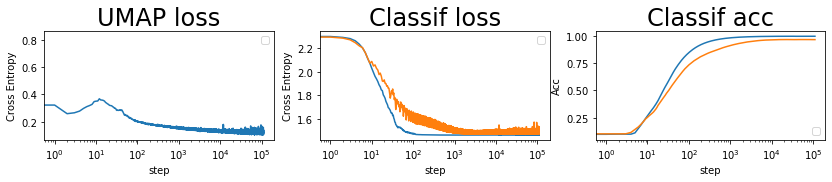

batch: 111000 | train acc: 0.9993 | val acc: 0.9682


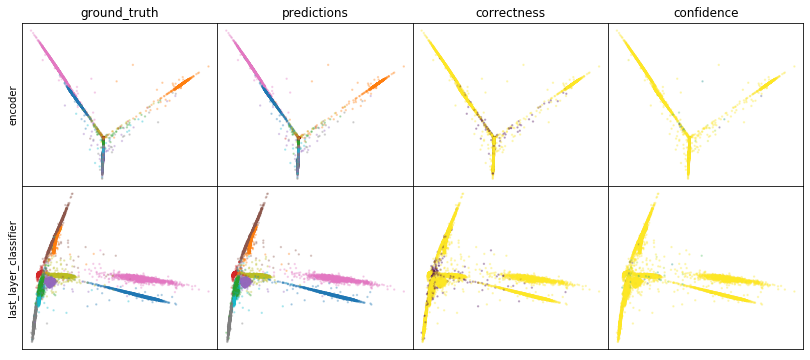

W0808 03:02:26.903870 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:02:27.298454 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:02:27.701356 139838875297536 legend.py:1282] No handles with labels found to put in legend.


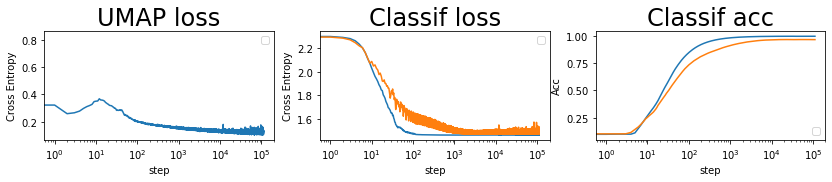

batch: 112000 | train acc: 0.9993 | val acc: 0.9682


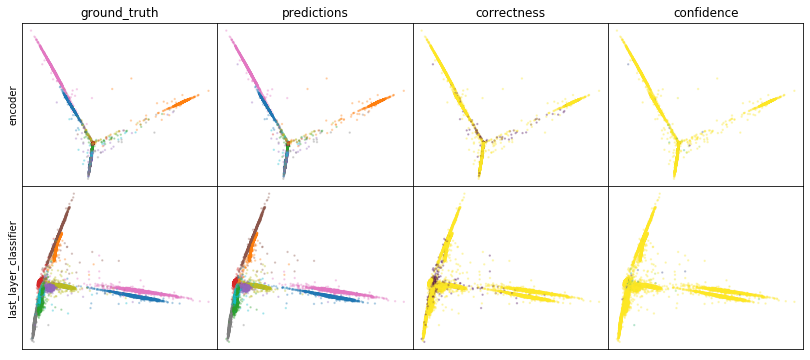

W0808 03:05:13.241306 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:05:13.644240 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:05:14.030421 139838875297536 legend.py:1282] No handles with labels found to put in legend.


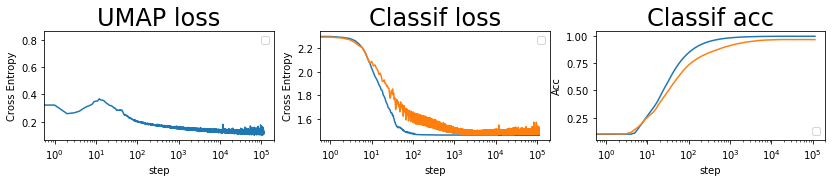

batch: 113000 | train acc: 0.9993 | val acc: 0.9682


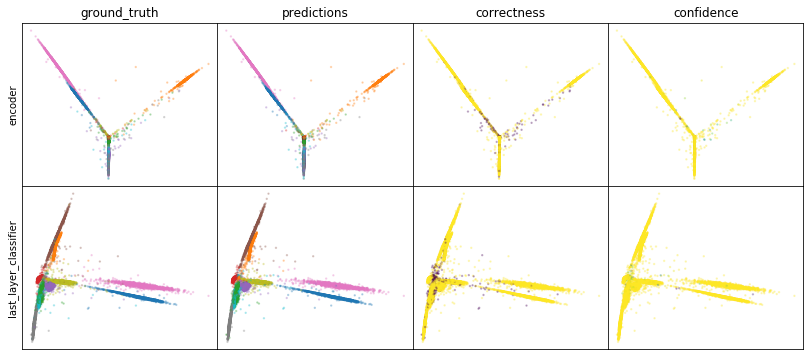

W0808 03:08:04.001663 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:08:04.386671 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:08:04.764202 139838875297536 legend.py:1282] No handles with labels found to put in legend.


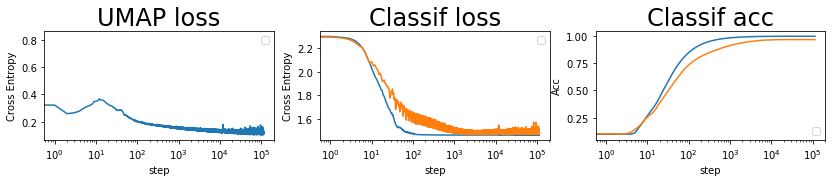

batch: 114000 | train acc: 0.9993 | val acc: 0.9682


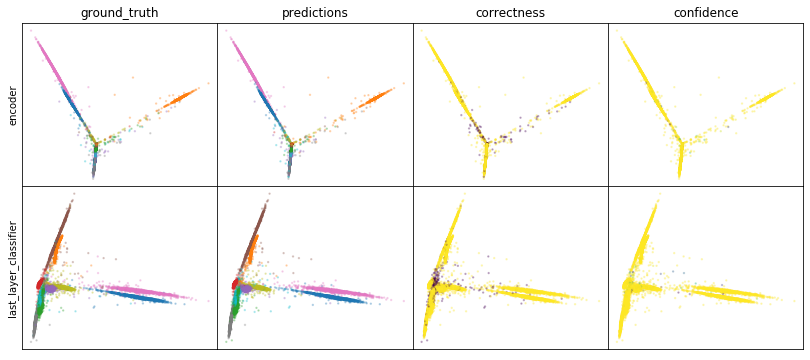

W0808 03:10:17.244191 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:10:17.646228 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:10:18.031070 139838875297536 legend.py:1282] No handles with labels found to put in legend.


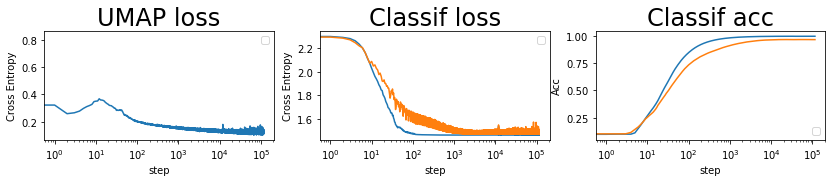

batch: 115000 | train acc: 0.9993 | val acc: 0.9682


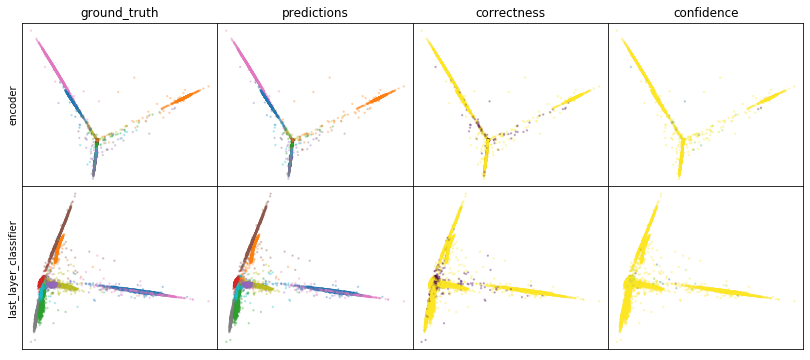

W0808 03:13:19.535912 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:13:19.935987 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:13:20.316338 139838875297536 legend.py:1282] No handles with labels found to put in legend.


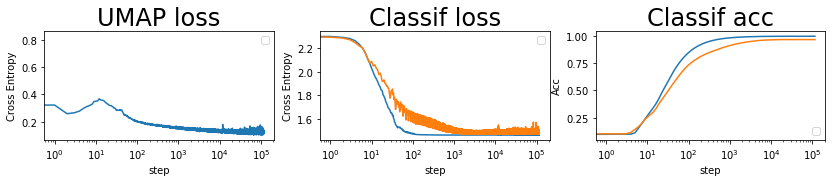

batch: 116000 | train acc: 0.9993 | val acc: 0.9682


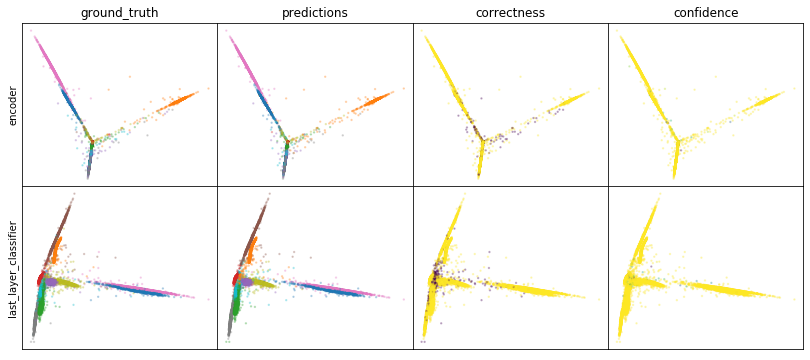

W0808 03:15:33.488279 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:15:33.902590 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:15:34.294276 139838875297536 legend.py:1282] No handles with labels found to put in legend.


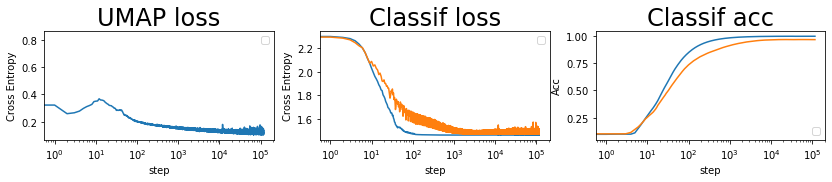

batch: 117000 | train acc: 0.9993 | val acc: 0.9682


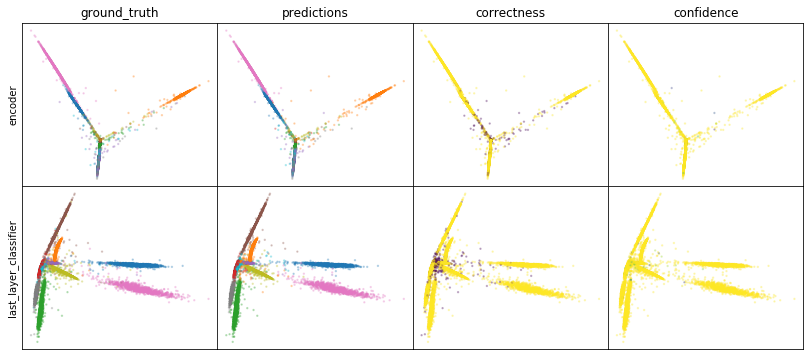

W0808 03:17:47.585774 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:17:47.991827 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:17:48.378491 139838875297536 legend.py:1282] No handles with labels found to put in legend.


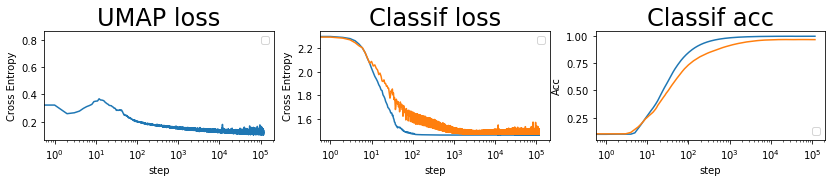

batch: 118000 | train acc: 0.9993 | val acc: 0.9682
leaving epoch because no improvement in 10000 batches


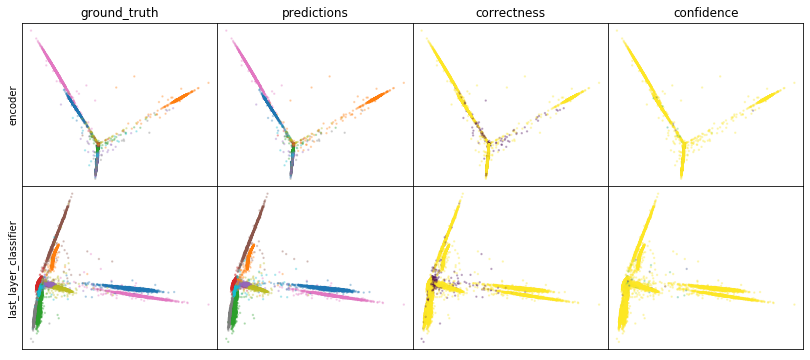

W0808 03:20:34.815595 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:20:35.219622 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:20:35.624200 139838875297536 legend.py:1282] No handles with labels found to put in legend.


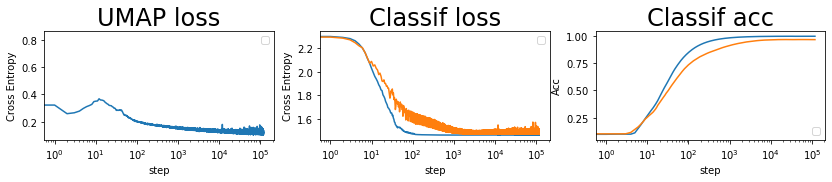

batch: 119000 | train acc: 0.9993 | val acc: 0.9682


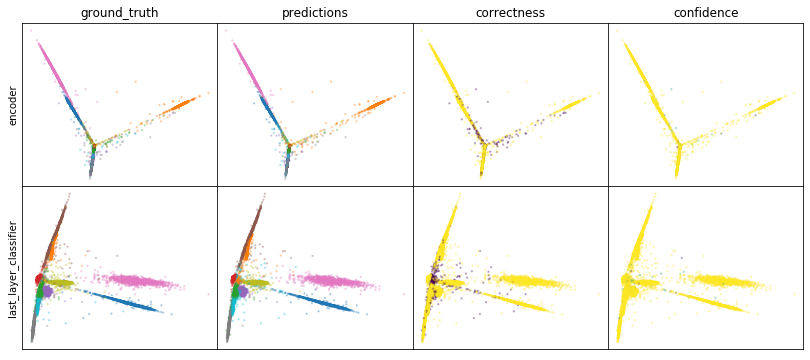

W0808 03:22:48.906527 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:22:49.326820 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:22:49.730149 139838875297536 legend.py:1282] No handles with labels found to put in legend.


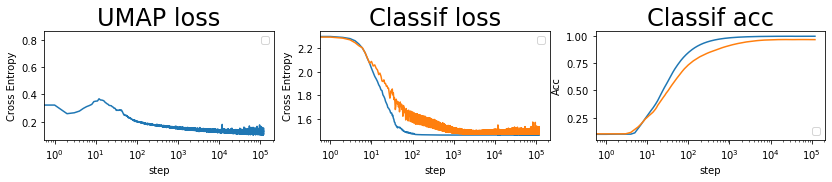

batch: 120000 | train acc: 0.9993 | val acc: 0.9682


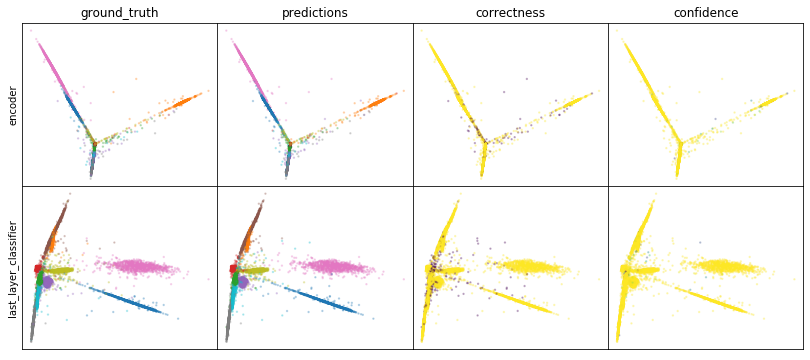

W0808 03:25:07.722791 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:25:08.141066 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:25:08.539692 139838875297536 legend.py:1282] No handles with labels found to put in legend.


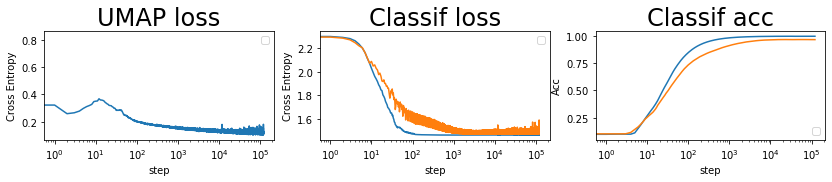

batch: 121000 | train acc: 0.9993 | val acc: 0.9681


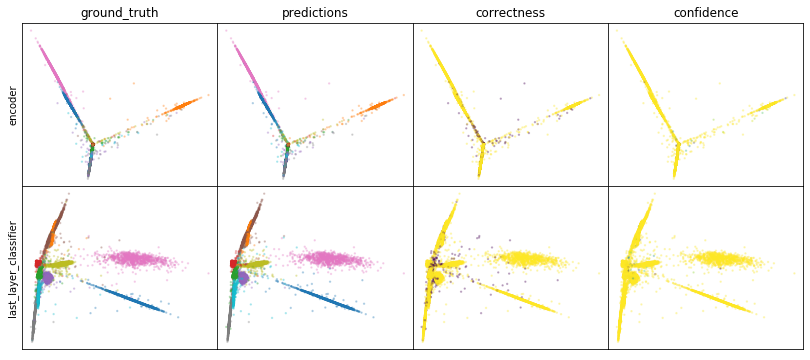

W0808 03:28:10.221181 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:28:10.644928 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:28:11.031372 139838875297536 legend.py:1282] No handles with labels found to put in legend.


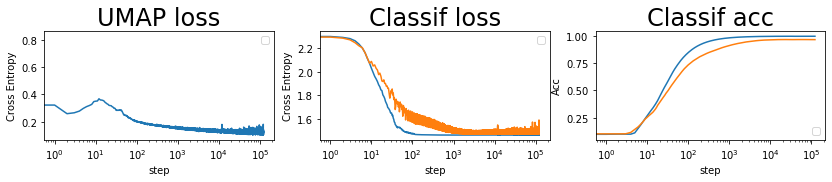

batch: 122000 | train acc: 0.9993 | val acc: 0.9681


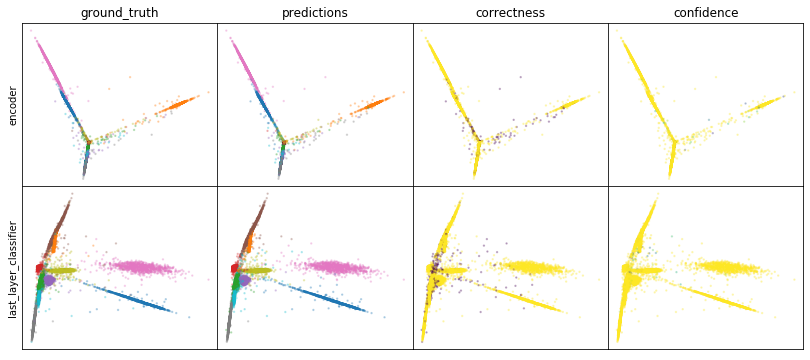

W0808 03:30:26.794045 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:30:27.216061 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:30:27.620339 139838875297536 legend.py:1282] No handles with labels found to put in legend.


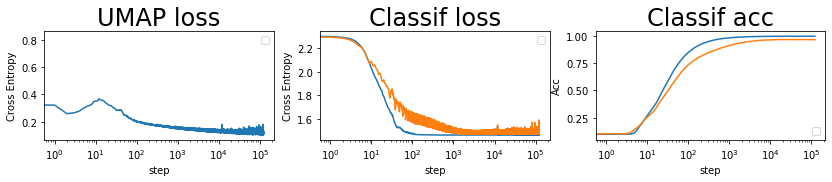

batch: 123000 | train acc: 0.9993 | val acc: 0.9681


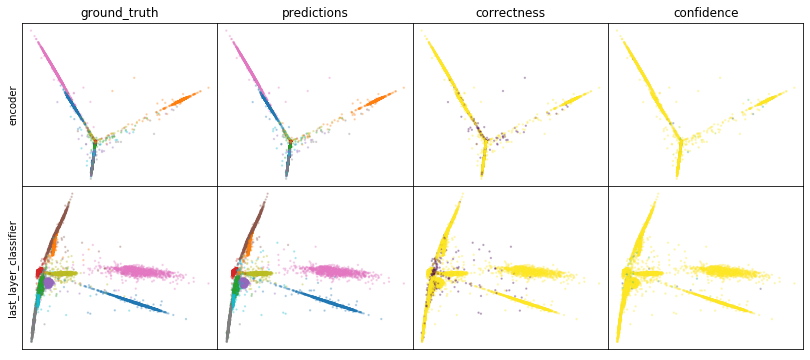

W0808 03:33:07.111718 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:33:07.535253 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:33:07.940775 139838875297536 legend.py:1282] No handles with labels found to put in legend.


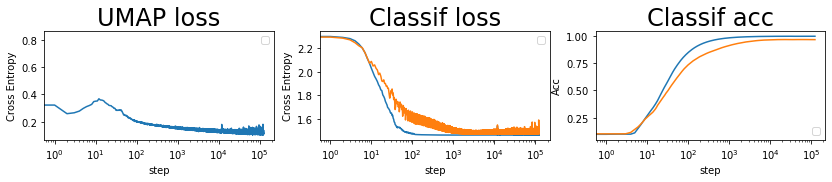

batch: 124000 | train acc: 0.9993 | val acc: 0.9681


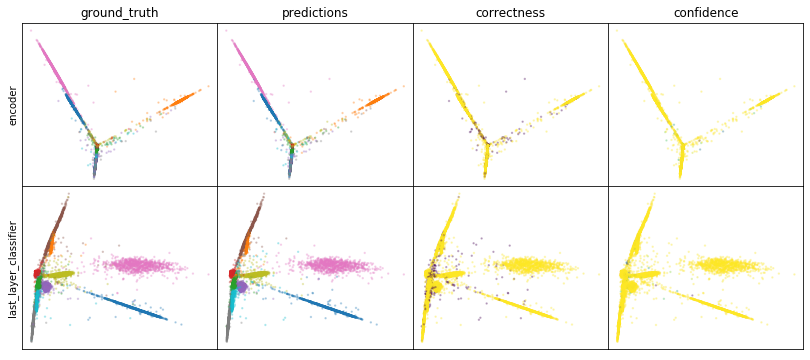

W0808 03:35:45.219786 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:35:45.643546 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:35:46.049375 139838875297536 legend.py:1282] No handles with labels found to put in legend.


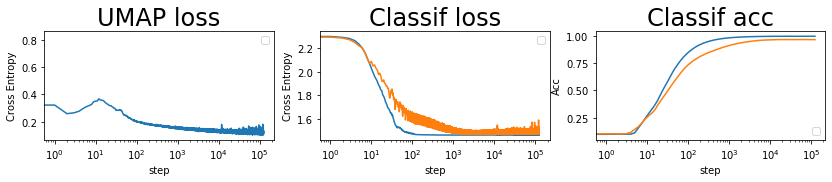

batch: 125000 | train acc: 0.9993 | val acc: 0.9681


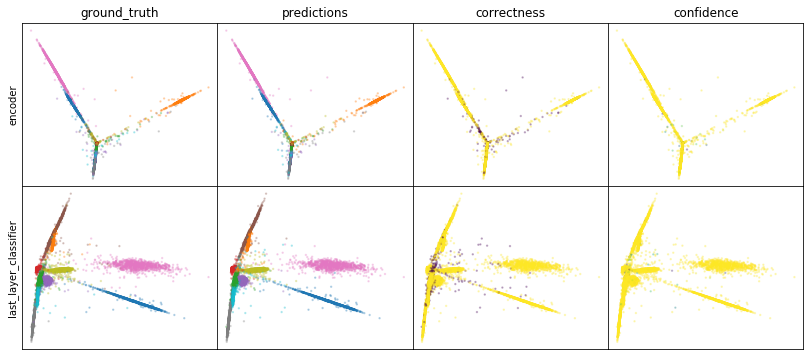

W0808 03:38:03.652199 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:38:04.073908 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:38:04.479121 139838875297536 legend.py:1282] No handles with labels found to put in legend.


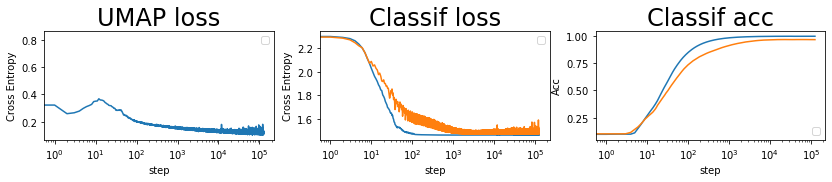

batch: 126000 | train acc: 0.9993 | val acc: 0.9681


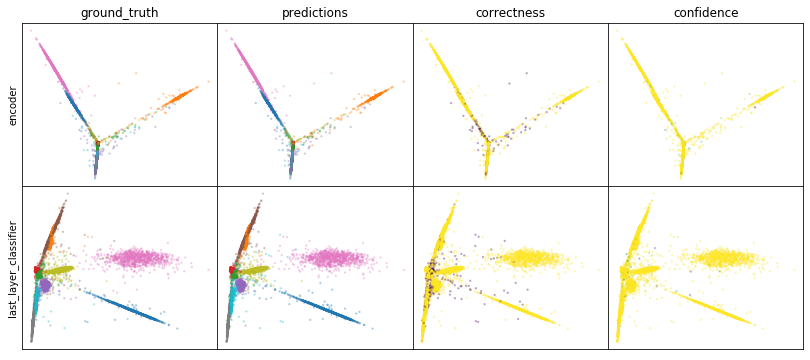

W0808 03:41:20.794411 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:41:21.216809 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:41:21.631279 139838875297536 legend.py:1282] No handles with labels found to put in legend.


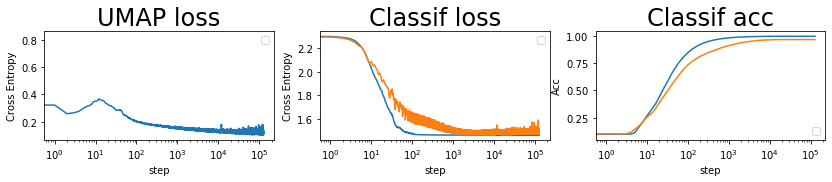

batch: 127000 | train acc: 0.9993 | val acc: 0.968


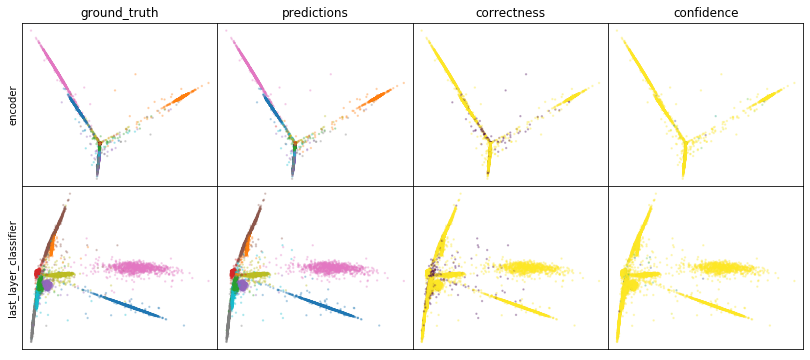

W0808 03:43:40.332656 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:43:40.765838 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:43:41.176676 139838875297536 legend.py:1282] No handles with labels found to put in legend.


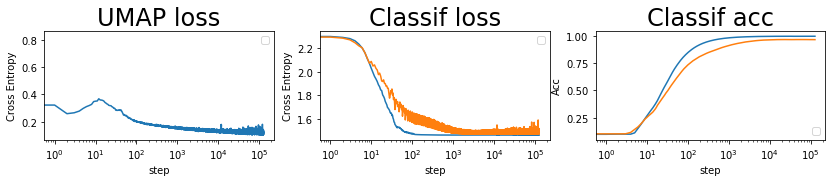

batch: 128000 | train acc: 0.9993 | val acc: 0.968
leaving epoch because no improvement in 10000 batches


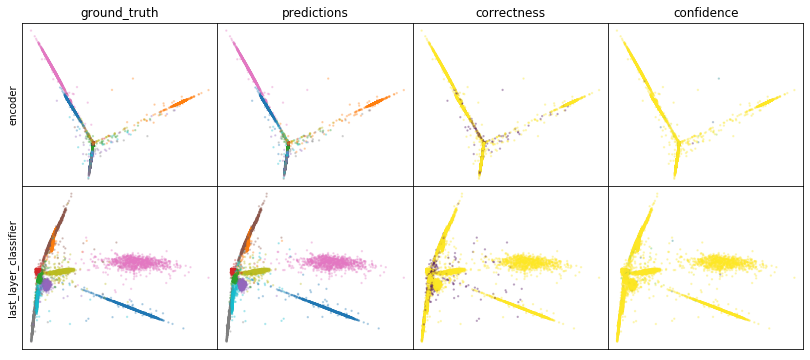

W0808 03:46:08.580363 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:46:09.029553 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:46:09.451585 139838875297536 legend.py:1282] No handles with labels found to put in legend.


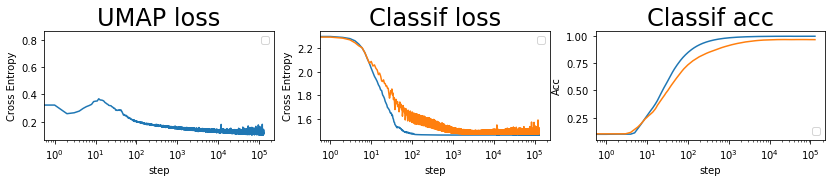

batch: 129000 | train acc: 0.9993 | val acc: 0.968


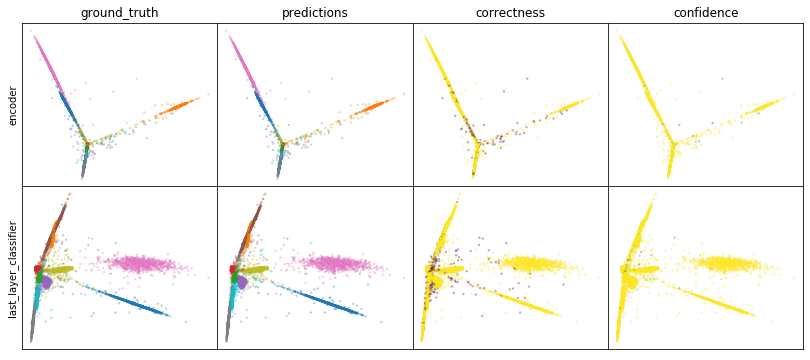

W0808 03:49:28.135890 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:49:28.578440 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:49:28.996794 139838875297536 legend.py:1282] No handles with labels found to put in legend.


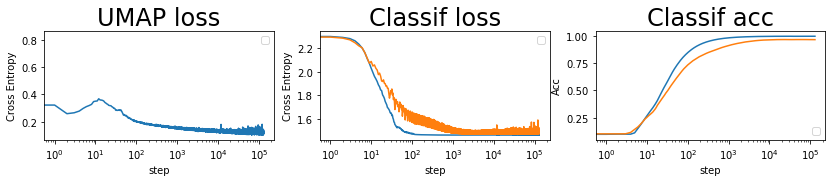

batch: 130000 | train acc: 0.9993 | val acc: 0.968


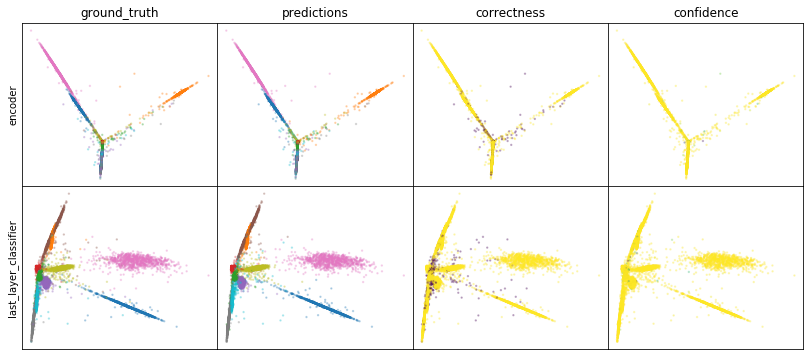

W0808 03:51:49.112615 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:51:49.561276 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:51:49.972790 139838875297536 legend.py:1282] No handles with labels found to put in legend.


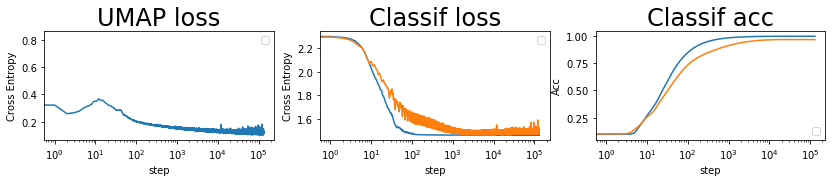

batch: 131000 | train acc: 0.9993 | val acc: 0.968


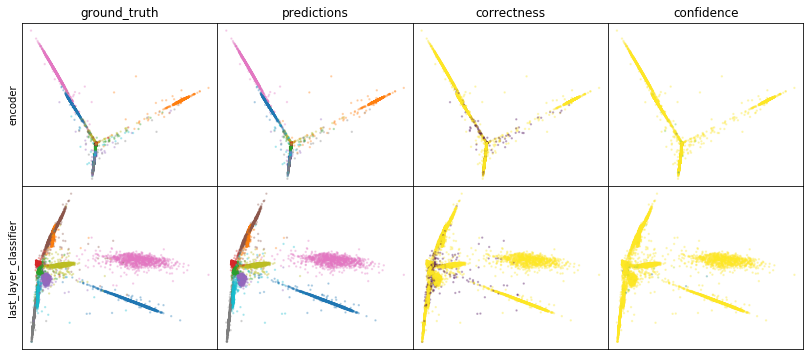

W0808 03:54:50.294431 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:54:50.760317 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:54:51.203509 139838875297536 legend.py:1282] No handles with labels found to put in legend.


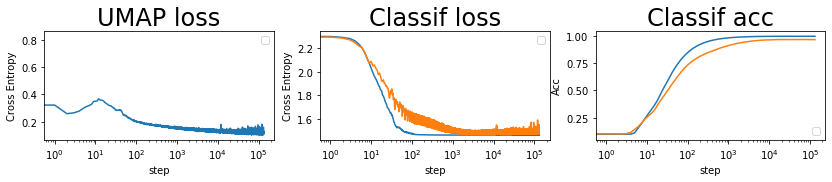

batch: 132000 | train acc: 0.9993 | val acc: 0.9679


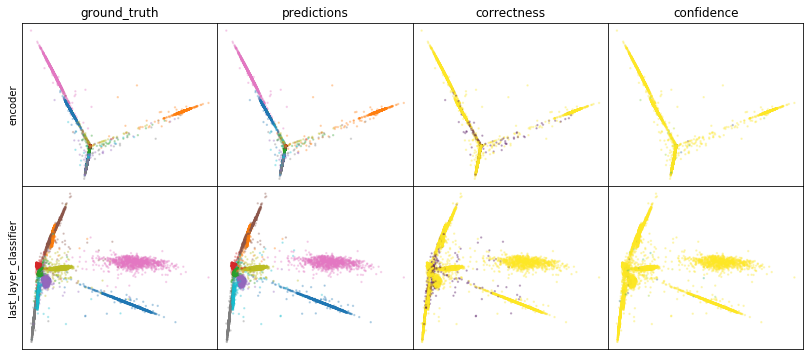

W0808 03:57:14.763196 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:57:15.245195 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:57:15.695940 139838875297536 legend.py:1282] No handles with labels found to put in legend.


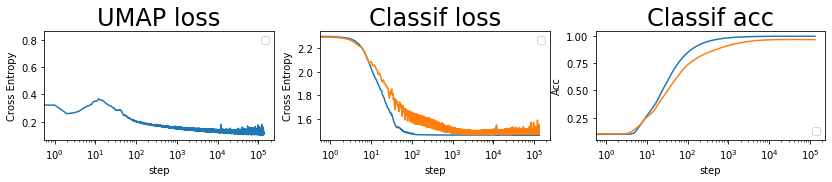

batch: 133000 | train acc: 0.9993 | val acc: 0.9679


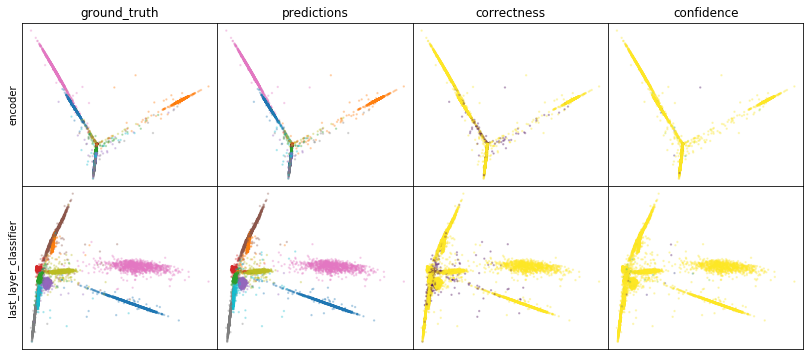

W0808 03:59:37.334047 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:59:37.803213 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 03:59:38.262465 139838875297536 legend.py:1282] No handles with labels found to put in legend.


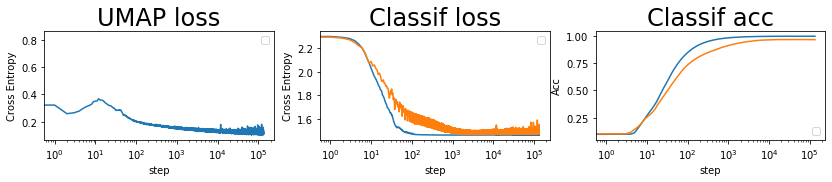

batch: 134000 | train acc: 0.9993 | val acc: 0.9679


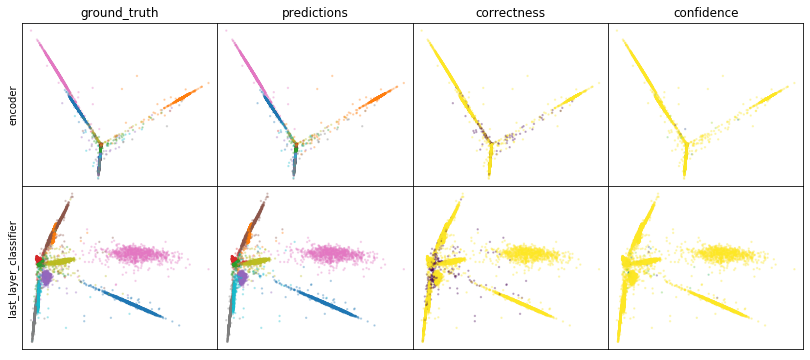

W0808 04:02:51.855009 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:02:52.325048 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:02:52.779488 139838875297536 legend.py:1282] No handles with labels found to put in legend.


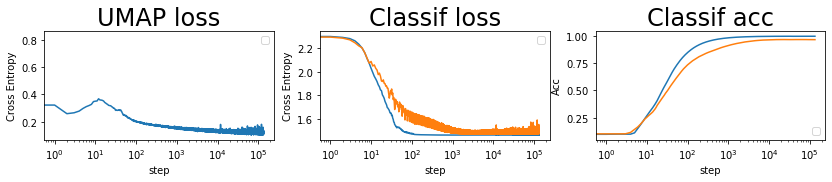

batch: 135000 | train acc: 0.9994 | val acc: 0.9679


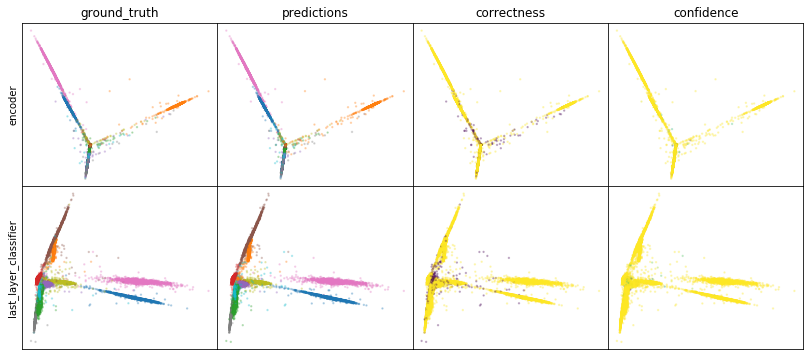

W0808 04:05:16.249356 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:05:16.733595 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:05:17.209692 139838875297536 legend.py:1282] No handles with labels found to put in legend.


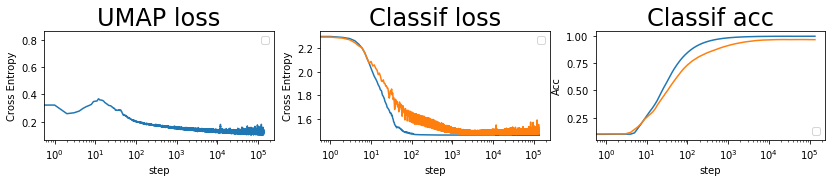

batch: 136000 | train acc: 0.9994 | val acc: 0.968


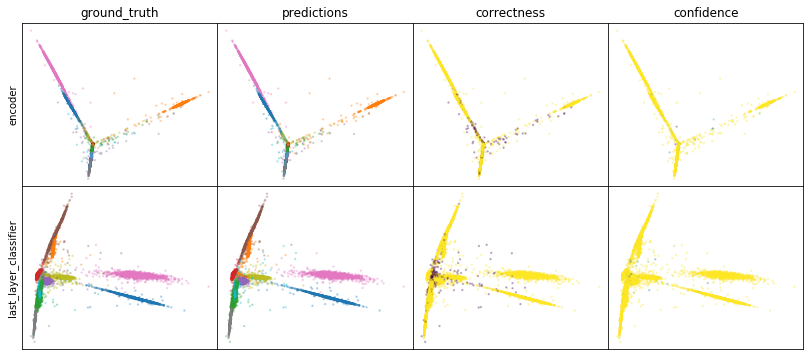

W0808 04:07:58.049717 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:07:58.539509 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:07:59.002711 139838875297536 legend.py:1282] No handles with labels found to put in legend.


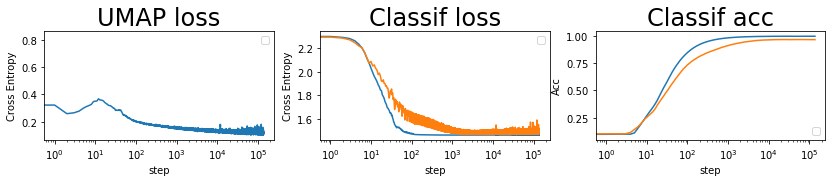

batch: 137000 | train acc: 0.9994 | val acc: 0.968


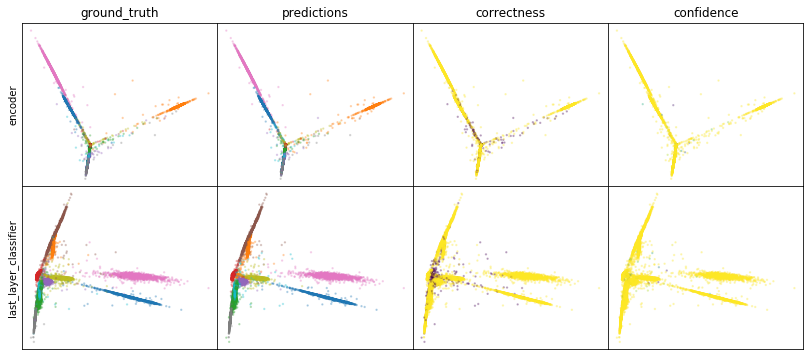

W0808 04:10:41.572246 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:10:42.047303 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:10:42.504435 139838875297536 legend.py:1282] No handles with labels found to put in legend.


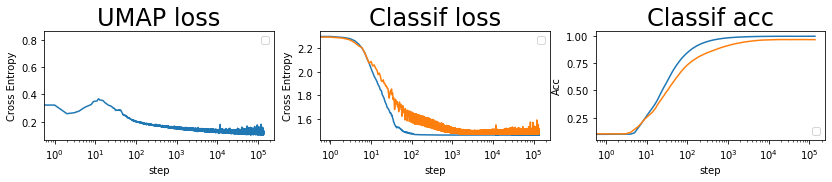

batch: 138000 | train acc: 0.9994 | val acc: 0.9681
leaving epoch because no improvement in 10000 batches


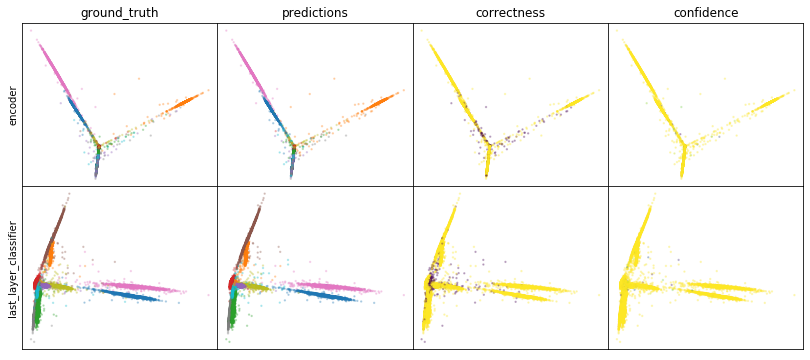

W0808 04:13:06.028309 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:13:06.509634 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:13:06.968214 139838875297536 legend.py:1282] No handles with labels found to put in legend.


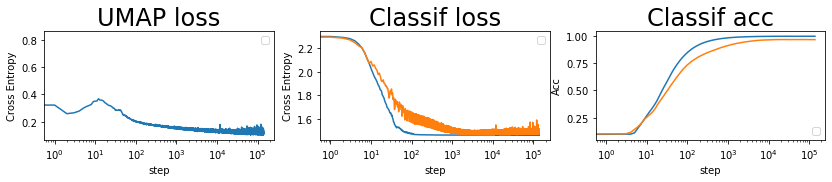

batch: 139000 | train acc: 0.9994 | val acc: 0.9681


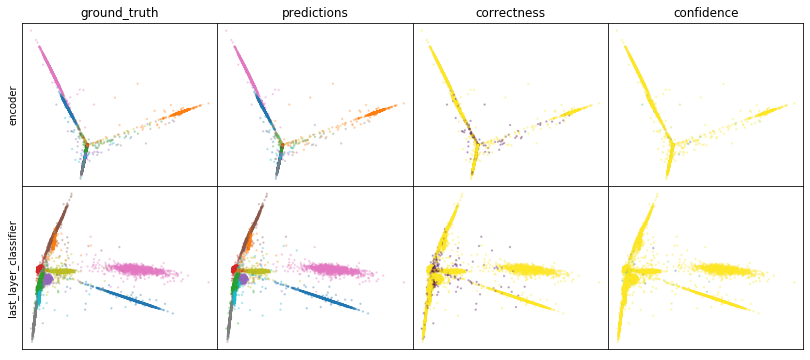

W0808 04:16:14.910106 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:16:15.397827 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:16:15.864087 139838875297536 legend.py:1282] No handles with labels found to put in legend.


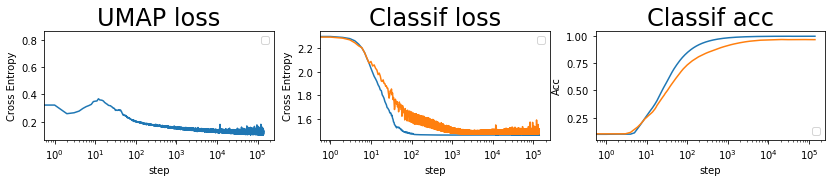

batch: 140000 | train acc: 0.9994 | val acc: 0.9681


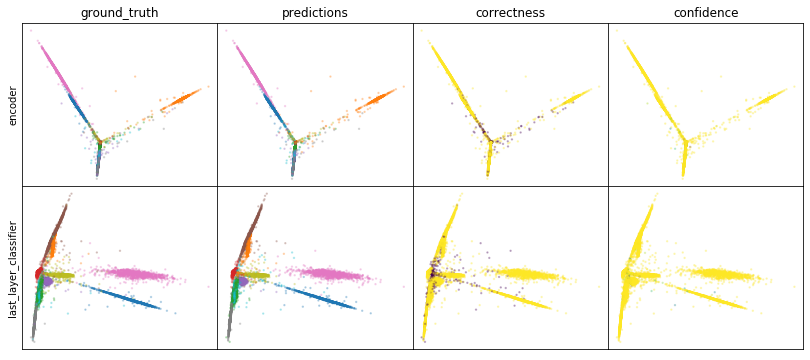

W0808 04:18:41.392460 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:18:41.880154 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:18:42.339371 139838875297536 legend.py:1282] No handles with labels found to put in legend.


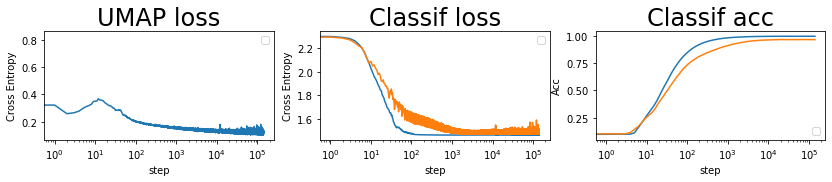

batch: 141000 | train acc: 0.9994 | val acc: 0.9682


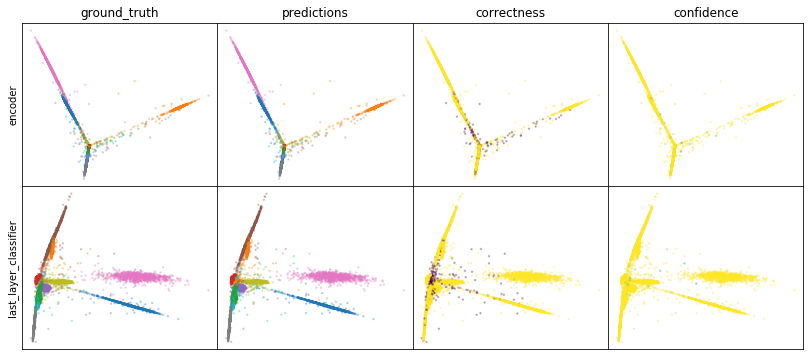

W0808 04:21:10.407403 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:21:10.902041 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:21:11.371612 139838875297536 legend.py:1282] No handles with labels found to put in legend.


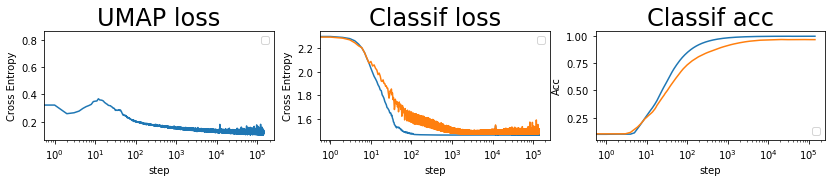

batch: 142000 | train acc: 0.9994 | val acc: 0.9682


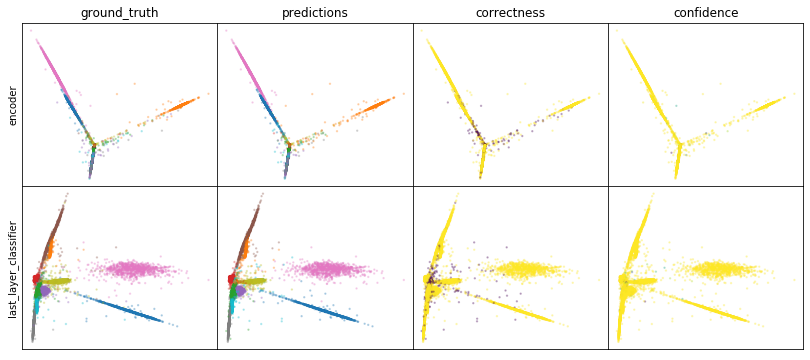

W0808 04:24:09.322506 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:24:09.840908 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:24:10.339630 139838875297536 legend.py:1282] No handles with labels found to put in legend.


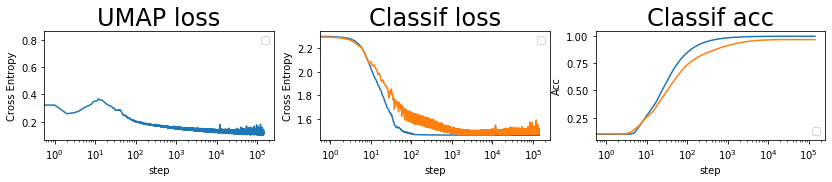

batch: 143000 | train acc: 0.9994 | val acc: 0.9682


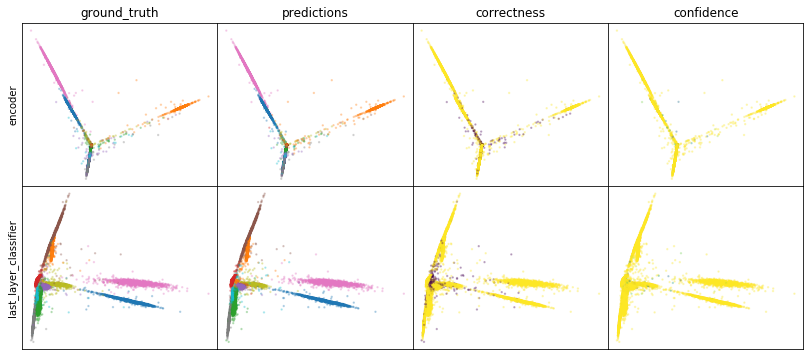

W0808 04:26:36.141058 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:26:36.640849 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:26:37.114498 139838875297536 legend.py:1282] No handles with labels found to put in legend.


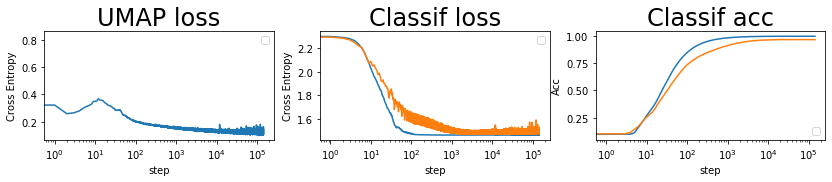

batch: 144000 | train acc: 0.9994 | val acc: 0.9682


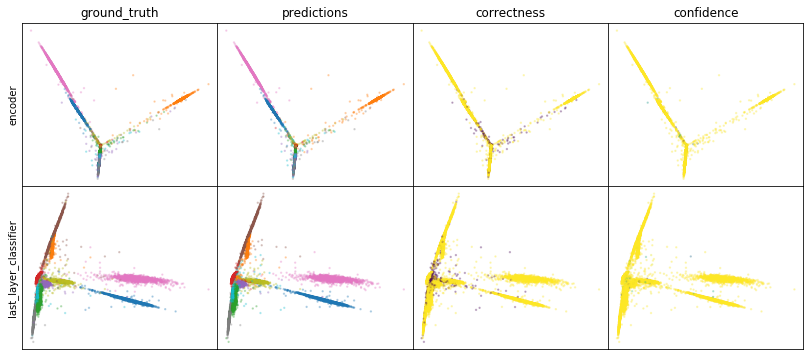

W0808 04:29:36.078085 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:29:36.603825 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:29:37.099443 139838875297536 legend.py:1282] No handles with labels found to put in legend.


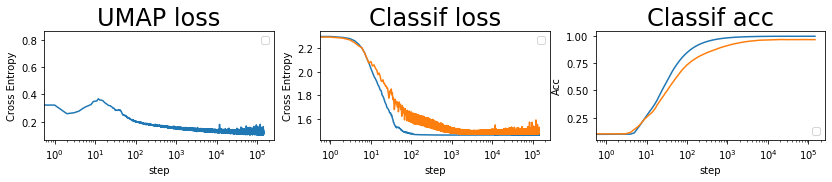

batch: 145000 | train acc: 0.9994 | val acc: 0.9682


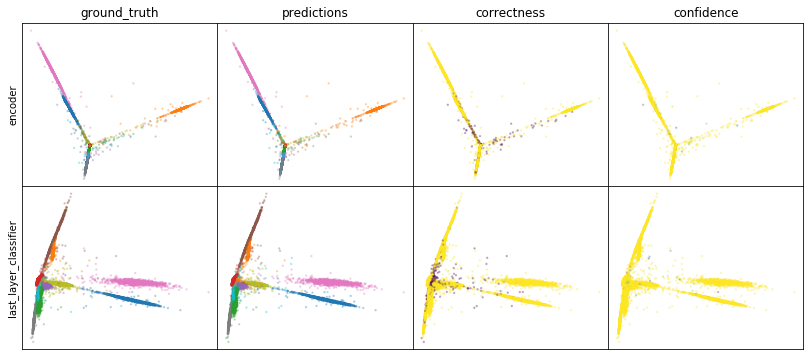

W0808 04:32:03.247345 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:32:03.761524 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:32:04.247206 139838875297536 legend.py:1282] No handles with labels found to put in legend.


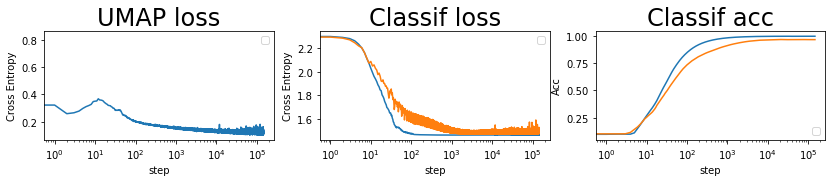

batch: 146000 | train acc: 0.9994 | val acc: 0.9682


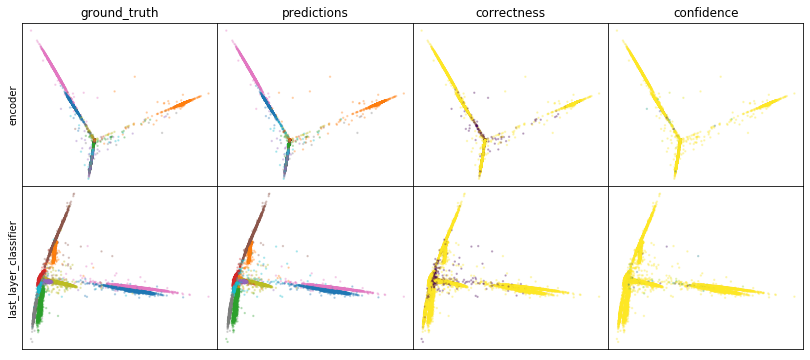

W0808 04:34:30.952721 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:34:31.468855 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:34:31.970081 139838875297536 legend.py:1282] No handles with labels found to put in legend.


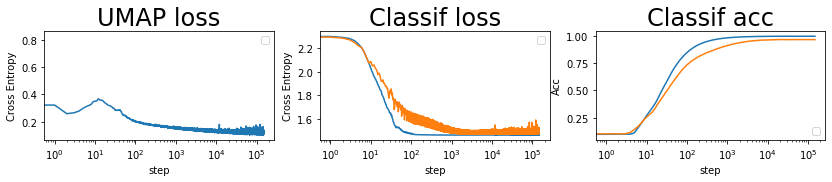

batch: 147000 | train acc: 0.9994 | val acc: 0.9683


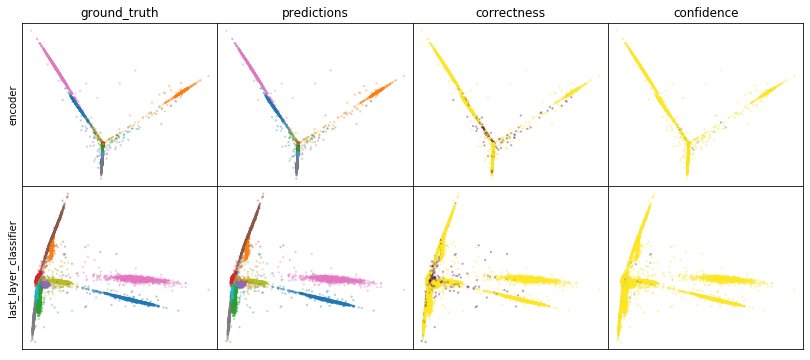

W0808 04:37:43.247233 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:37:43.764734 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:37:44.254024 139838875297536 legend.py:1282] No handles with labels found to put in legend.


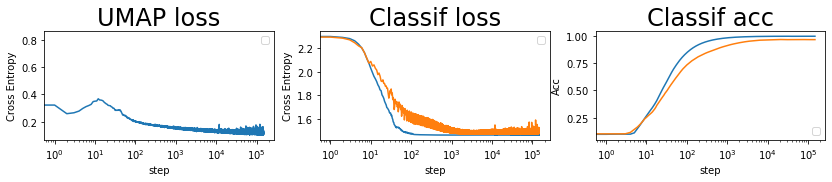

batch: 148000 | train acc: 0.9994 | val acc: 0.9683
leaving epoch because no improvement in 10000 batches


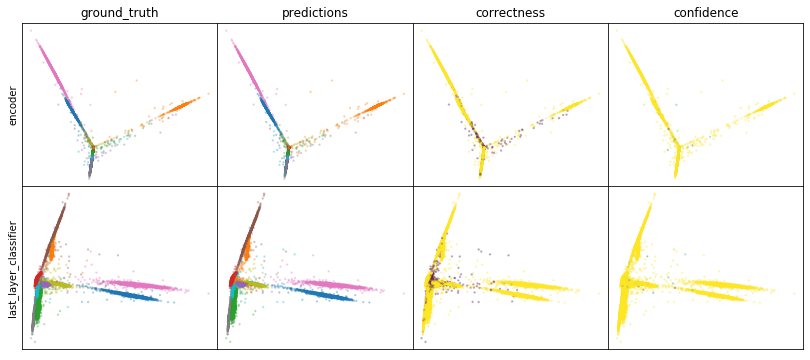

W0808 04:40:12.195036 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:40:12.711247 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:40:13.206192 139838875297536 legend.py:1282] No handles with labels found to put in legend.


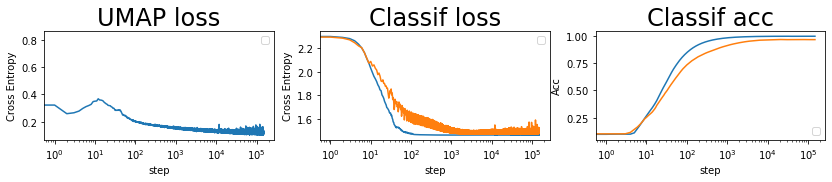

batch: 149000 | train acc: 0.9994 | val acc: 0.9683


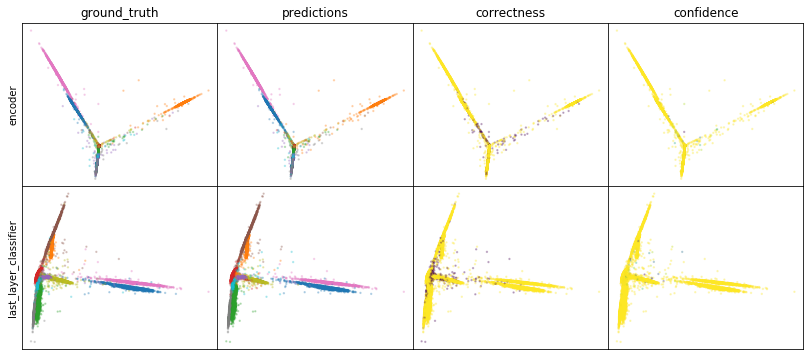

W0808 04:43:13.470583 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:43:14.005664 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:43:14.512204 139838875297536 legend.py:1282] No handles with labels found to put in legend.


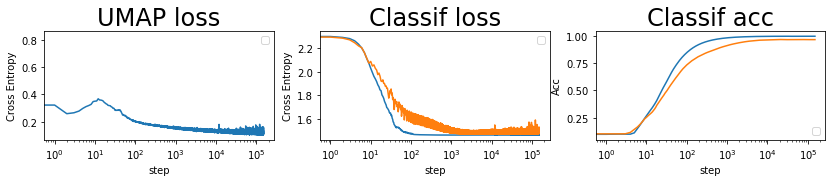

batch: 150000 | train acc: 0.9994 | val acc: 0.9683


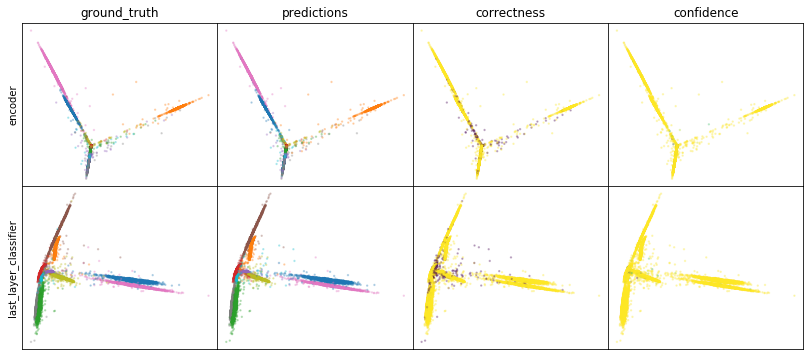

W0808 04:45:45.310942 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:45:45.835119 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:45:46.328093 139838875297536 legend.py:1282] No handles with labels found to put in legend.


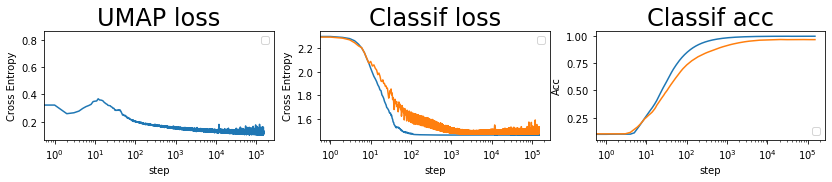

batch: 151000 | train acc: 0.9994 | val acc: 0.9683


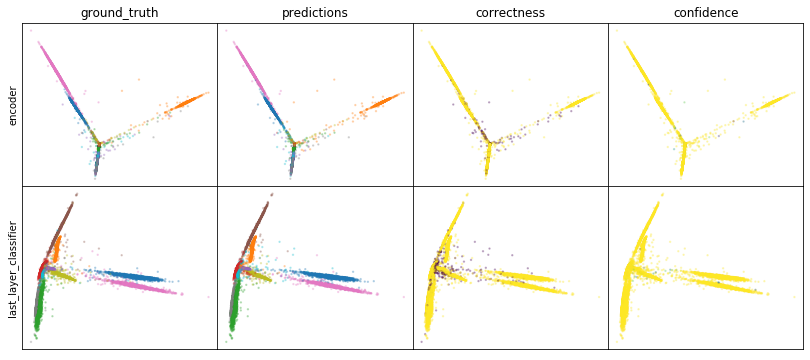

W0808 04:48:13.230497 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:48:13.797443 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:48:14.316079 139838875297536 legend.py:1282] No handles with labels found to put in legend.


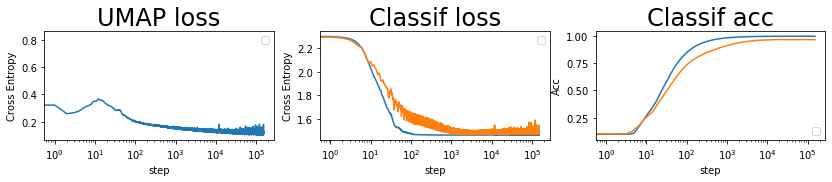

batch: 152000 | train acc: 0.9994 | val acc: 0.9683


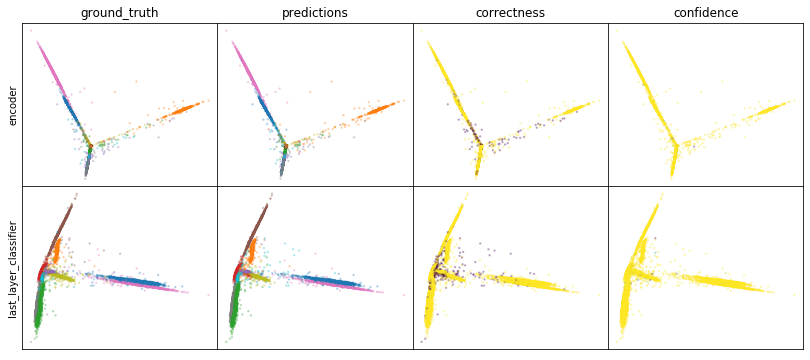

W0808 04:51:32.057493 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:51:32.600068 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:51:33.116680 139838875297536 legend.py:1282] No handles with labels found to put in legend.


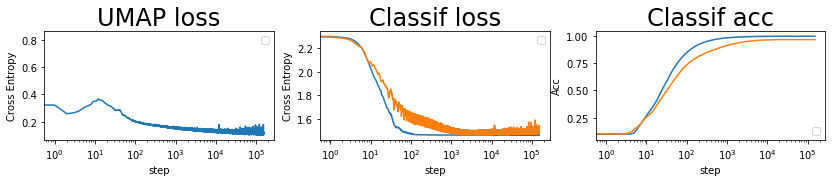

batch: 153000 | train acc: 0.9994 | val acc: 0.9683


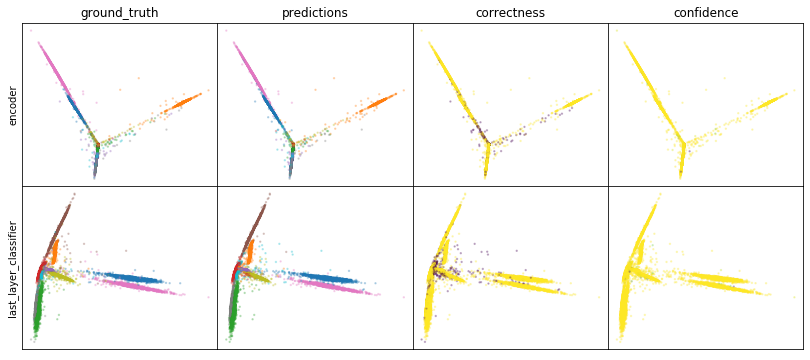

W0808 04:54:01.833175 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:54:02.365156 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:54:02.869700 139838875297536 legend.py:1282] No handles with labels found to put in legend.


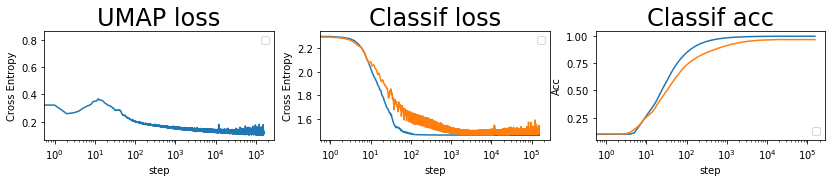

batch: 154000 | train acc: 0.9994 | val acc: 0.9684


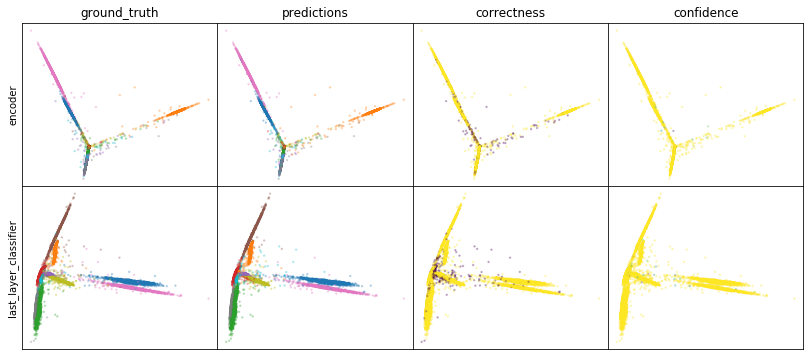

W0808 04:57:08.334236 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:57:08.871570 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:57:09.381735 139838875297536 legend.py:1282] No handles with labels found to put in legend.


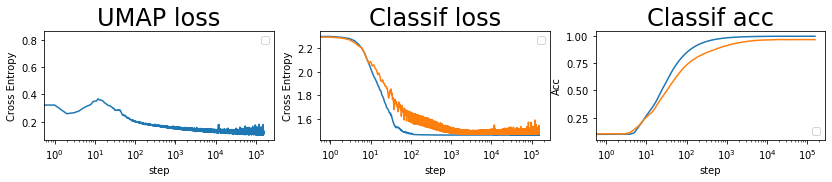

batch: 155000 | train acc: 0.9994 | val acc: 0.9684


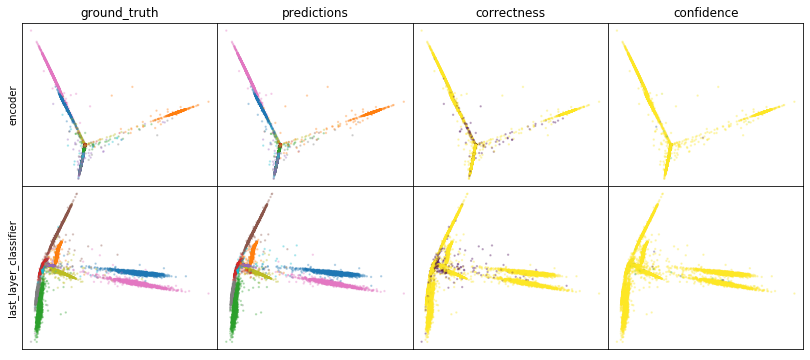

W0808 04:59:41.070980 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:59:41.629996 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 04:59:42.150431 139838875297536 legend.py:1282] No handles with labels found to put in legend.


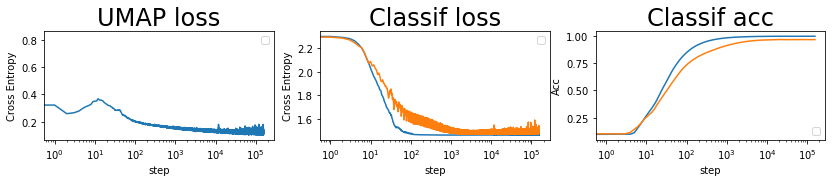

batch: 156000 | train acc: 0.9994 | val acc: 0.9684


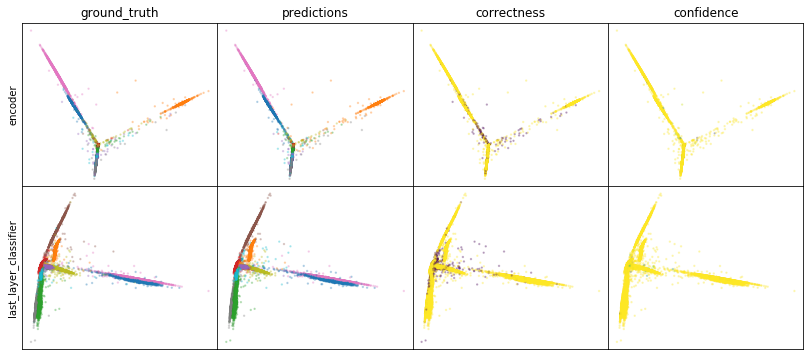

W0808 05:02:14.941742 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:02:15.485381 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:02:16.000514 139838875297536 legend.py:1282] No handles with labels found to put in legend.


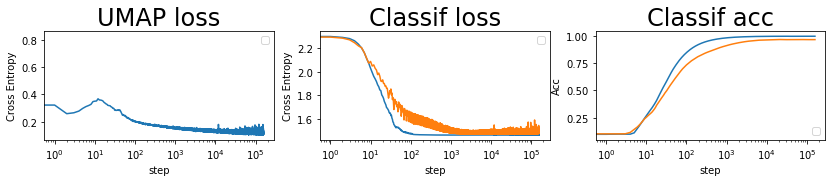

batch: 157000 | train acc: 0.9994 | val acc: 0.9684


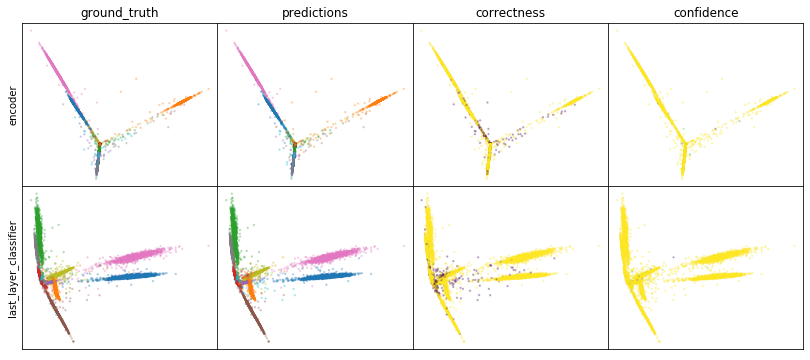

W0808 05:05:22.874773 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:05:23.429406 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:05:23.983228 139838875297536 legend.py:1282] No handles with labels found to put in legend.


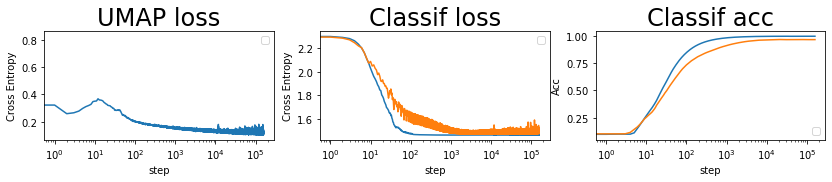

batch: 158000 | train acc: 0.9994 | val acc: 0.9684
leaving epoch because no improvement in 10000 batches


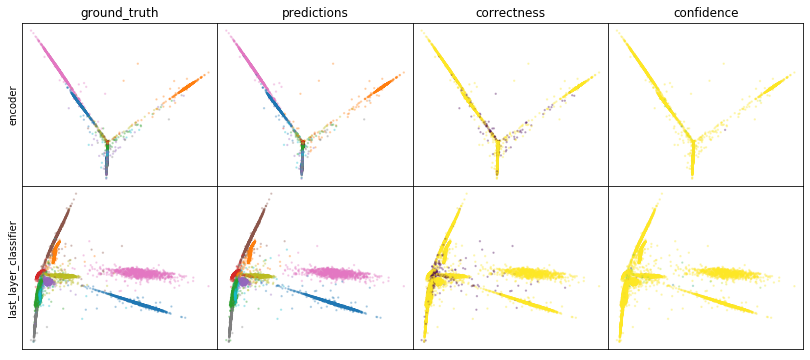

W0808 05:07:57.208714 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:07:57.762223 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:07:58.286831 139838875297536 legend.py:1282] No handles with labels found to put in legend.


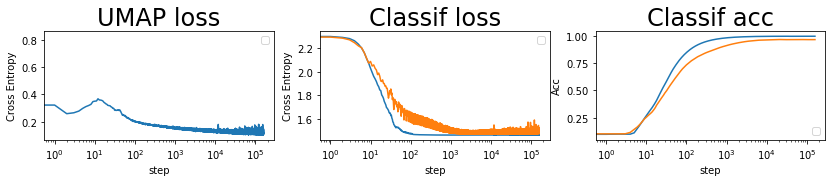

batch: 159000 | train acc: 0.9995 | val acc: 0.9684


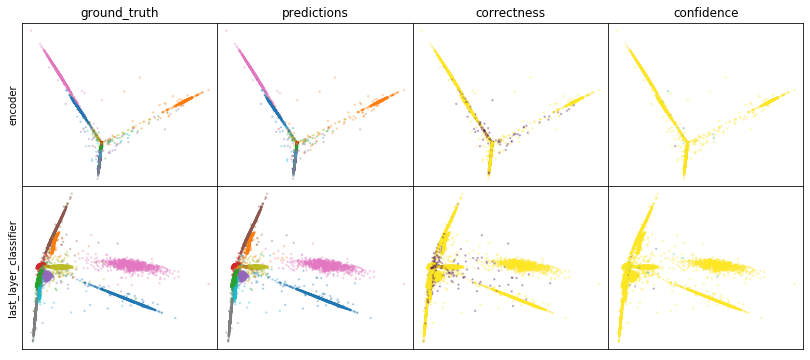

W0808 05:11:14.660759 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:11:15.205215 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:11:15.720213 139838875297536 legend.py:1282] No handles with labels found to put in legend.


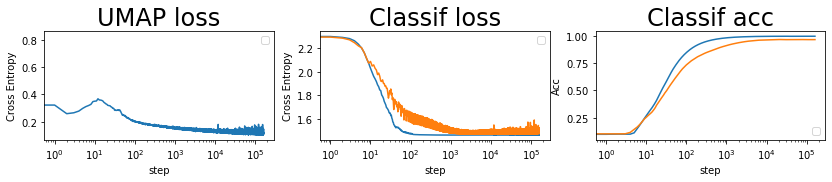

batch: 160000 | train acc: 0.9995 | val acc: 0.9684


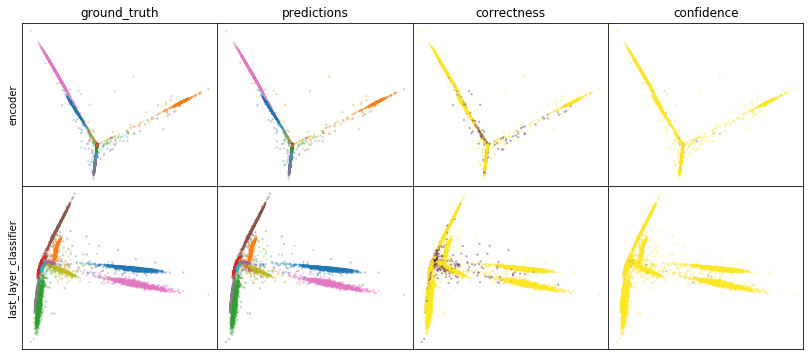

W0808 05:13:48.887772 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:13:49.458330 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:13:49.993040 139838875297536 legend.py:1282] No handles with labels found to put in legend.


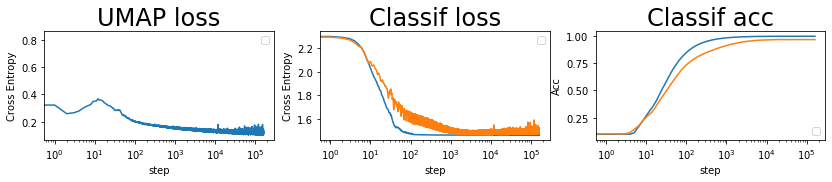

batch: 161000 | train acc: 0.9995 | val acc: 0.9684


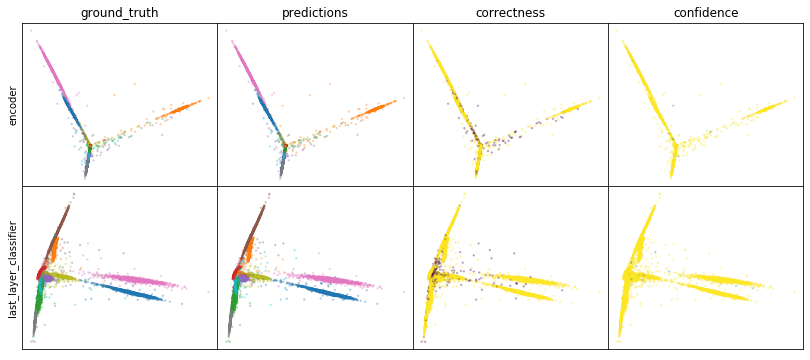

W0808 05:16:27.935679 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:16:28.494606 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:16:29.021715 139838875297536 legend.py:1282] No handles with labels found to put in legend.


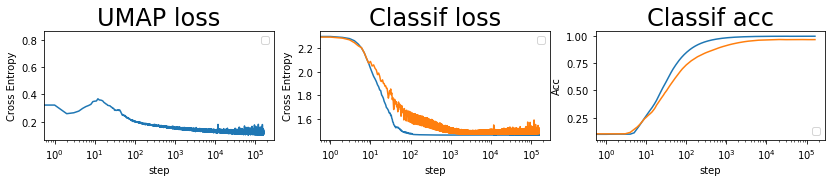

batch: 162000 | train acc: 0.9995 | val acc: 0.9684


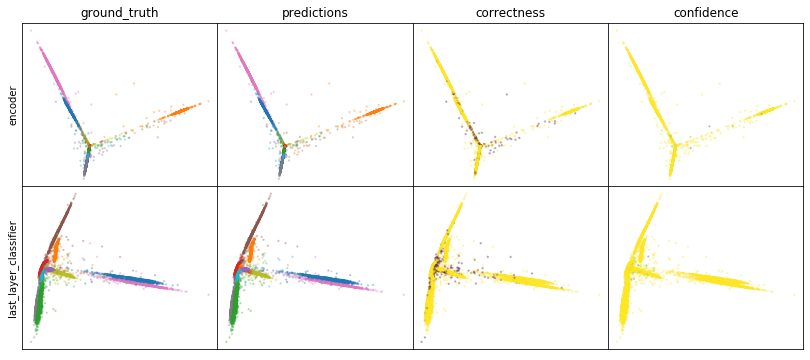

W0808 05:19:29.139431 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:19:29.694155 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:19:30.220194 139838875297536 legend.py:1282] No handles with labels found to put in legend.


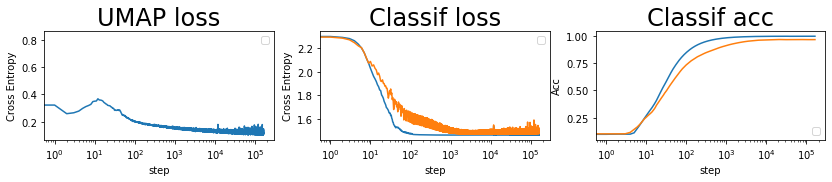

batch: 163000 | train acc: 0.9995 | val acc: 0.9684


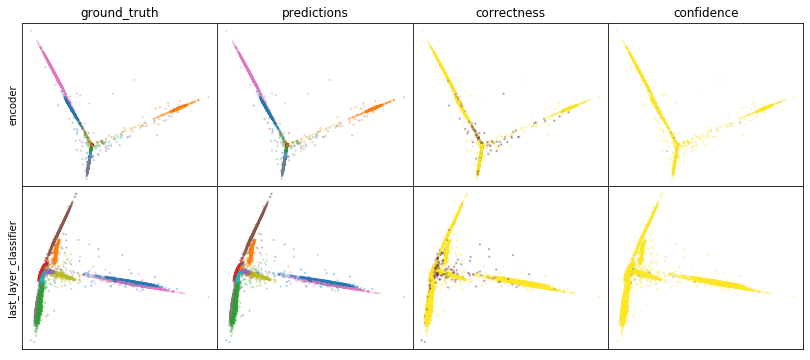

W0808 05:22:05.106100 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:22:05.660696 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:22:06.189108 139838875297536 legend.py:1282] No handles with labels found to put in legend.


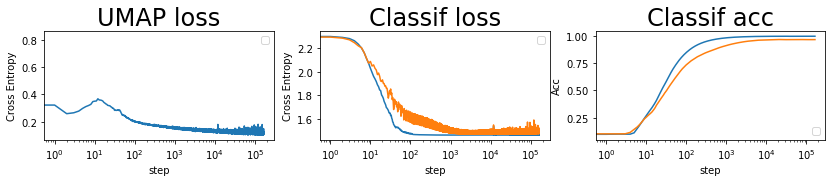

batch: 164000 | train acc: 0.9995 | val acc: 0.9684


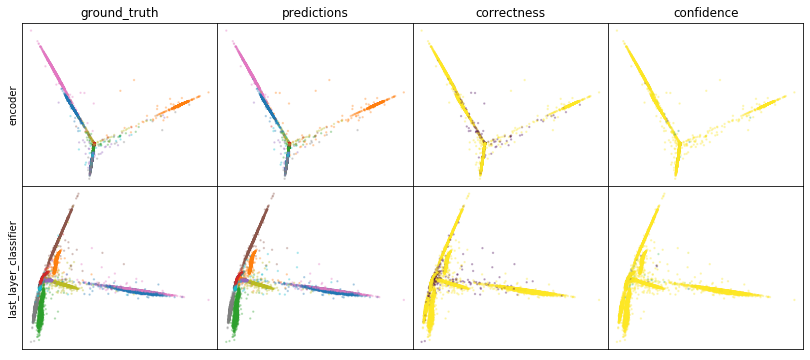

W0808 05:25:41.077180 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:25:41.651360 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:25:42.208797 139838875297536 legend.py:1282] No handles with labels found to put in legend.


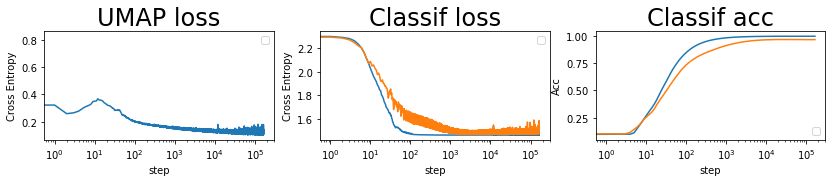

batch: 165000 | train acc: 0.9995 | val acc: 0.9684


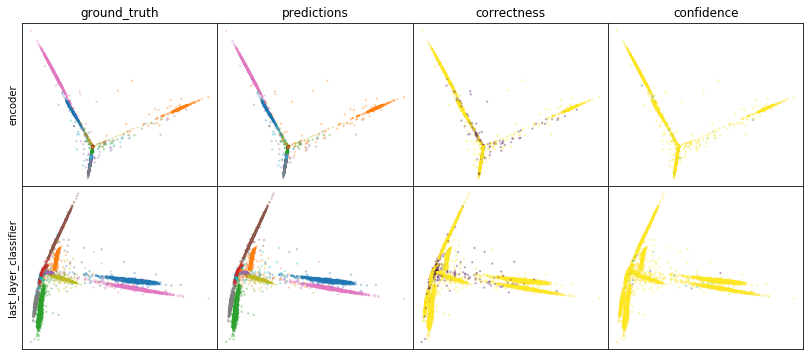

W0808 05:28:19.419591 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:28:19.973802 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:28:20.499095 139838875297536 legend.py:1282] No handles with labels found to put in legend.


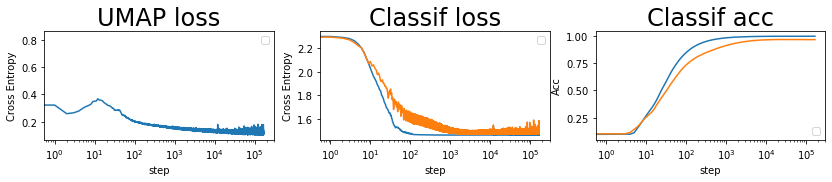

batch: 166000 | train acc: 0.9995 | val acc: 0.9685


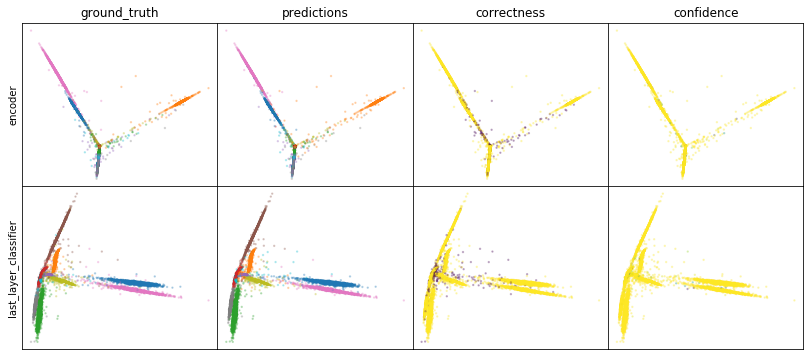

W0808 05:31:22.236961 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:31:22.803176 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:31:23.339333 139838875297536 legend.py:1282] No handles with labels found to put in legend.


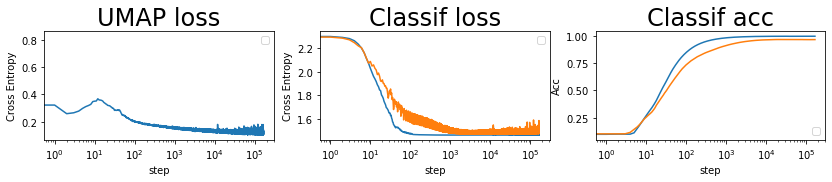

batch: 167000 | train acc: 0.9995 | val acc: 0.9685


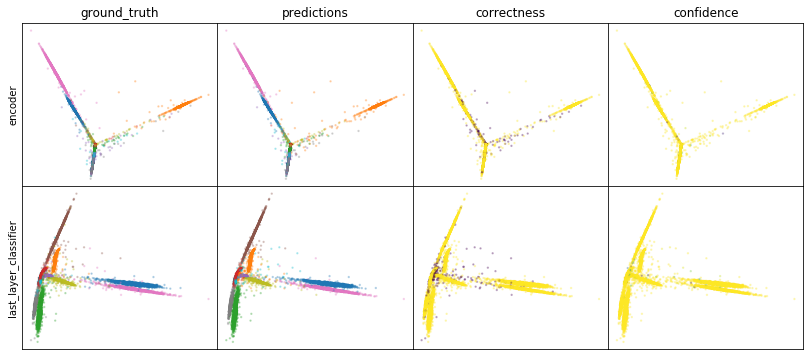

W0808 05:34:12.803473 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:34:13.370718 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:34:13.906383 139838875297536 legend.py:1282] No handles with labels found to put in legend.


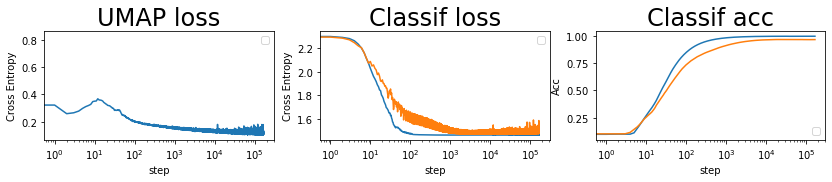

batch: 168000 | train acc: 0.9995 | val acc: 0.9685
leaving epoch because no improvement in 10000 batches


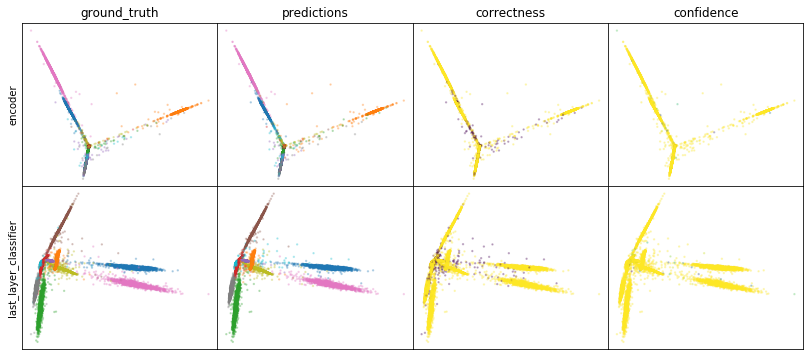

W0808 05:36:51.242709 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:36:51.813929 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:36:52.360374 139838875297536 legend.py:1282] No handles with labels found to put in legend.


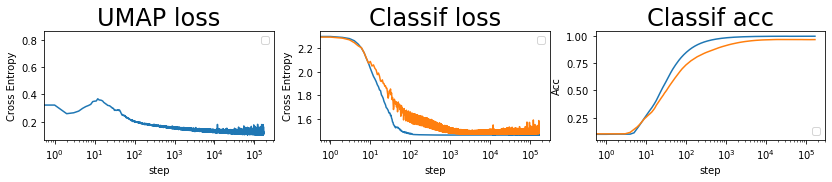

batch: 169000 | train acc: 0.9995 | val acc: 0.9685


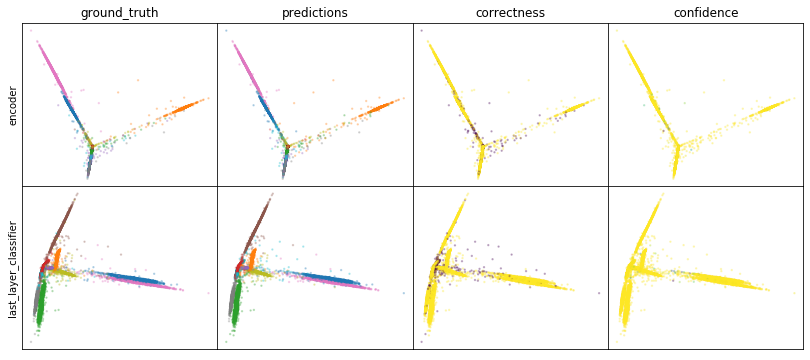

W0808 05:40:30.984045 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:40:31.553697 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:40:32.093255 139838875297536 legend.py:1282] No handles with labels found to put in legend.


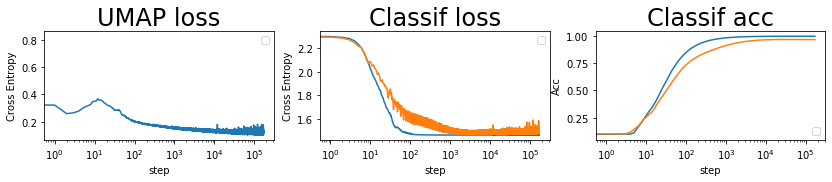

batch: 170000 | train acc: 0.9995 | val acc: 0.9686


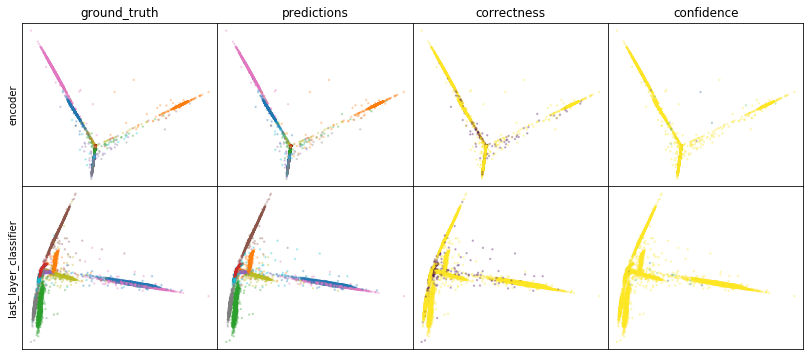

W0808 05:43:10.424662 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:43:11.003325 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:43:11.551642 139838875297536 legend.py:1282] No handles with labels found to put in legend.


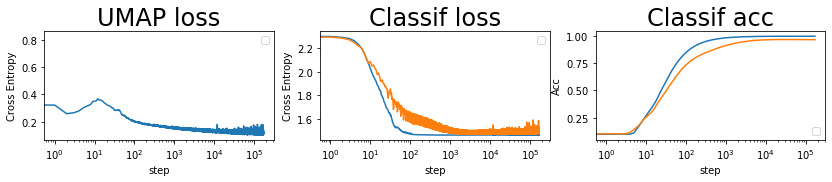

batch: 171000 | train acc: 0.9995 | val acc: 0.9686


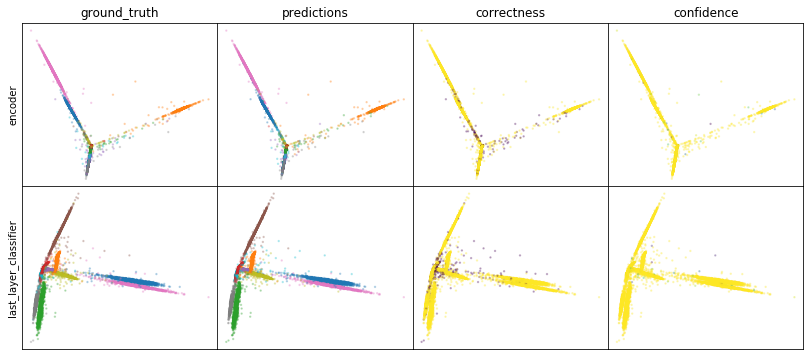

W0808 05:46:41.616159 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:46:42.215911 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:46:42.770306 139838875297536 legend.py:1282] No handles with labels found to put in legend.


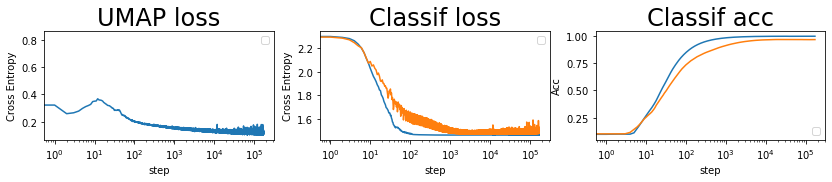

batch: 172000 | train acc: 0.9995 | val acc: 0.9686


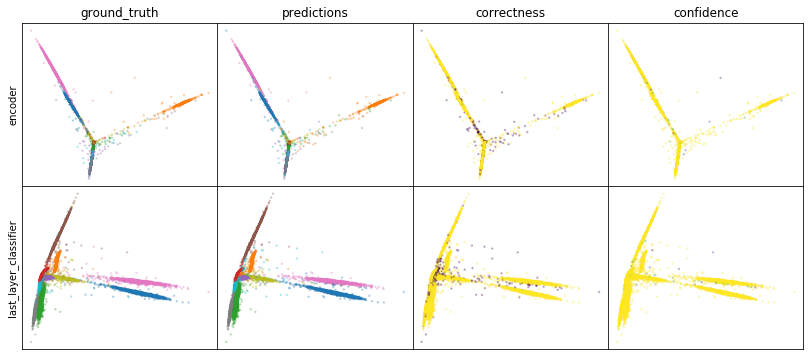

W0808 05:49:21.810524 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:49:22.397260 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:49:22.954728 139838875297536 legend.py:1282] No handles with labels found to put in legend.


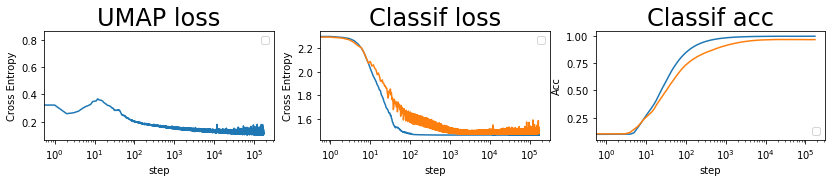

batch: 173000 | train acc: 0.9995 | val acc: 0.9686


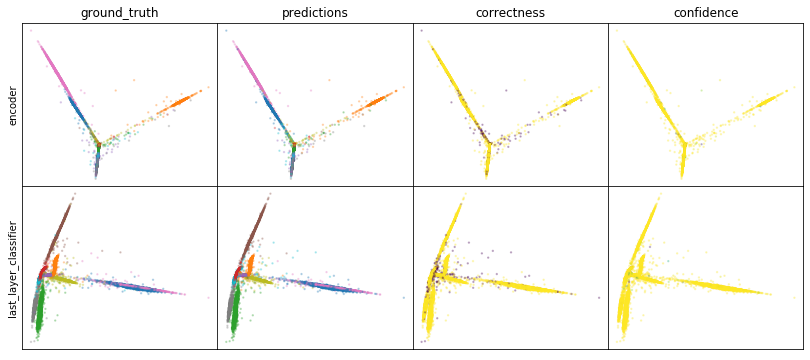

W0808 05:52:03.060057 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:52:03.652718 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:52:04.214175 139838875297536 legend.py:1282] No handles with labels found to put in legend.


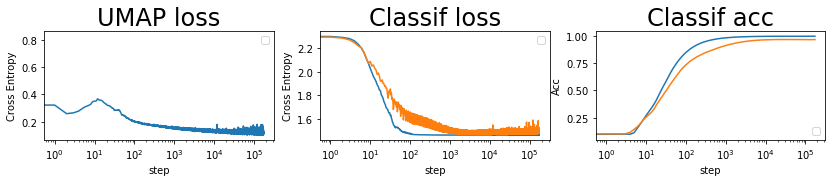

batch: 174000 | train acc: 0.9995 | val acc: 0.9686


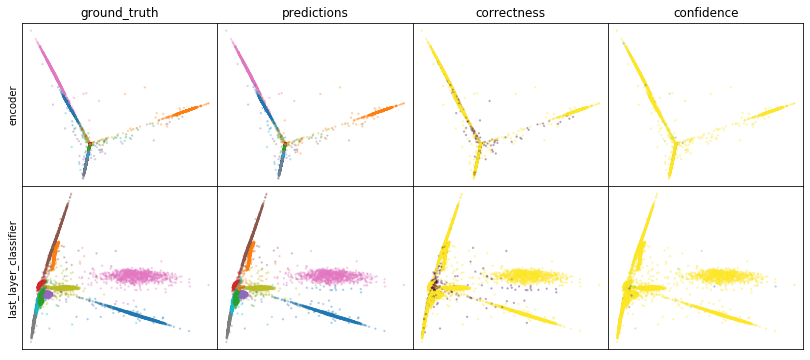

W0808 05:55:11.821068 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:55:12.419035 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:55:12.987062 139838875297536 legend.py:1282] No handles with labels found to put in legend.


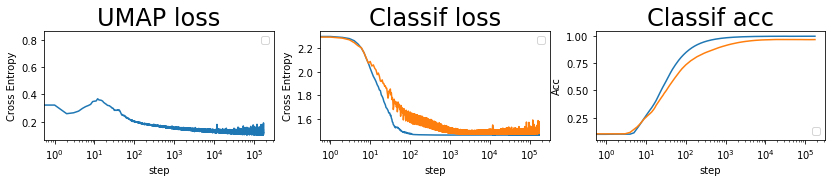

batch: 175000 | train acc: 0.9995 | val acc: 0.9686


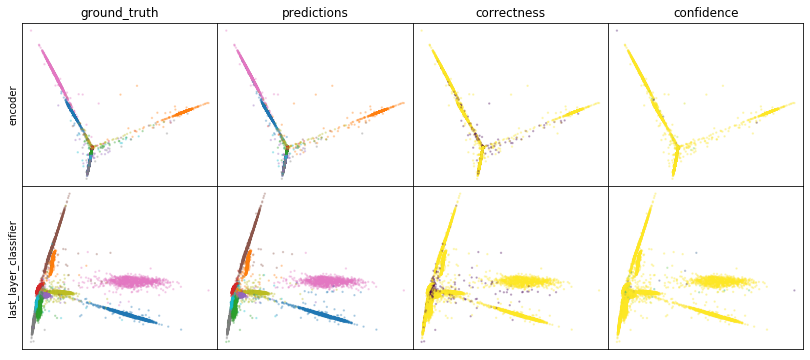

W0808 05:57:52.444231 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:57:53.051472 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 05:57:53.625650 139838875297536 legend.py:1282] No handles with labels found to put in legend.


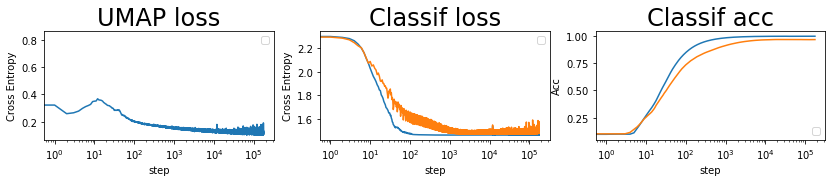

batch: 176000 | train acc: 0.9995 | val acc: 0.9686


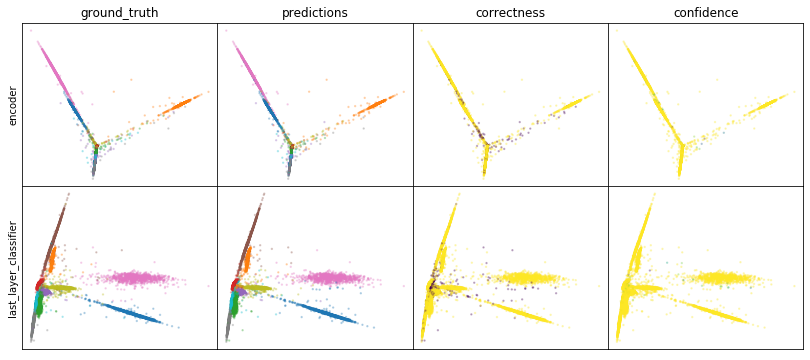

W0808 06:01:10.775144 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:01:11.396251 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:01:11.971246 139838875297536 legend.py:1282] No handles with labels found to put in legend.


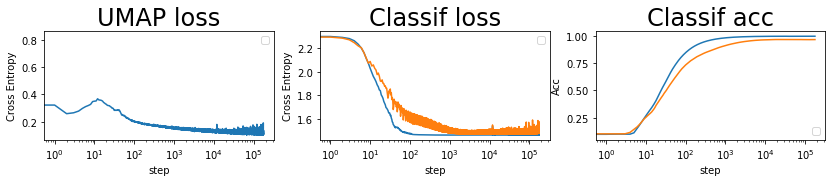

batch: 177000 | train acc: 0.9995 | val acc: 0.9686


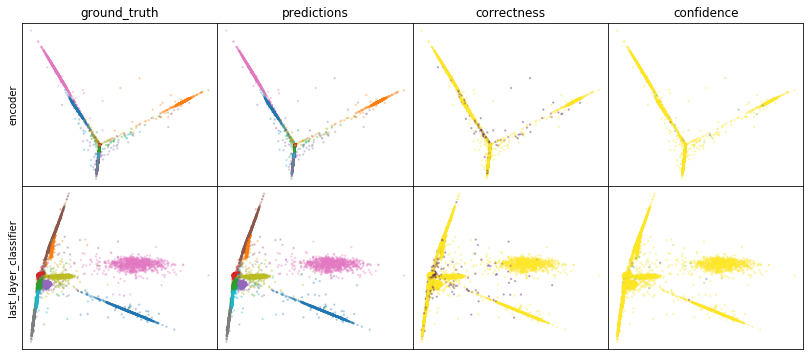

W0808 06:03:52.533032 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:03:53.134816 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:03:53.705096 139838875297536 legend.py:1282] No handles with labels found to put in legend.


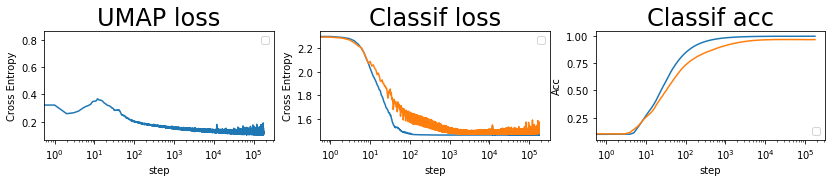

batch: 178000 | train acc: 0.9995 | val acc: 0.9687
leaving epoch because no improvement in 10000 batches


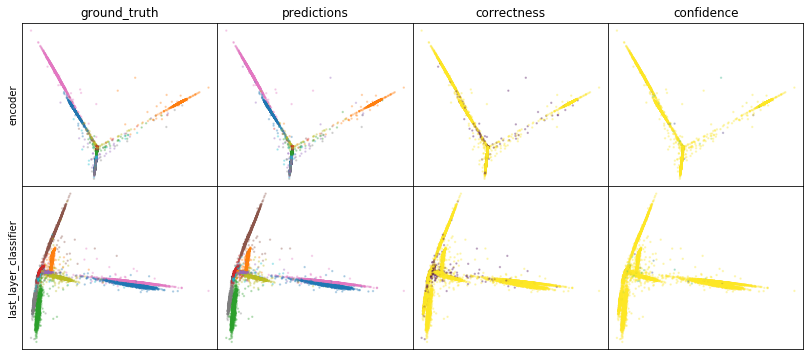

W0808 06:07:06.806120 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:07:07.403141 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:07:07.972493 139838875297536 legend.py:1282] No handles with labels found to put in legend.


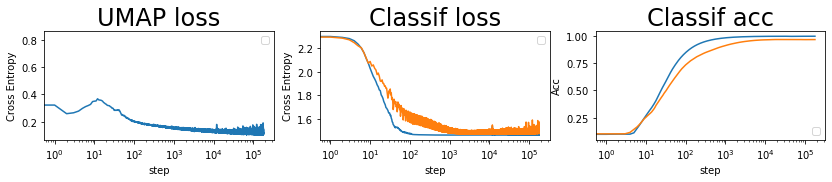

batch: 179000 | train acc: 0.9995 | val acc: 0.9687


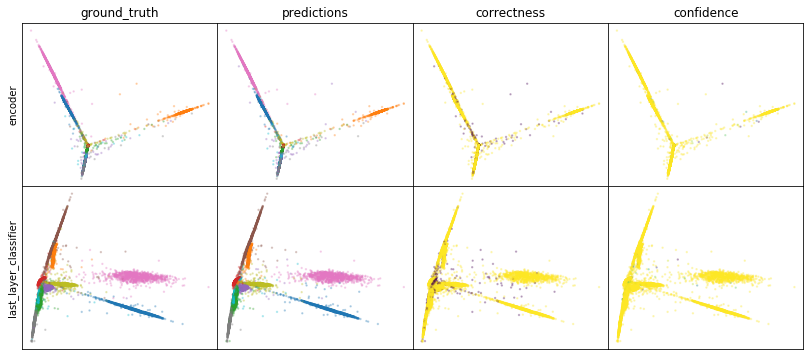

W0808 06:09:51.358158 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:09:51.962651 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:09:52.536207 139838875297536 legend.py:1282] No handles with labels found to put in legend.


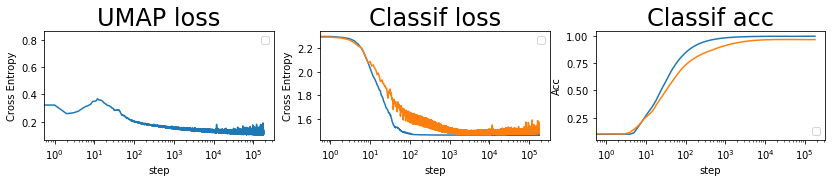

batch: 180000 | train acc: 0.9995 | val acc: 0.9688


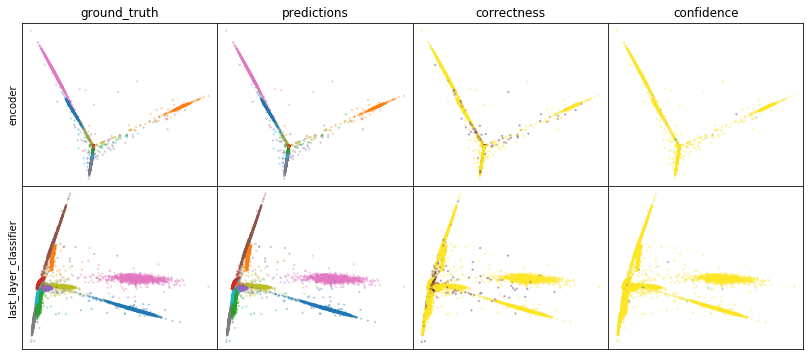

W0808 06:12:37.048521 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:12:37.658964 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:12:38.256430 139838875297536 legend.py:1282] No handles with labels found to put in legend.


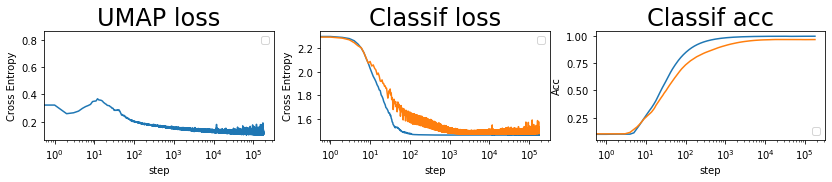

batch: 181000 | train acc: 0.9995 | val acc: 0.9688


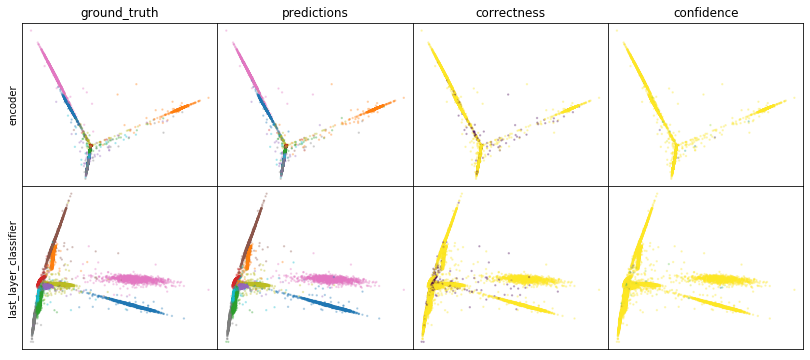

W0808 06:15:46.215324 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:15:46.835468 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:15:47.422752 139838875297536 legend.py:1282] No handles with labels found to put in legend.


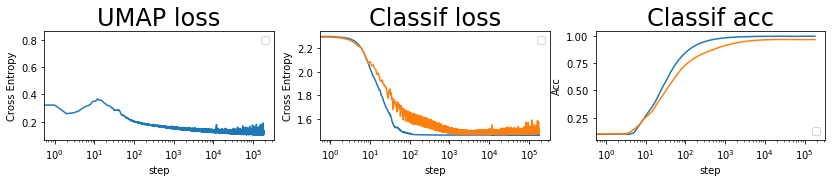

batch: 182000 | train acc: 0.9995 | val acc: 0.9688


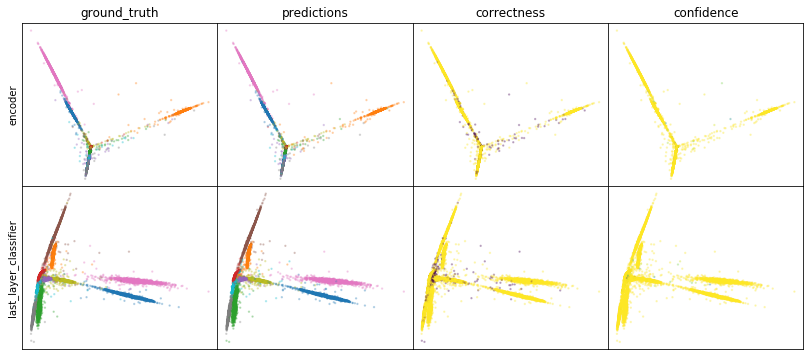

W0808 06:18:31.095254 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:18:31.703928 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:18:32.282021 139838875297536 legend.py:1282] No handles with labels found to put in legend.


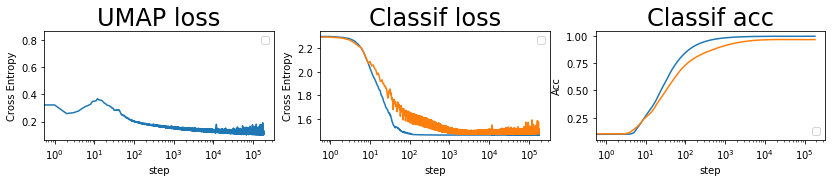

batch: 183000 | train acc: 0.9995 | val acc: 0.9689


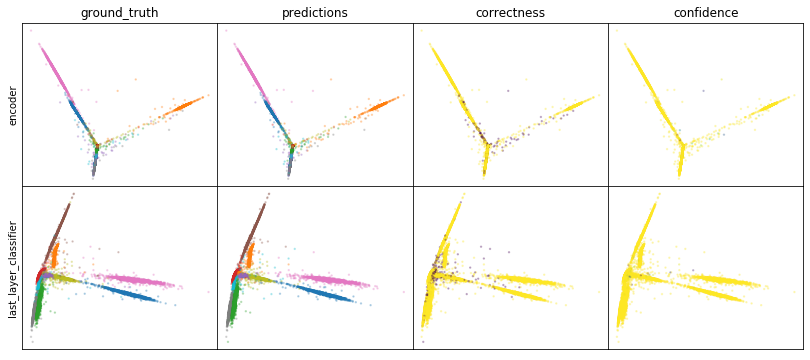

W0808 06:22:17.892127 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:22:18.504967 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:22:19.091029 139838875297536 legend.py:1282] No handles with labels found to put in legend.


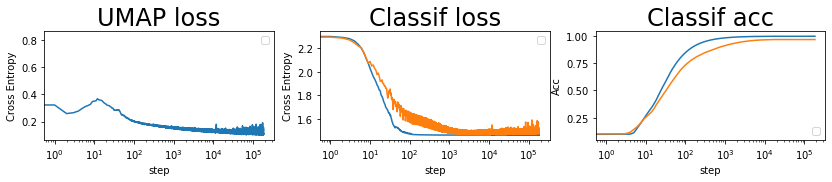

batch: 184000 | train acc: 0.9995 | val acc: 0.9689


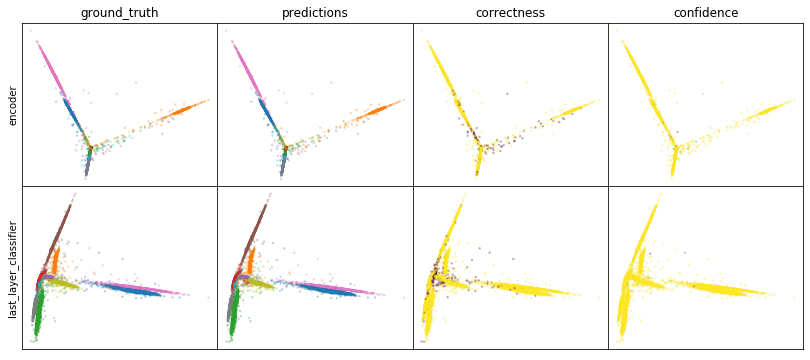

W0808 06:25:03.754751 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:25:04.375454 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:25:04.977256 139838875297536 legend.py:1282] No handles with labels found to put in legend.


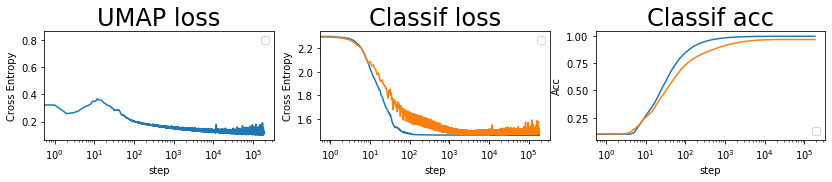

batch: 185000 | train acc: 0.9995 | val acc: 0.969


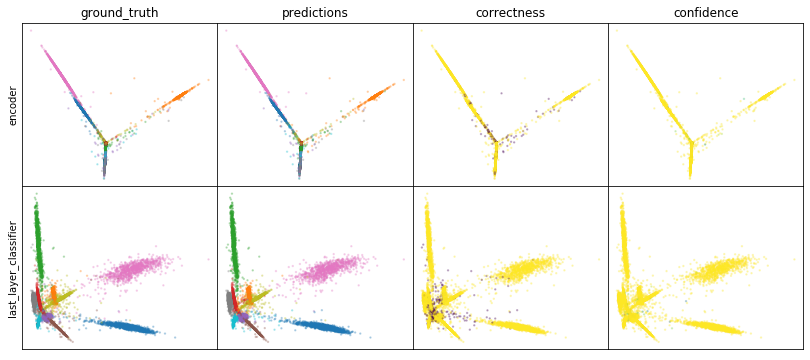

W0808 06:28:39.615159 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:28:40.231338 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:28:40.816075 139838875297536 legend.py:1282] No handles with labels found to put in legend.


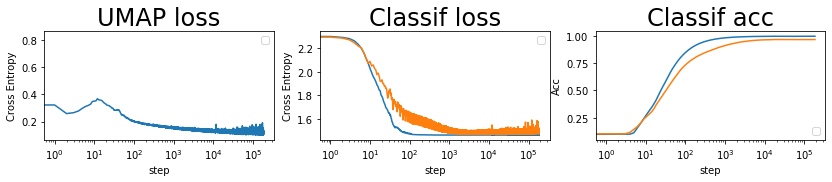

batch: 186000 | train acc: 0.9995 | val acc: 0.969


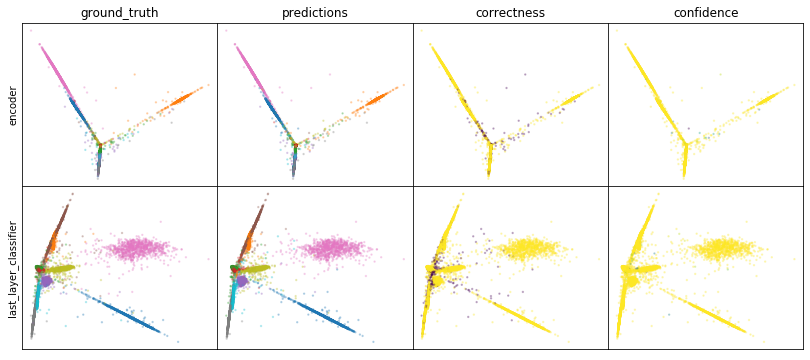

W0808 06:31:26.667794 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:31:27.282155 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:31:27.867887 139838875297536 legend.py:1282] No handles with labels found to put in legend.


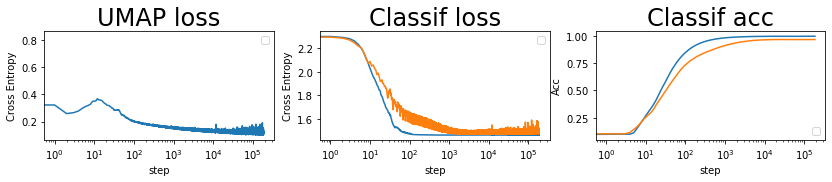

batch: 187000 | train acc: 0.9995 | val acc: 0.9691


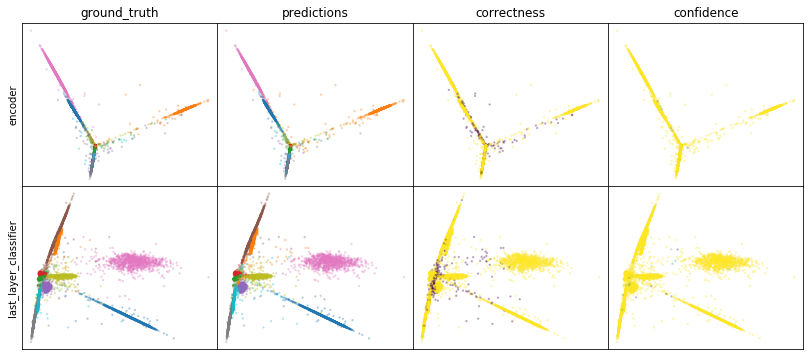

W0808 06:34:14.067479 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:34:14.693290 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:34:15.290228 139838875297536 legend.py:1282] No handles with labels found to put in legend.


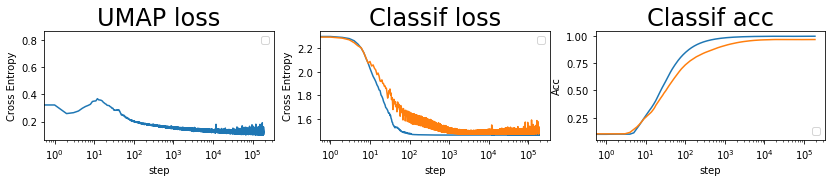

batch: 188000 | train acc: 0.9995 | val acc: 0.9691
leaving epoch because no improvement in 10000 batches


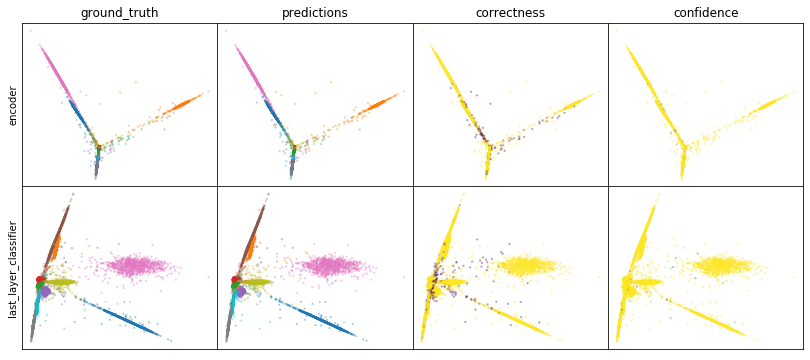

W0808 06:37:22.360227 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:37:22.979851 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:37:23.581995 139838875297536 legend.py:1282] No handles with labels found to put in legend.


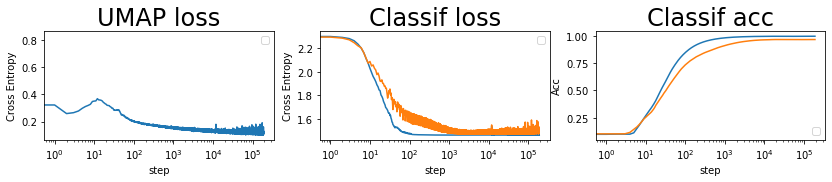

batch: 189000 | train acc: 0.9995 | val acc: 0.9691


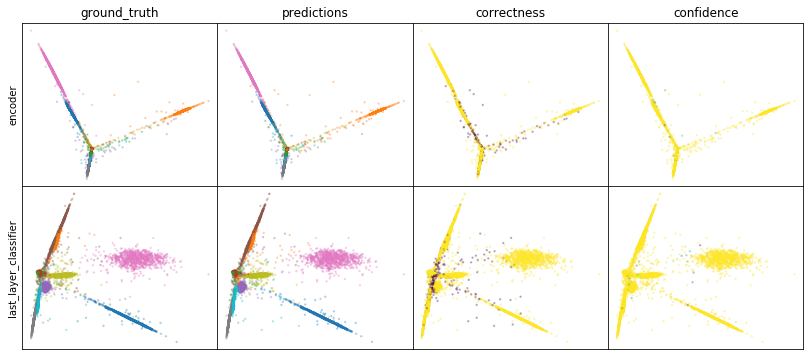

W0808 06:40:10.259488 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:40:10.893568 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:40:11.497443 139838875297536 legend.py:1282] No handles with labels found to put in legend.


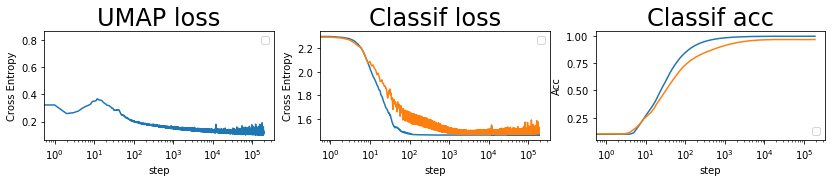

batch: 190000 | train acc: 0.9995 | val acc: 0.9691


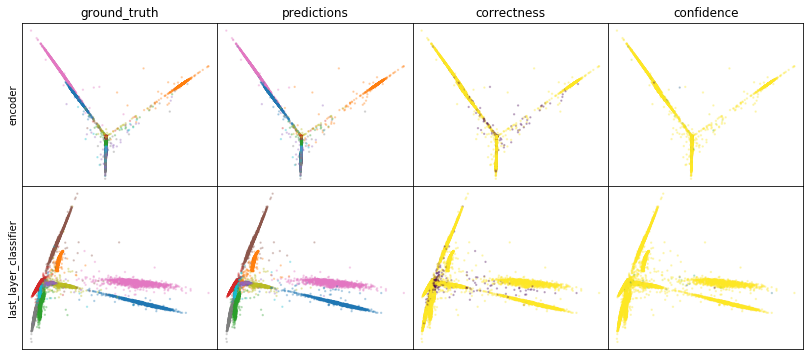

W0808 06:43:31.085800 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:43:31.729415 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:43:32.336085 139838875297536 legend.py:1282] No handles with labels found to put in legend.


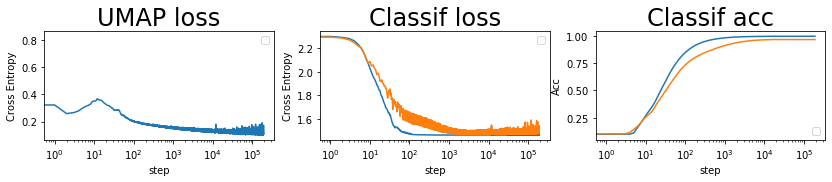

batch: 191000 | train acc: 0.9995 | val acc: 0.9691


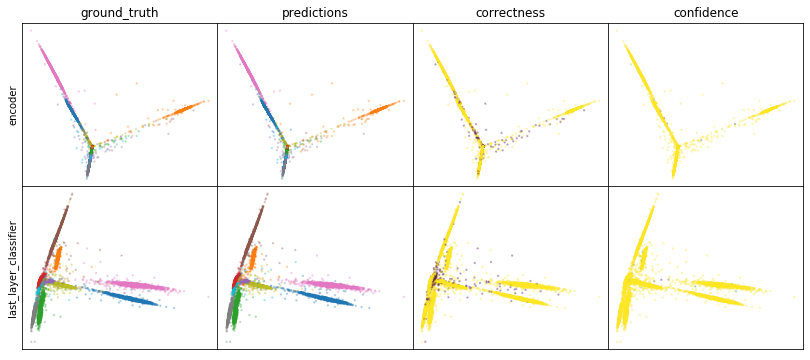

W0808 06:46:20.186002 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:46:20.817839 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:46:21.416075 139838875297536 legend.py:1282] No handles with labels found to put in legend.


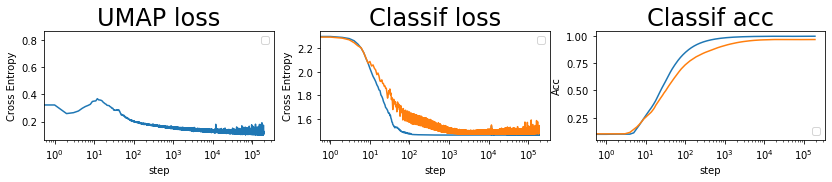

batch: 192000 | train acc: 0.9995 | val acc: 0.9691


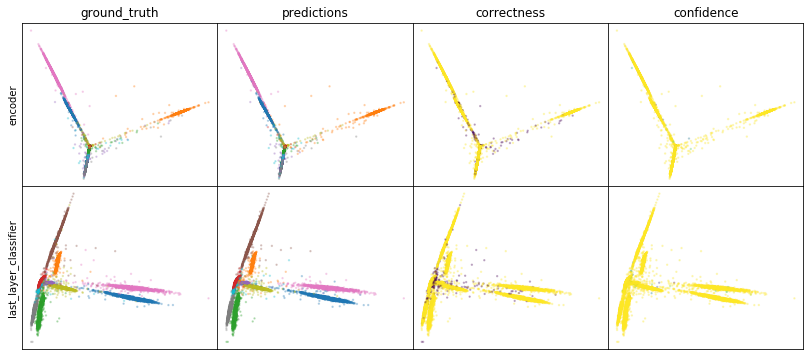

W0808 06:49:18.704853 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:49:19.360263 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:49:19.969046 139838875297536 legend.py:1282] No handles with labels found to put in legend.


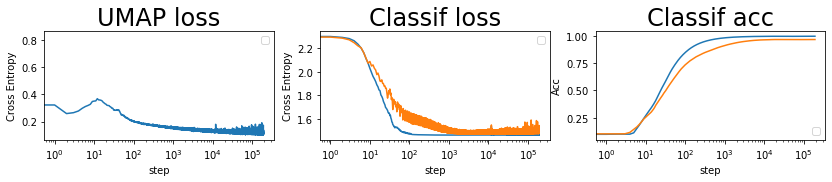

batch: 193000 | train acc: 0.9995 | val acc: 0.9692


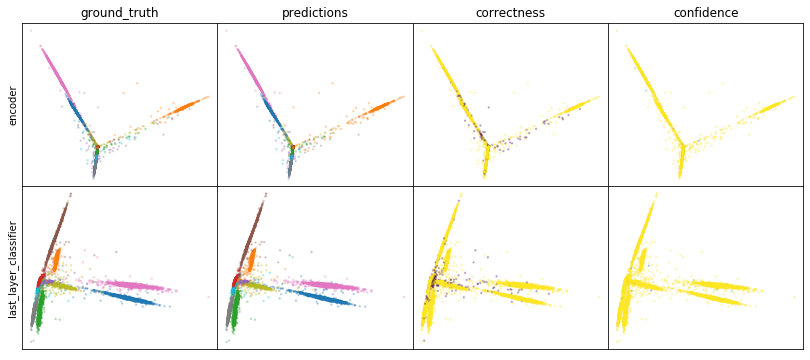

W0808 06:52:21.023131 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:52:21.700993 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:52:22.355438 139838875297536 legend.py:1282] No handles with labels found to put in legend.


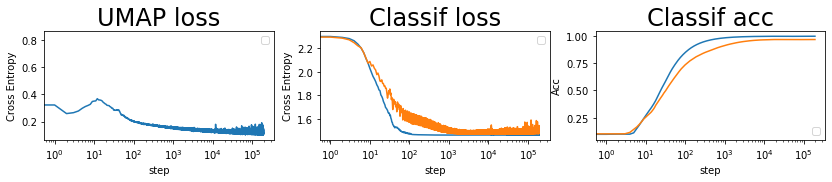

batch: 194000 | train acc: 0.9995 | val acc: 0.9692


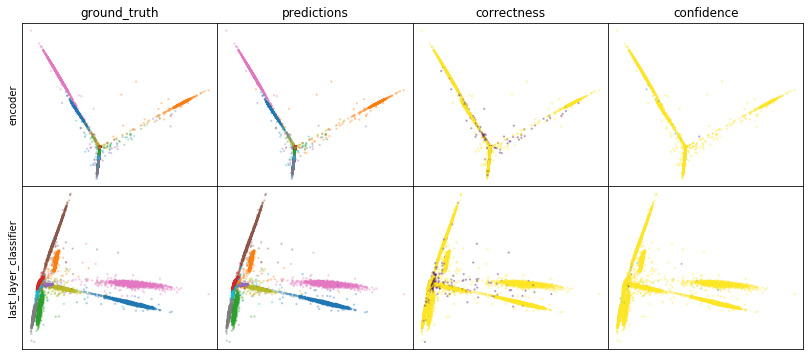

W0808 06:55:11.070583 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:55:11.722010 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:55:12.354133 139838875297536 legend.py:1282] No handles with labels found to put in legend.


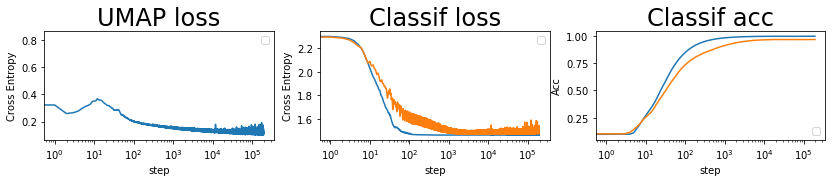

batch: 195000 | train acc: 0.9995 | val acc: 0.9692


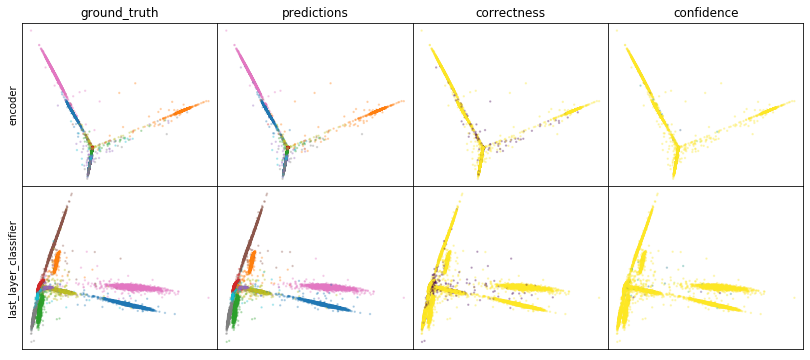

W0808 06:58:33.036884 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:58:33.681511 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 06:58:34.291713 139838875297536 legend.py:1282] No handles with labels found to put in legend.


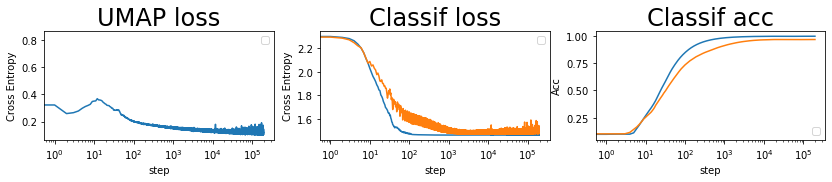

batch: 196000 | train acc: 0.9996 | val acc: 0.9693


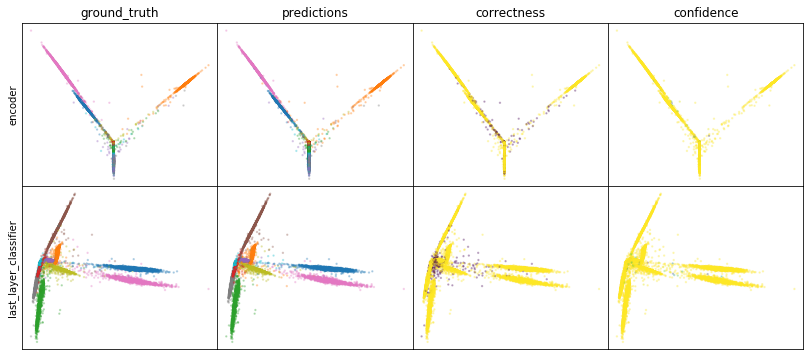

W0808 07:01:26.287821 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:01:26.948491 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:01:27.582408 139838875297536 legend.py:1282] No handles with labels found to put in legend.


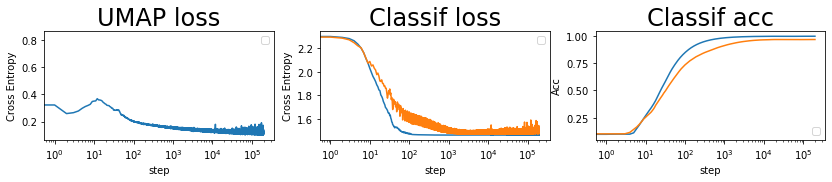

batch: 197000 | train acc: 0.9996 | val acc: 0.9693


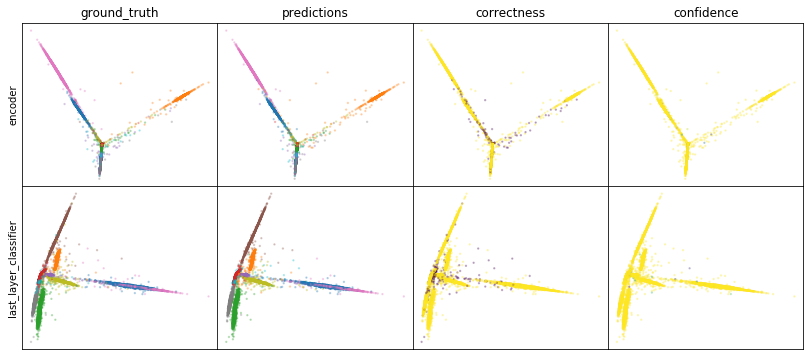

W0808 07:05:17.375874 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:05:18.024269 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:05:18.642508 139838875297536 legend.py:1282] No handles with labels found to put in legend.


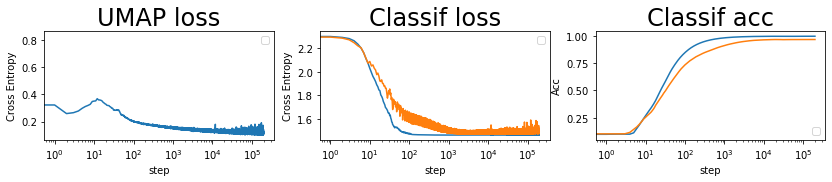

batch: 198000 | train acc: 0.9996 | val acc: 0.9693


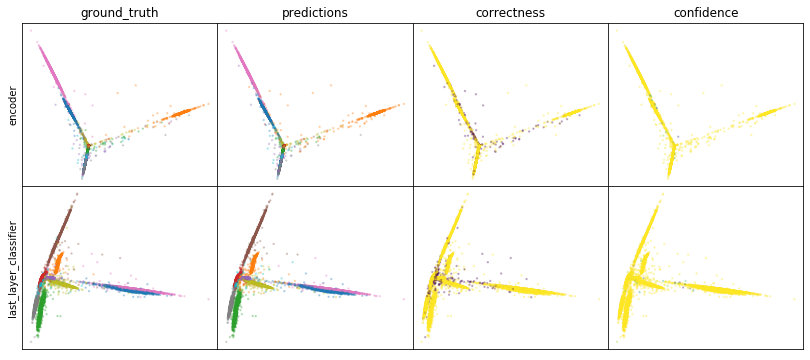

W0808 07:08:07.377873 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:08:08.038039 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:08:08.660648 139838875297536 legend.py:1282] No handles with labels found to put in legend.


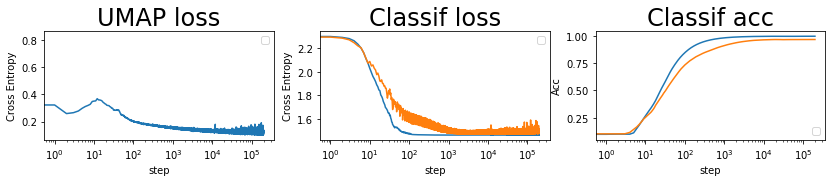

batch: 199000 | train acc: 0.9996 | val acc: 0.9694


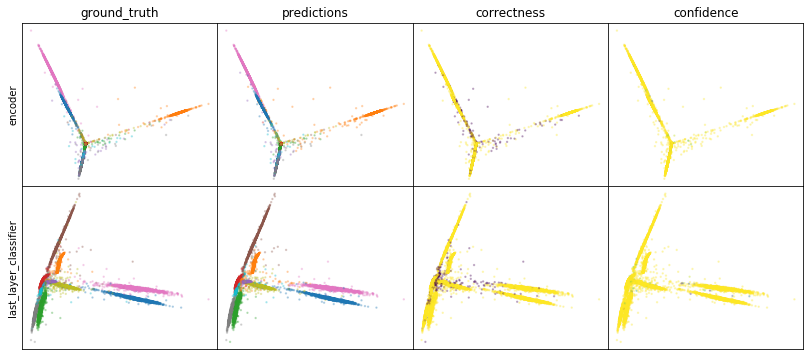

W0808 07:11:53.932222 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:11:54.585409 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:11:55.216378 139838875297536 legend.py:1282] No handles with labels found to put in legend.


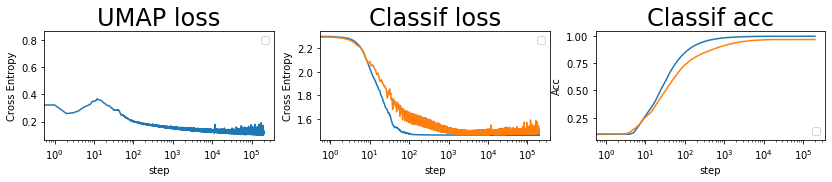

batch: 200000 | train acc: 0.9996 | val acc: 0.9694


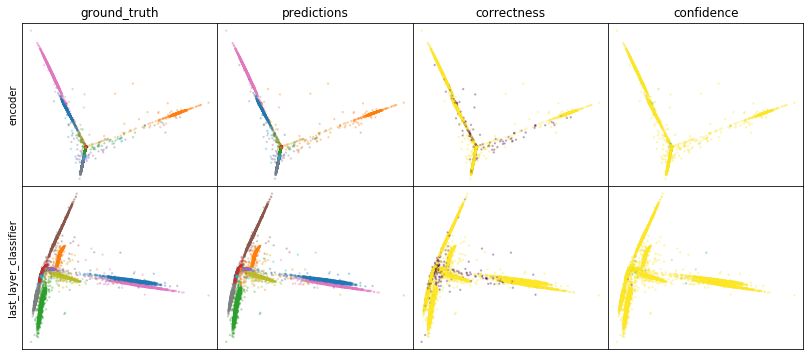

W0808 07:14:45.023511 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:14:45.684429 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:14:46.310039 139838875297536 legend.py:1282] No handles with labels found to put in legend.


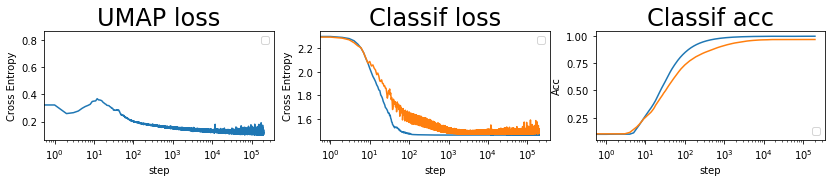

batch: 201000 | train acc: 0.9996 | val acc: 0.9694


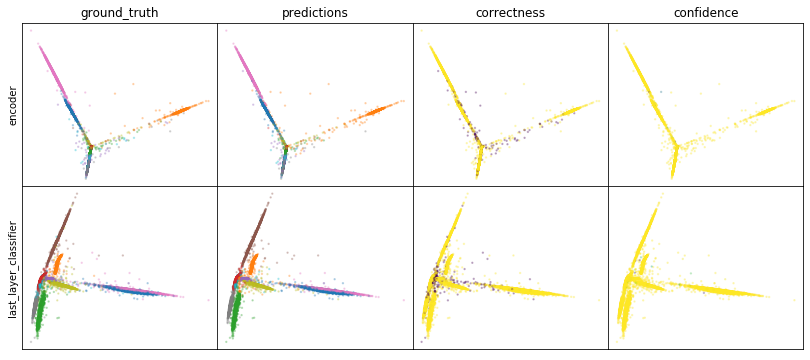

W0808 07:17:48.146728 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:17:48.850105 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:17:49.523425 139838875297536 legend.py:1282] No handles with labels found to put in legend.


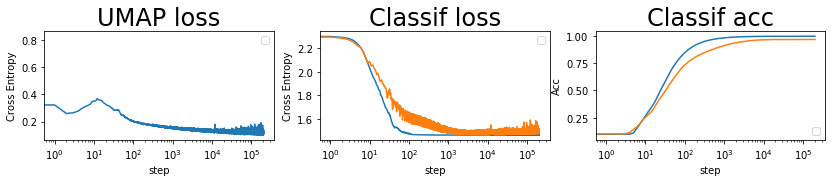

batch: 202000 | train acc: 0.9996 | val acc: 0.9694


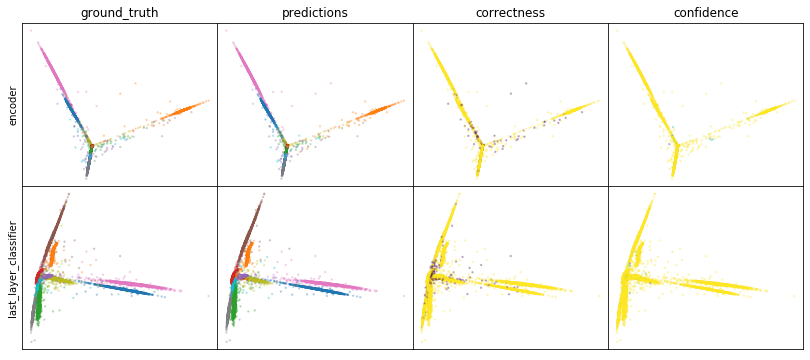

W0808 07:20:46.153309 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:20:46.850485 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:20:47.504877 139838875297536 legend.py:1282] No handles with labels found to put in legend.


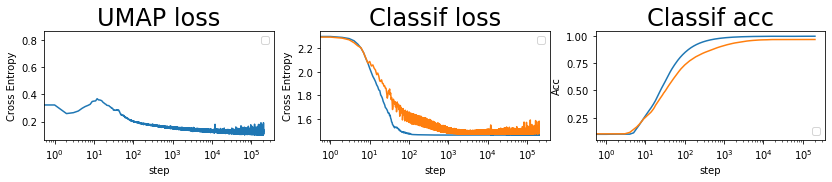

batch: 203000 | train acc: 0.9996 | val acc: 0.9695


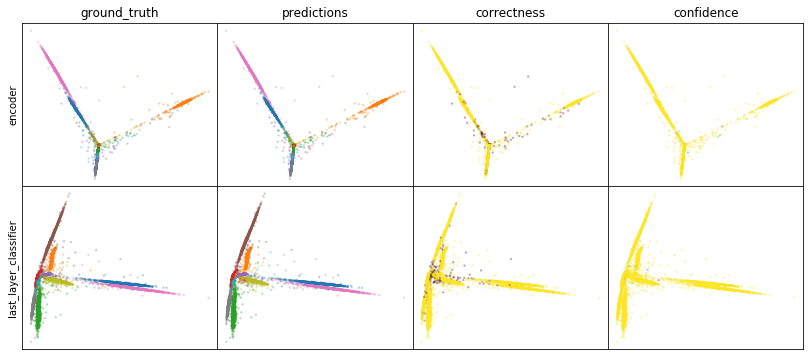

W0808 07:23:40.851966 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:23:41.558997 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:23:42.237732 139838875297536 legend.py:1282] No handles with labels found to put in legend.


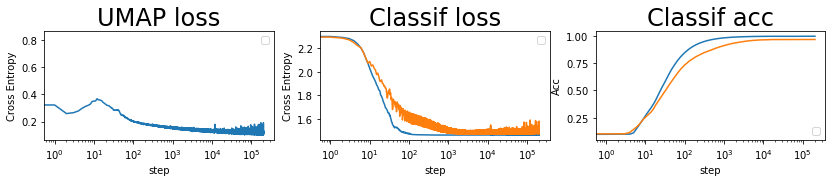

batch: 204000 | train acc: 0.9996 | val acc: 0.9695


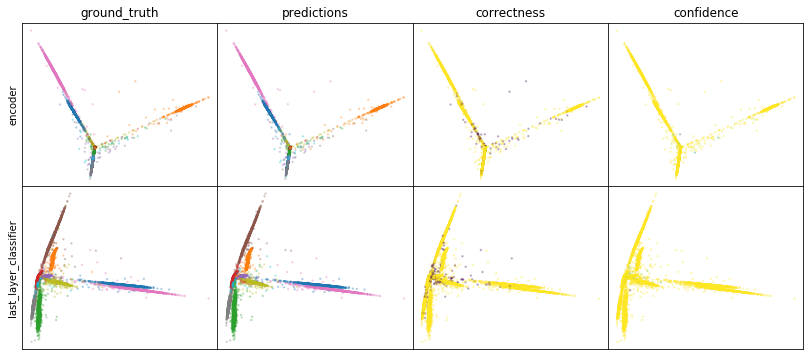

W0808 07:26:57.652851 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:26:58.352919 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:26:59.011317 139838875297536 legend.py:1282] No handles with labels found to put in legend.


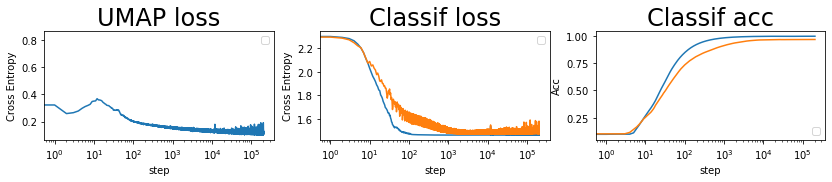

batch: 205000 | train acc: 0.9996 | val acc: 0.9696


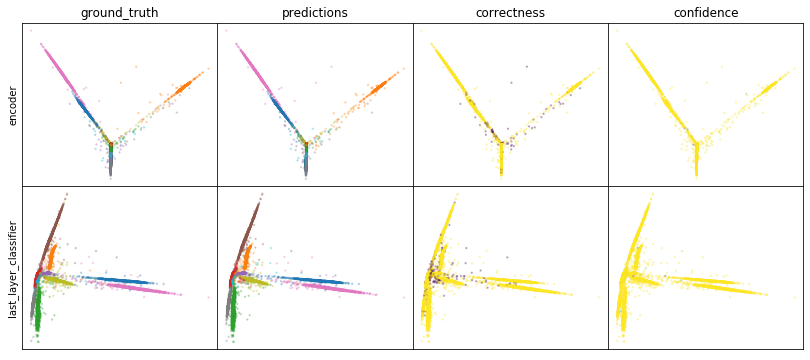

W0808 07:29:52.320708 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:29:53.047406 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:29:53.733117 139838875297536 legend.py:1282] No handles with labels found to put in legend.


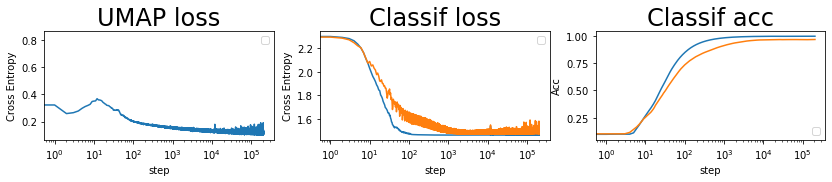

batch: 206000 | train acc: 0.9996 | val acc: 0.9696


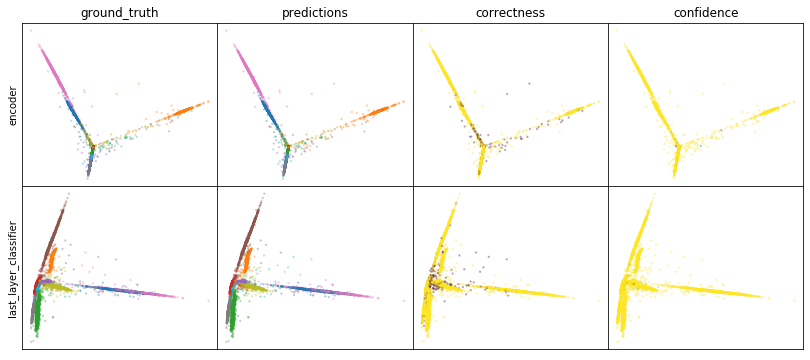

W0808 07:33:50.779836 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:33:51.492432 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:33:52.165073 139838875297536 legend.py:1282] No handles with labels found to put in legend.


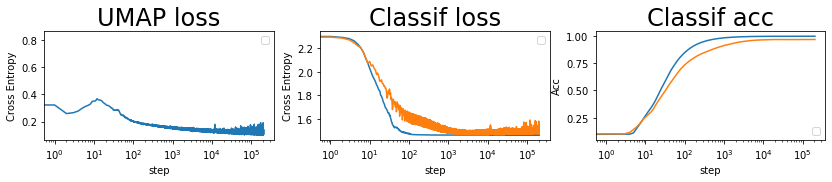

batch: 207000 | train acc: 0.9996 | val acc: 0.9696


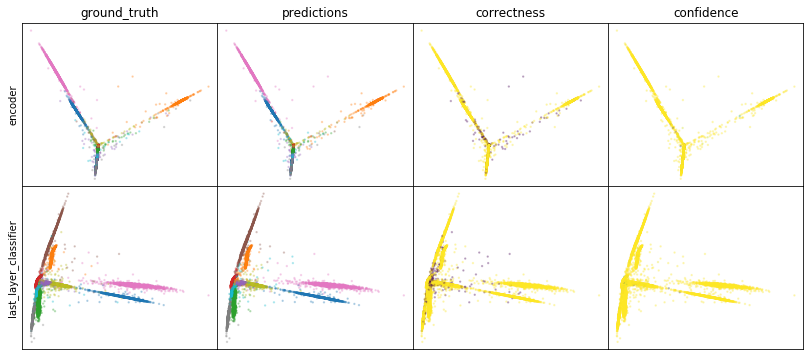

W0808 07:36:44.676811 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:36:45.397260 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:36:46.067935 139838875297536 legend.py:1282] No handles with labels found to put in legend.


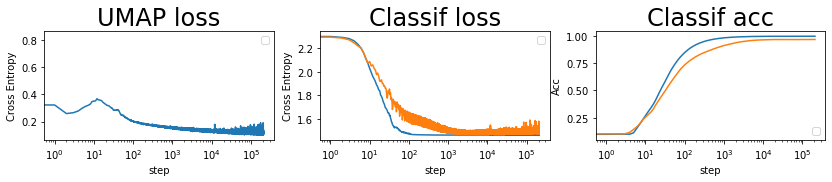

batch: 208000 | train acc: 0.9996 | val acc: 0.9697


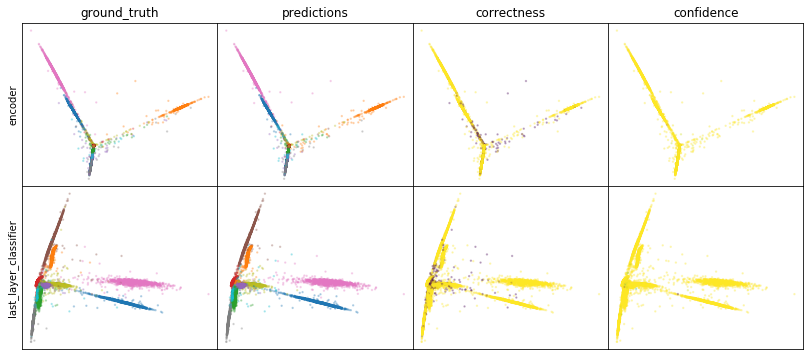

W0808 07:40:38.764602 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:40:39.495216 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:40:40.183153 139838875297536 legend.py:1282] No handles with labels found to put in legend.


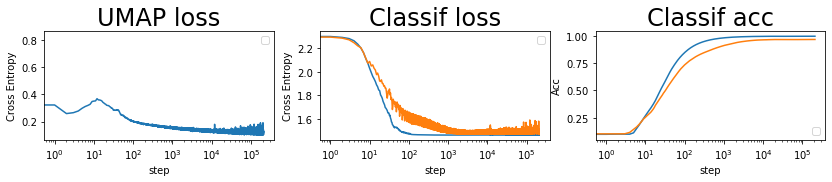

batch: 209000 | train acc: 0.9996 | val acc: 0.9697


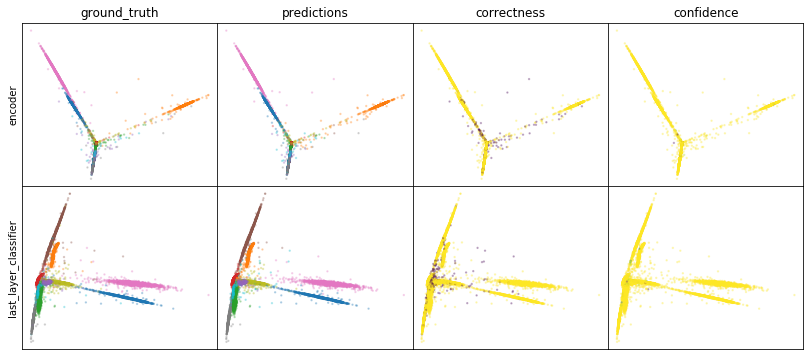

W0808 07:43:33.976986 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:43:34.695613 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:43:35.387285 139838875297536 legend.py:1282] No handles with labels found to put in legend.


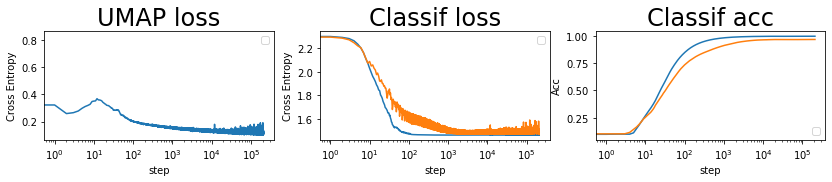

batch: 210000 | train acc: 0.9996 | val acc: 0.9697


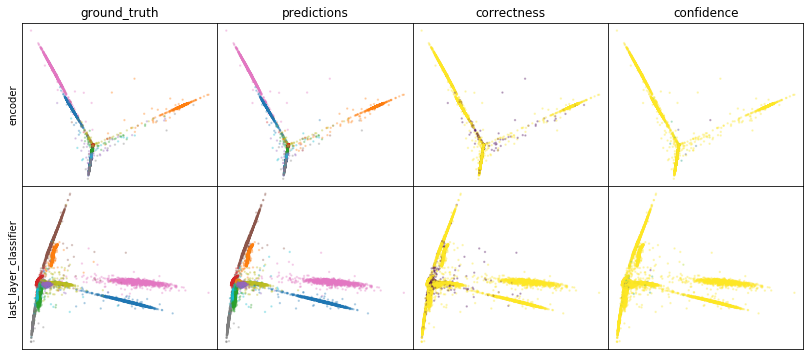

W0808 07:47:05.869548 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:47:06.601543 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:47:07.292018 139838875297536 legend.py:1282] No handles with labels found to put in legend.


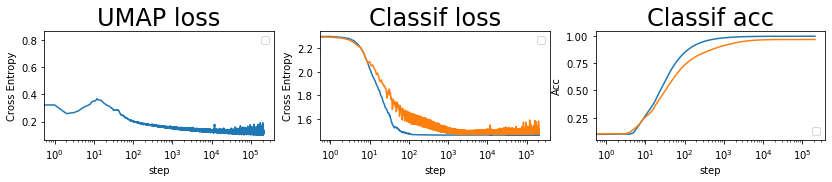

batch: 211000 | train acc: 0.9996 | val acc: 0.9698


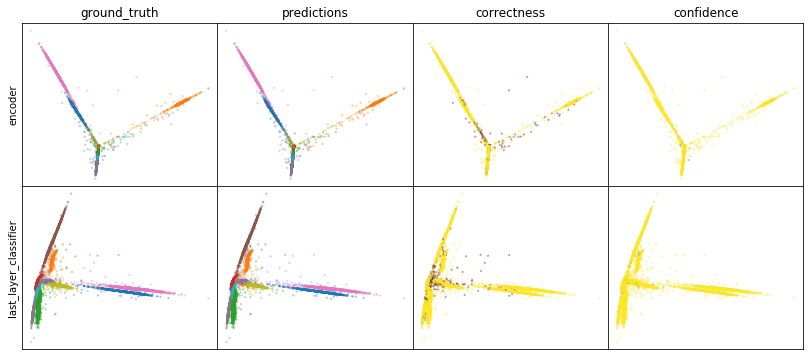

W0808 07:50:02.031990 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:50:02.751118 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:50:03.445438 139838875297536 legend.py:1282] No handles with labels found to put in legend.


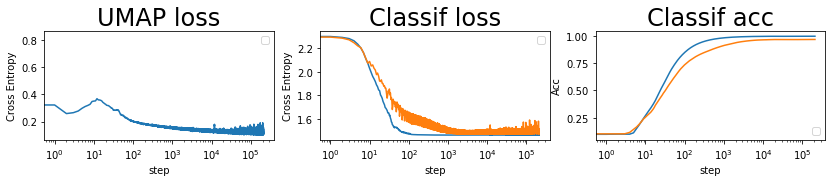

batch: 212000 | train acc: 0.9996 | val acc: 0.9698


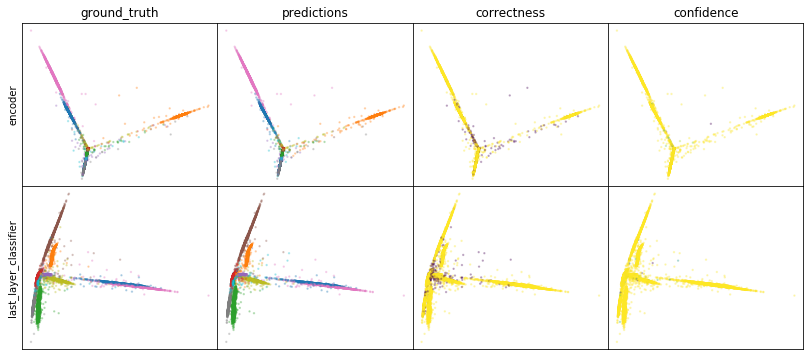

W0808 07:53:21.809985 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:53:22.572115 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:53:23.268452 139838875297536 legend.py:1282] No handles with labels found to put in legend.


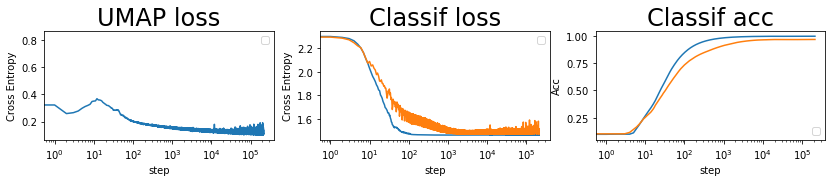

batch: 213000 | train acc: 0.9996 | val acc: 0.9698


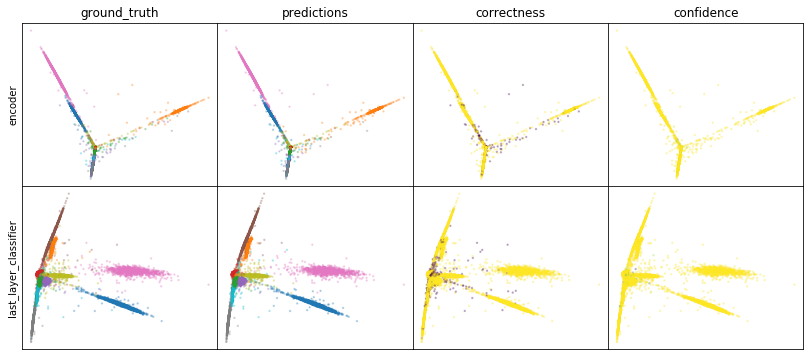

W0808 07:56:31.927465 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:56:32.651568 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:56:33.342376 139838875297536 legend.py:1282] No handles with labels found to put in legend.


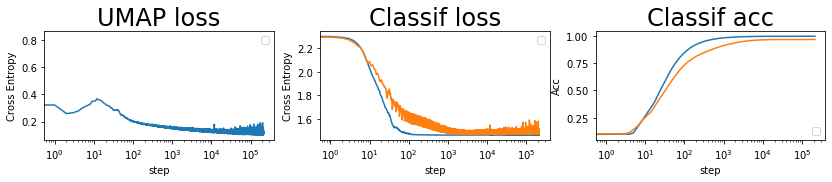

batch: 214000 | train acc: 0.9996 | val acc: 0.9699


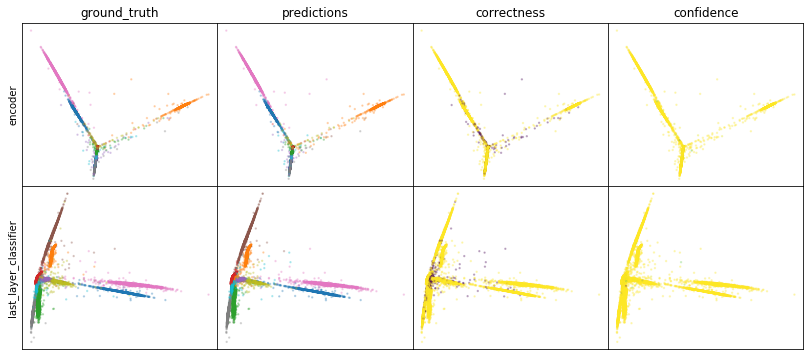

W0808 07:59:29.096847 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:59:29.840530 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 07:59:30.547825 139838875297536 legend.py:1282] No handles with labels found to put in legend.


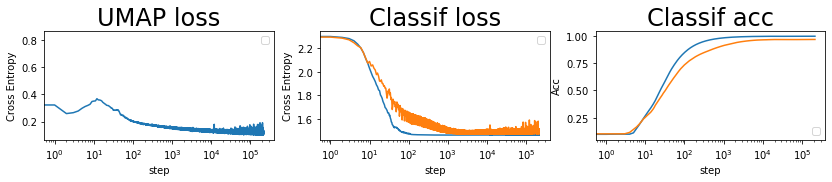

batch: 215000 | train acc: 0.9996 | val acc: 0.9699


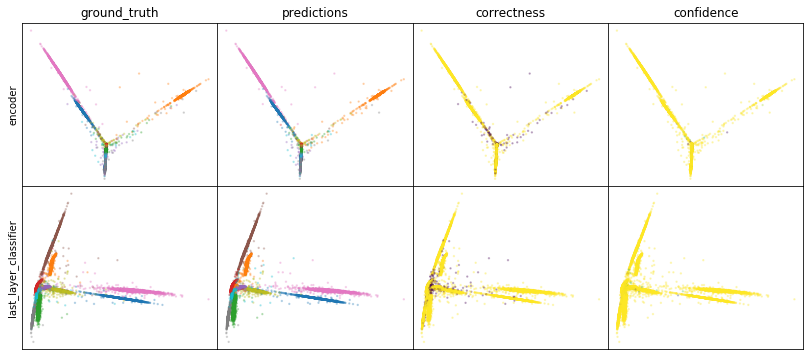

W0808 08:02:57.944973 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:02:58.679801 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:02:59.381718 139838875297536 legend.py:1282] No handles with labels found to put in legend.


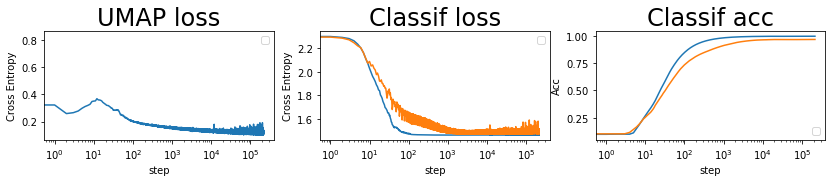

batch: 216000 | train acc: 0.9996 | val acc: 0.9699


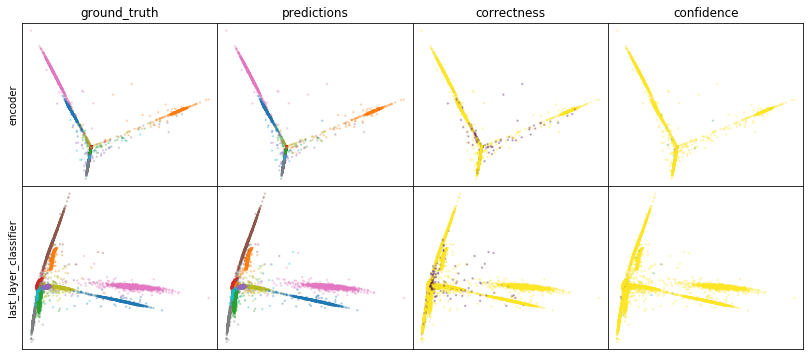

W0808 08:05:58.679374 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:05:59.424549 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:06:00.162548 139838875297536 legend.py:1282] No handles with labels found to put in legend.


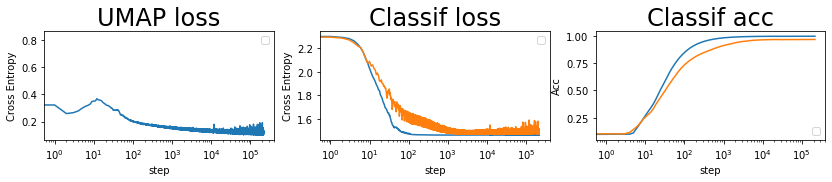

batch: 217000 | train acc: 0.9996 | val acc: 0.97


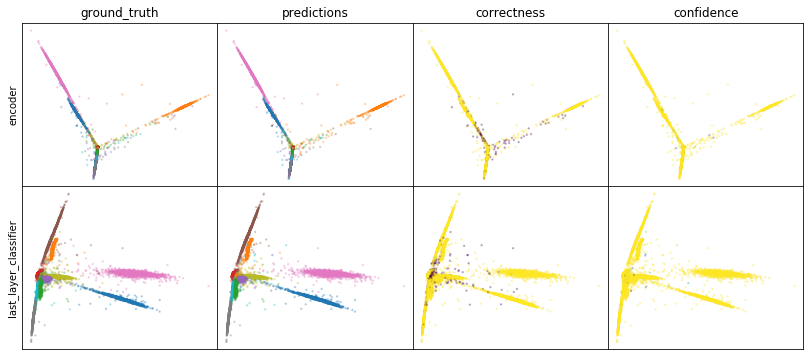

W0808 08:09:30.617376 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:09:31.361238 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:09:32.065492 139838875297536 legend.py:1282] No handles with labels found to put in legend.


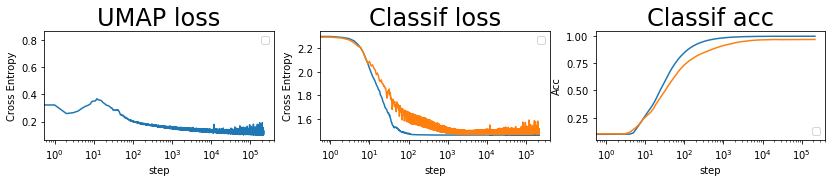

batch: 218000 | train acc: 0.9996 | val acc: 0.97


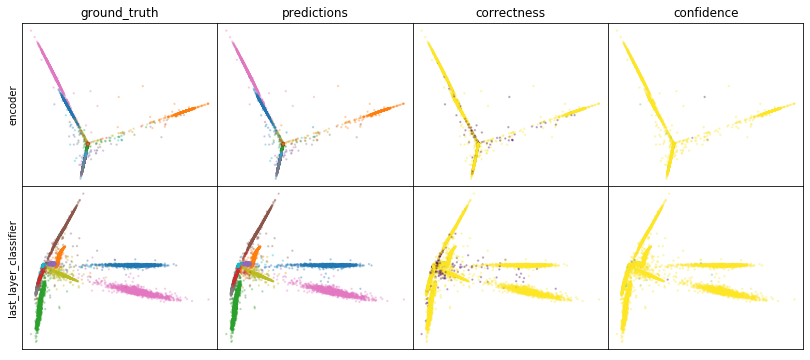

W0808 08:12:30.185301 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:12:30.927291 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:12:31.636521 139838875297536 legend.py:1282] No handles with labels found to put in legend.


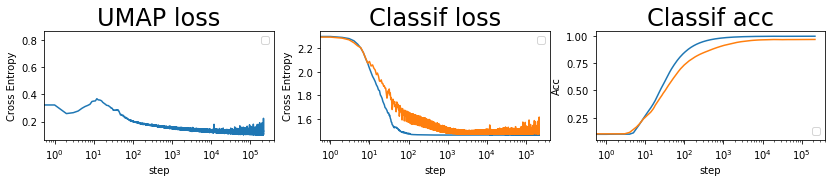

batch: 219000 | train acc: 0.9996 | val acc: 0.97


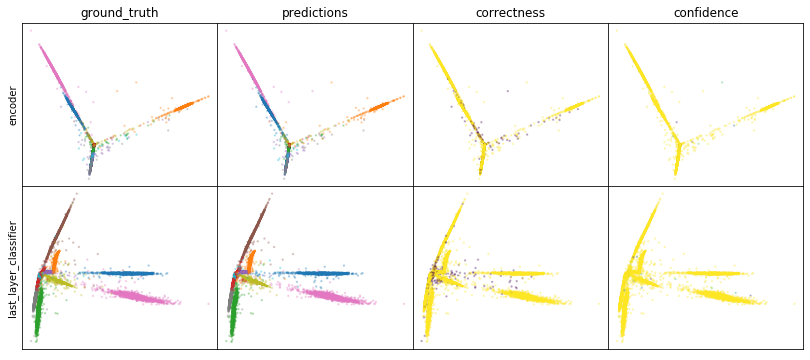

W0808 08:16:28.124091 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:16:28.865342 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:16:29.562287 139838875297536 legend.py:1282] No handles with labels found to put in legend.


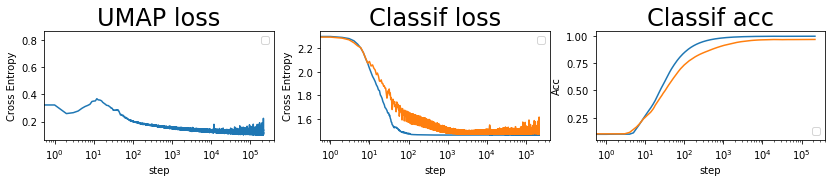

batch: 220000 | train acc: 0.9996 | val acc: 0.97


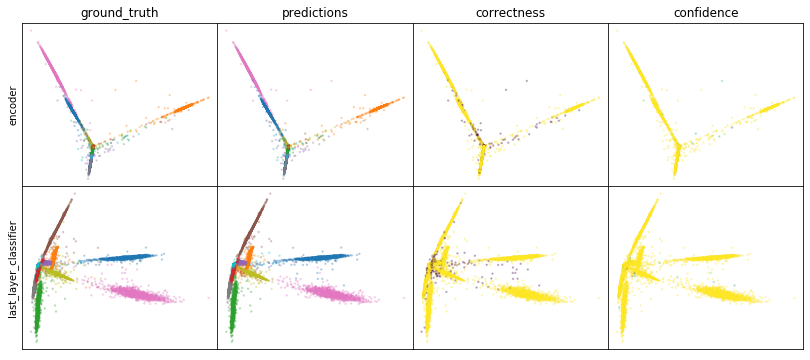

W0808 08:19:29.549844 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:19:30.292841 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:19:30.989950 139838875297536 legend.py:1282] No handles with labels found to put in legend.


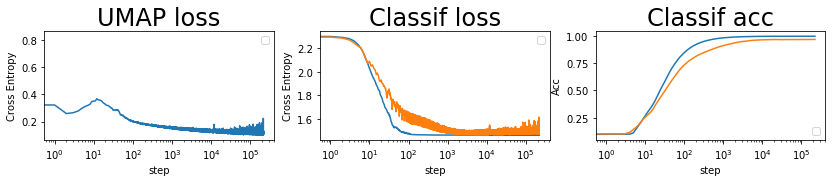

batch: 221000 | train acc: 0.9996 | val acc: 0.9701


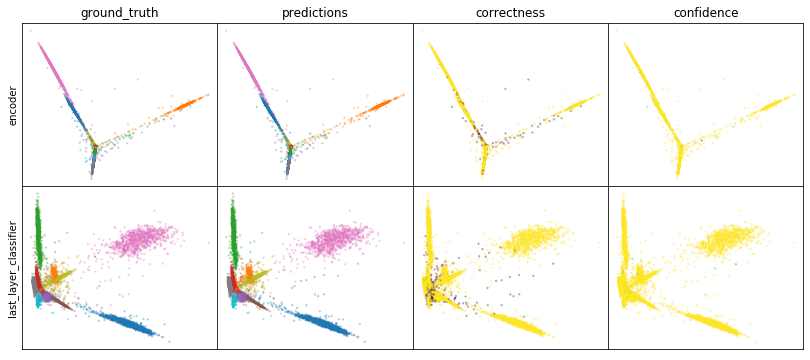

W0808 08:23:19.556368 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:23:20.304005 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:23:21.010099 139838875297536 legend.py:1282] No handles with labels found to put in legend.


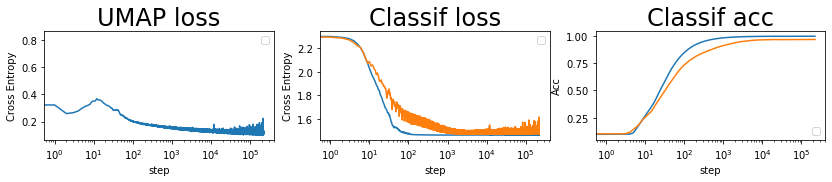

batch: 222000 | train acc: 0.9996 | val acc: 0.9701


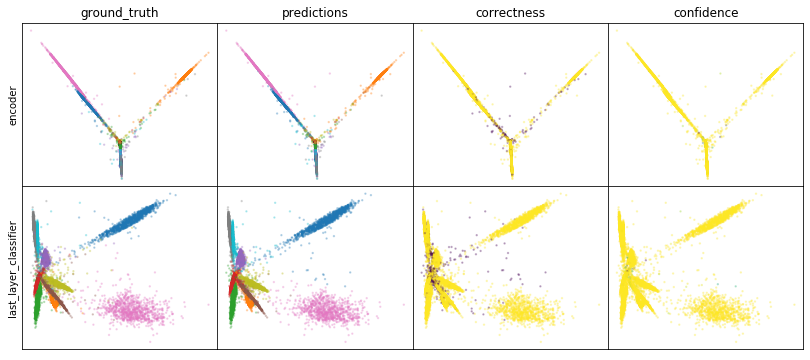

W0808 08:26:21.638332 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:26:22.390814 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:26:23.097336 139838875297536 legend.py:1282] No handles with labels found to put in legend.


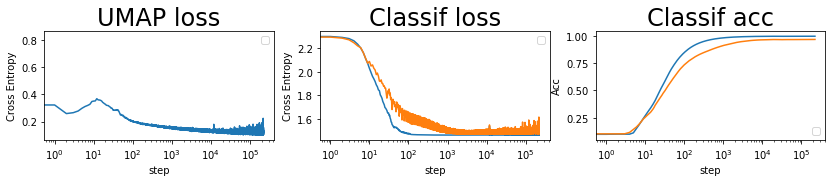

batch: 223000 | train acc: 0.9996 | val acc: 0.9701


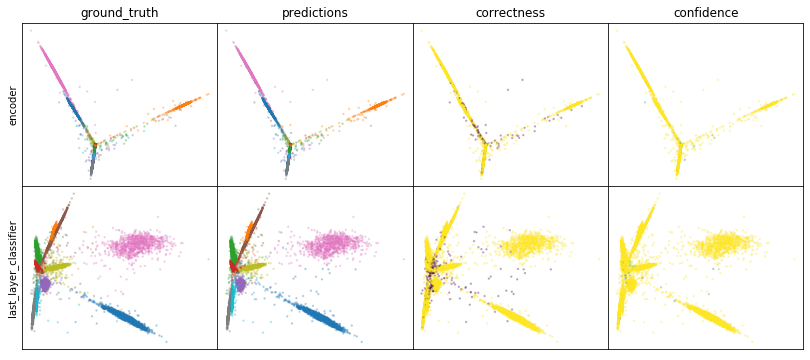

W0808 08:30:05.746289 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:30:06.496773 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:30:07.201653 139838875297536 legend.py:1282] No handles with labels found to put in legend.


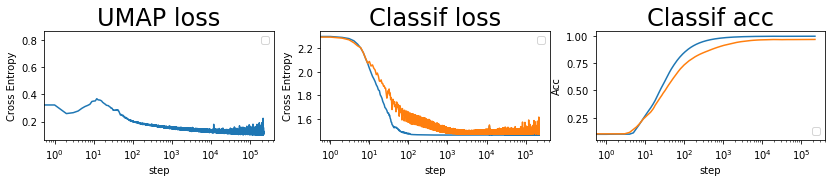

batch: 224000 | train acc: 0.9996 | val acc: 0.9702


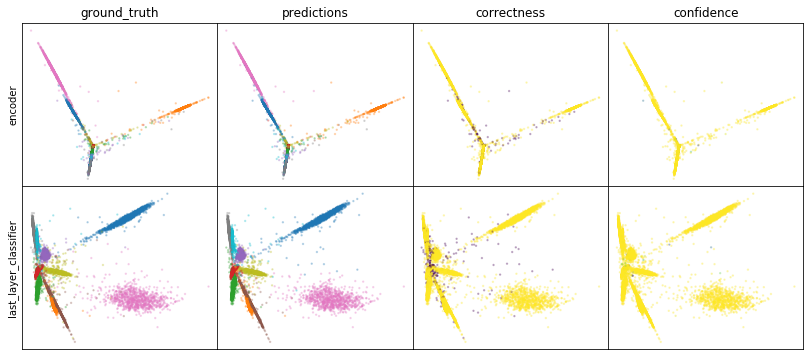

W0808 08:33:07.957285 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:33:08.697695 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:33:09.421024 139838875297536 legend.py:1282] No handles with labels found to put in legend.


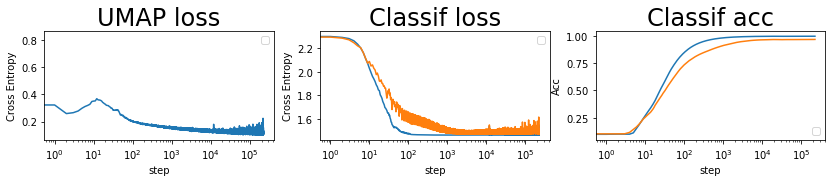

batch: 225000 | train acc: 0.9996 | val acc: 0.9702


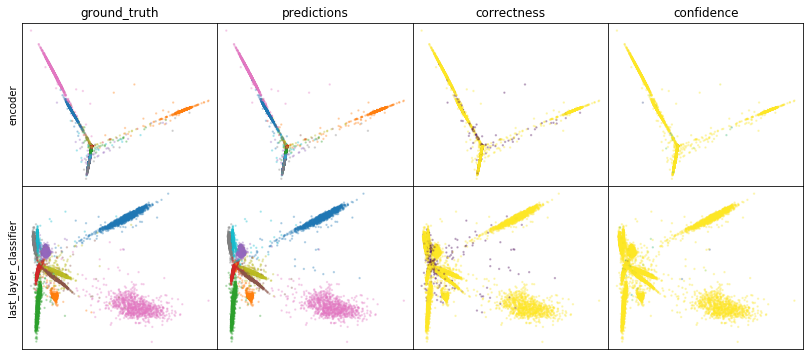

W0808 08:36:47.835265 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:36:48.602754 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:36:49.339113 139838875297536 legend.py:1282] No handles with labels found to put in legend.


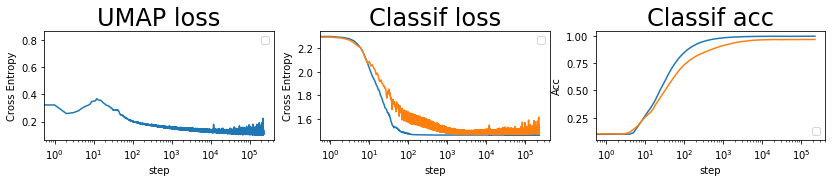

batch: 226000 | train acc: 0.9996 | val acc: 0.9703


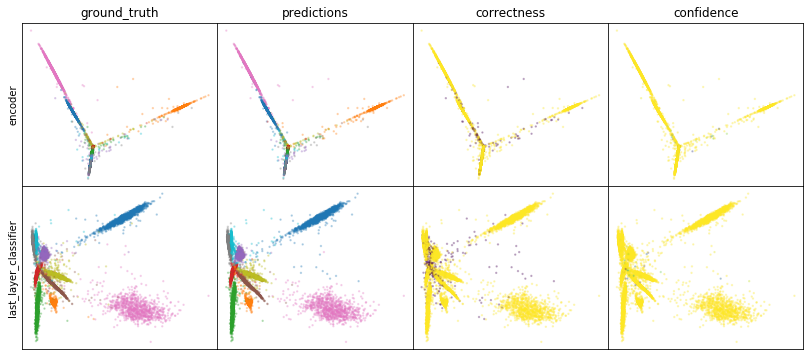

W0808 08:39:52.872390 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:39:53.610347 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:39:54.331066 139838875297536 legend.py:1282] No handles with labels found to put in legend.


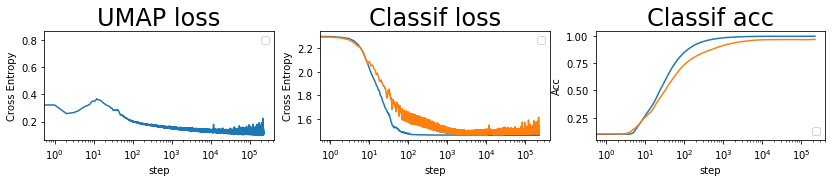

batch: 227000 | train acc: 0.9996 | val acc: 0.9703


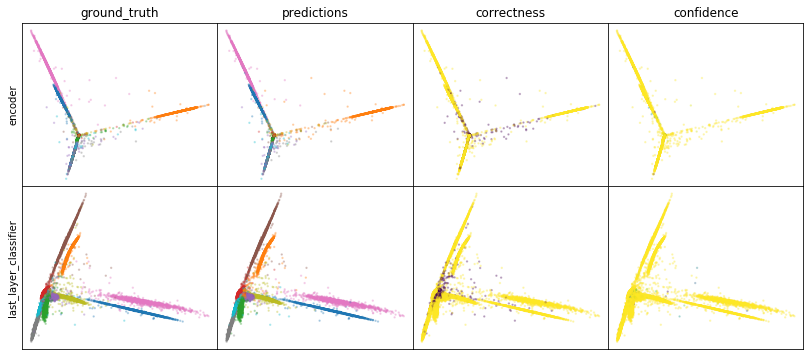

W0808 08:43:02.699923 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:43:03.456219 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:43:04.171547 139838875297536 legend.py:1282] No handles with labels found to put in legend.


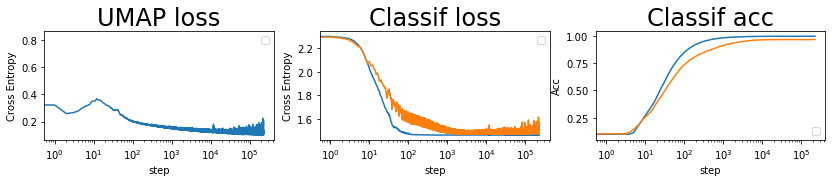

batch: 228000 | train acc: 0.9996 | val acc: 0.9703


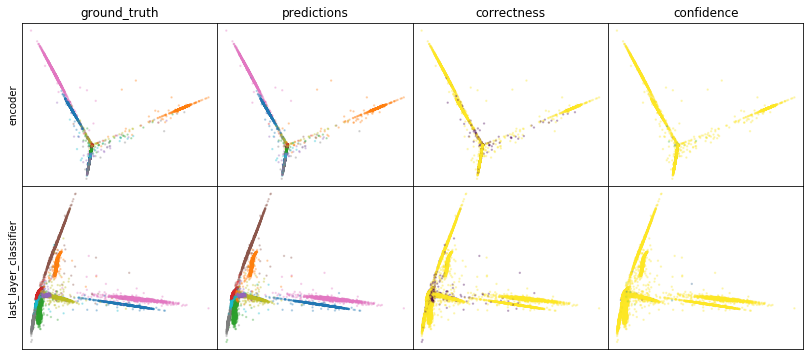

W0808 08:46:11.937573 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:46:12.789683 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:46:13.535703 139838875297536 legend.py:1282] No handles with labels found to put in legend.


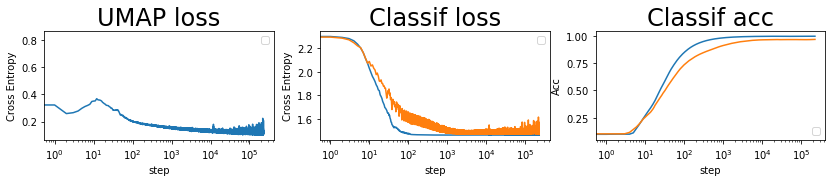

batch: 229000 | train acc: 0.9996 | val acc: 0.9703


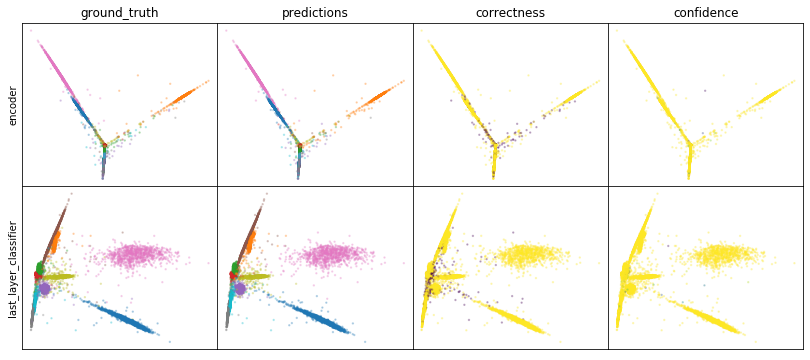

W0808 08:49:16.736268 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:49:17.500285 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:49:18.231212 139838875297536 legend.py:1282] No handles with labels found to put in legend.


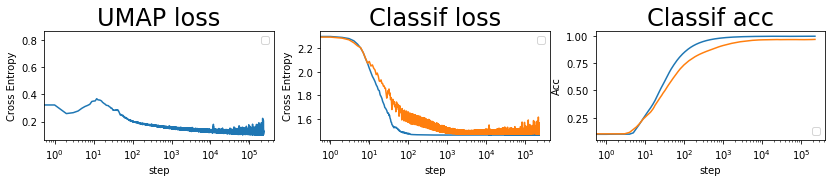

batch: 230000 | train acc: 0.9996 | val acc: 0.9704


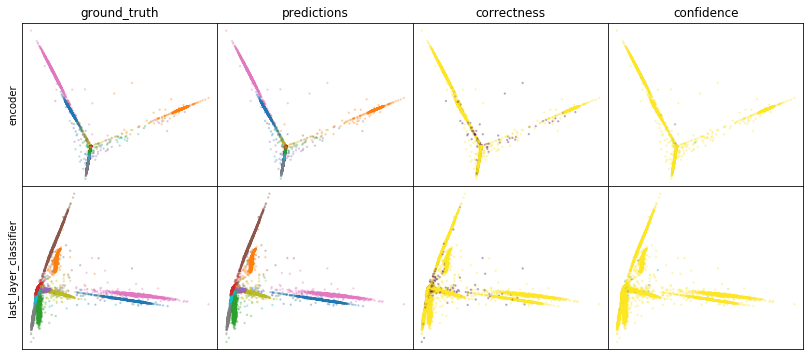

W0808 08:52:56.978595 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:52:57.740811 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:52:58.475835 139838875297536 legend.py:1282] No handles with labels found to put in legend.


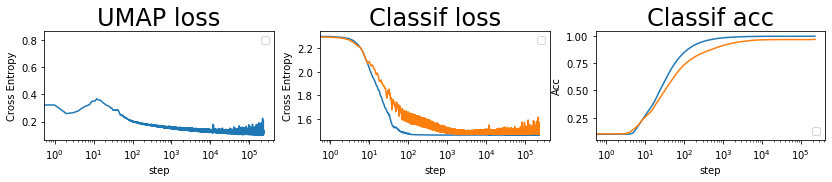

batch: 231000 | train acc: 0.9996 | val acc: 0.9704


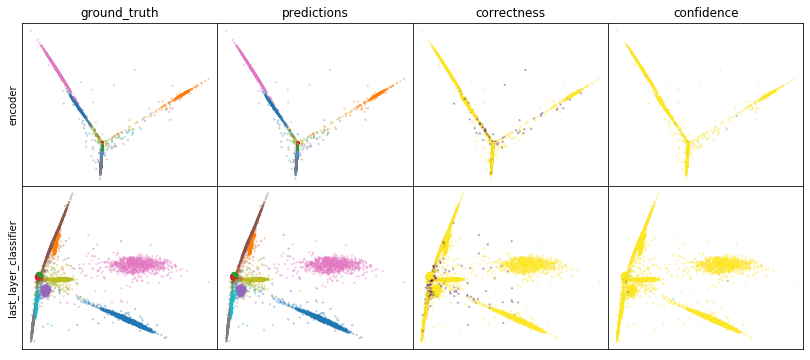

W0808 08:56:01.960640 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:56:02.717091 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:56:03.446724 139838875297536 legend.py:1282] No handles with labels found to put in legend.


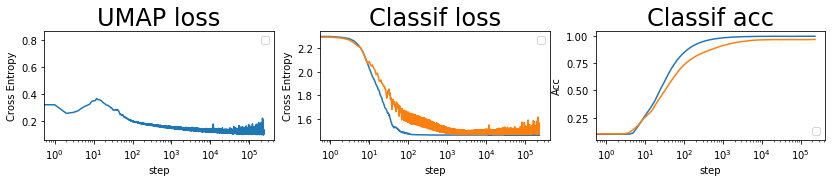

batch: 232000 | train acc: 0.9996 | val acc: 0.9705


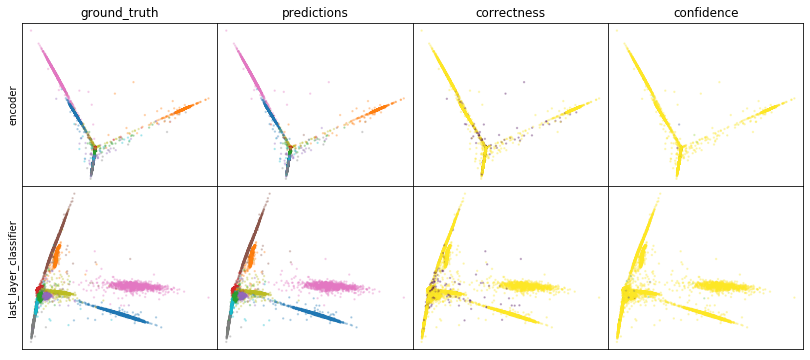

W0808 08:59:43.549998 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:59:44.323244 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 08:59:45.052658 139838875297536 legend.py:1282] No handles with labels found to put in legend.


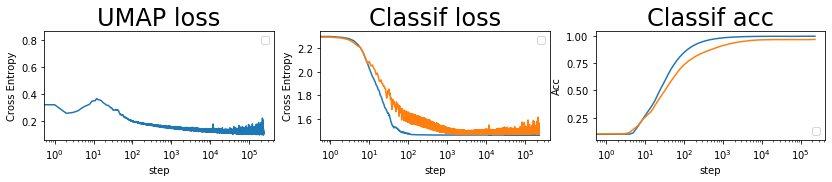

batch: 233000 | train acc: 0.9996 | val acc: 0.9705


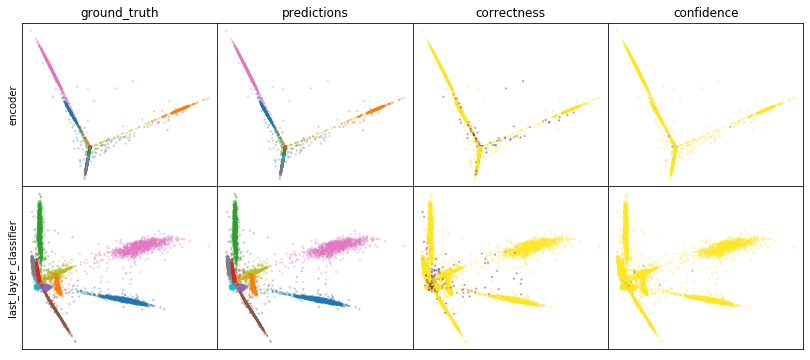

W0808 09:02:51.591953 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 09:02:52.350894 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 09:02:53.081347 139838875297536 legend.py:1282] No handles with labels found to put in legend.


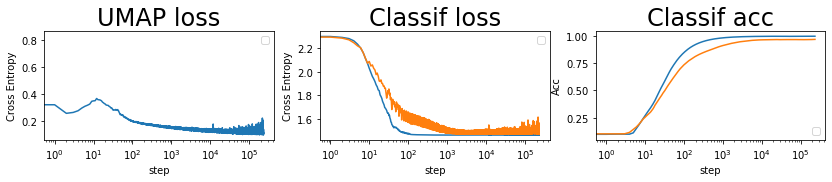

batch: 234000 | train acc: 0.9996 | val acc: 0.9705


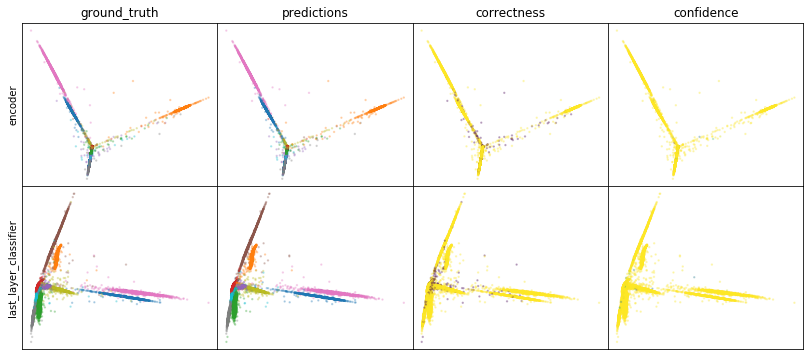

W0808 09:06:30.735579 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 09:06:31.501080 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 09:06:32.230470 139838875297536 legend.py:1282] No handles with labels found to put in legend.


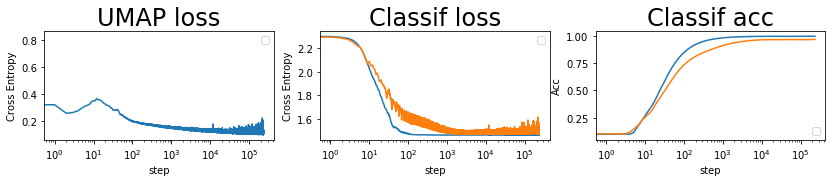

batch: 235000 | train acc: 0.9996 | val acc: 0.9706


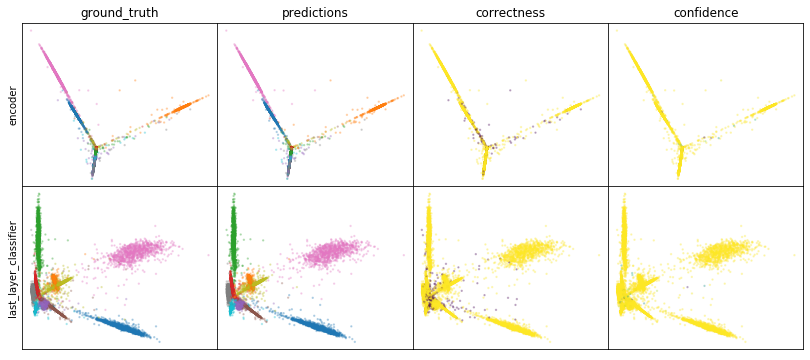

W0808 09:09:38.264570 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 09:09:39.046348 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 09:09:39.799802 139838875297536 legend.py:1282] No handles with labels found to put in legend.


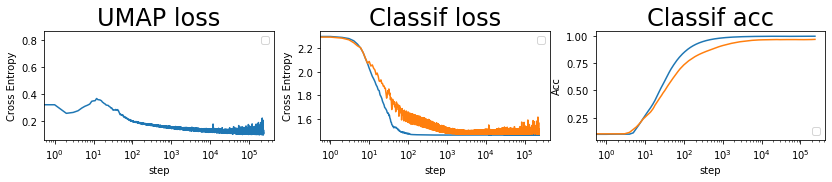

batch: 236000 | train acc: 0.9996 | val acc: 0.9706


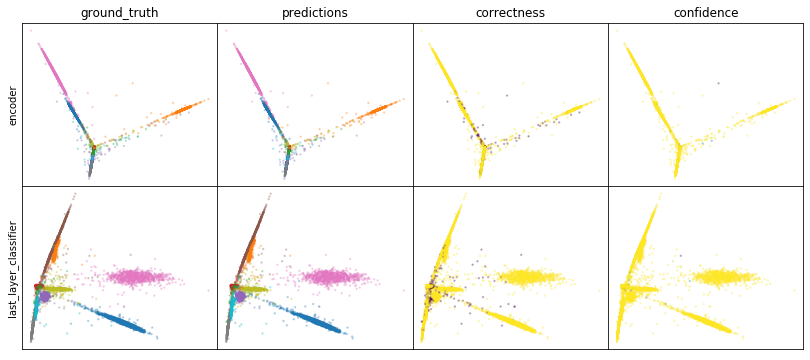

W0808 09:13:47.186287 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 09:13:47.966283 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 09:13:48.715267 139838875297536 legend.py:1282] No handles with labels found to put in legend.


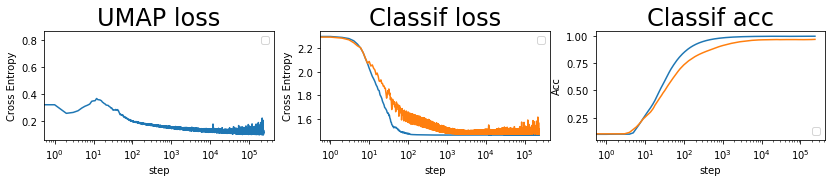

batch: 237000 | train acc: 0.9996 | val acc: 0.9707


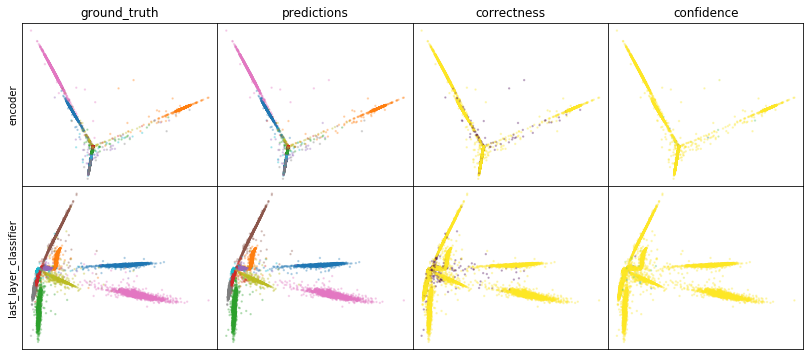

W0808 09:16:54.013564 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 09:16:54.806964 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 09:16:55.580142 139838875297536 legend.py:1282] No handles with labels found to put in legend.


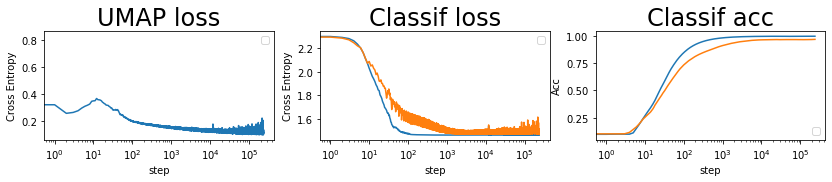

batch: 238000 | train acc: 0.9996 | val acc: 0.9707


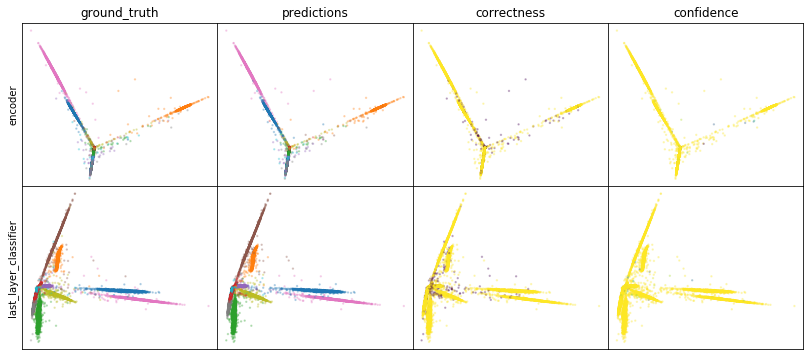

W0808 09:20:35.570984 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 09:20:36.357371 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 09:20:37.106958 139838875297536 legend.py:1282] No handles with labels found to put in legend.


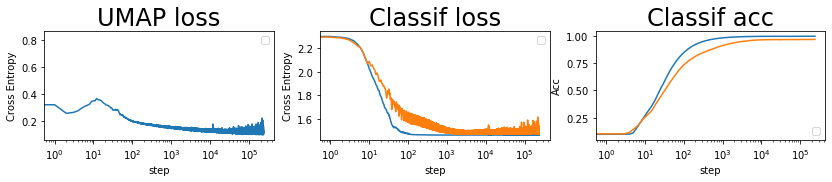

batch: 239000 | train acc: 0.9996 | val acc: 0.9707


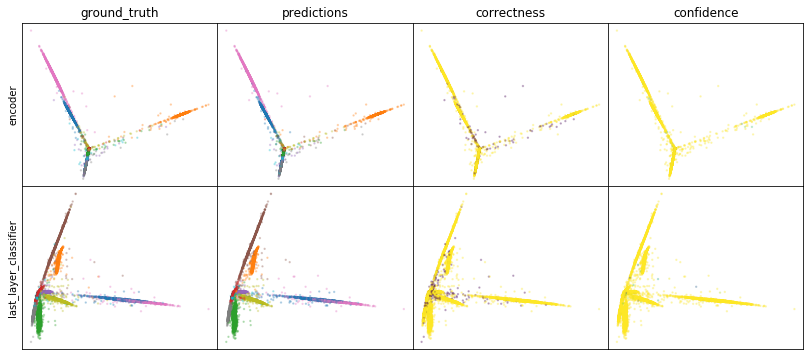

W0808 09:23:43.534360 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 09:23:44.336097 139838875297536 legend.py:1282] No handles with labels found to put in legend.
W0808 09:23:45.095170 139838875297536 legend.py:1282] No handles with labels found to put in legend.


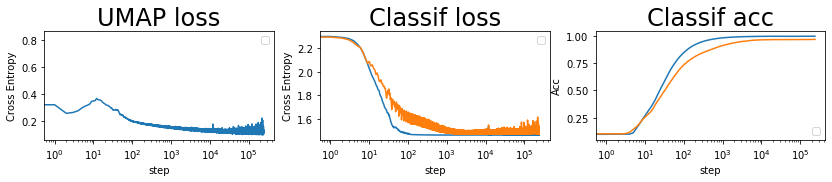

batch: 240000 | train acc: 0.9996 | val acc: 0.9708


KeyboardInterrupt: 

In [35]:
improved_this_epoch = True
for edge_epoch, epoch in tqdm(
    zip(edge_iter, np.arange(N_EPOCHS)), total=N_EPOCHS, desc="epoch"
):

    pbar = tqdm(total=BATCHES_PER_EPOCH, leave=False, desc="loss")

    for (batch_to, batch_from), (X, y), (X_val, y_val) in zip(
        edge_epoch, labeled_iter, data_valid
    ):

        # train
        (
            attraction_loss,
            repellant_loss,
            umap_loss,
            classifier_loss,
            classifier_acc,
        ) = model.train(
            batch_to=X_train[np.array(batch_to)],
            batch_from=X_train[np.array(batch_from)],
            X=X,
            y=y,
            umap_prop=umap_prop,
        )

        # compute validation loss
        val_loss, val_acc = compute_classifier_loss(
            X_val,
            y_val,
            model.encoder,
            model.classifier,
            model.sparse_ce,
            model.class_acc_val,
        )

        pbar.update()
        pbar.set_description("val acc: {}".format(str(round(val_acc.numpy(), 5))))

        # save losses
        model.write_losses(
            tf.convert_to_tensor(batch, dtype=tf.int64),
            classifier_acc,
            classifier_loss,
            umap_loss,
            val_loss,
            val_acc,
        )

        # plot results
        if batch % plot_frequency == 0:
            plot_umap_classif_results(
                model,
                X_valid,
                Y_valid,
                X_train,
                X_labeled,
                Y_labeled,
                batch_size,
                cmap="tab10",
                cmap2="tab10",
            )
            print(
                "batch: {} | train acc: {} | val acc: {}".format(
                    str(batch),
                    str(round(classifier_acc.numpy(), 4)),
                    str(round(val_acc.numpy(), 4)),
                )
            )

        # make any improvement isn't a fluke of small batch size
        if batches_since_last_reload >= reload_tolerance:

            # save if validation accuracy went up
            if val_acc > best_saved_acc + max_save_delta:
                # save weights
                print(
                    "saving weights | batch = {} | acc = {}".format(
                        batch, round(val_acc.numpy() * 100, 3)
                    )
                )
                model.encoder.save_weights((cpt_path / "encoder").as_posix())
                model.classifier.save_weights((cpt_path / "classifier").as_posix())
                best_saved_acc = val_acc.numpy()
                # save batch number
                best_saved_batch = copy.deepcopy(batch)

            # reinitialize if validation accuracy went down
            if val_acc < (best_saved_acc - max_reinitialize_delta):
                # if
                if batches_since_last_reload >= reload_tolerance:
                    batches_since_last_reload = 0
                    lr = model.optimizer.lr.numpy()
                    print(
                        "batch {} | acc = {} | learn rate = {} | reloading weights from batch {} at acc {} | n reloads = {}".format(
                            batch,
                            str(round(val_acc.numpy(), 3)),
                            lr,
                            best_saved_batch,
                            int(best_saved_acc * 100),
                            n_reloads,
                        )
                    )
                    # reload weights
                    model.encoder.load_weights((cpt_path / "encoder").as_posix())
                    model.classifier.load_weights((cpt_path / "classifier").as_posix())

                    # set new learning rate
                    model.optimizer.lr.assign(lr / 2)

                    batch += 1
                    n_reloads += 1

                    # stop if reloaded too many times
                    if n_reloads >= max_reloads:
                        break

            # if there is an imporovement, set new best score
            if val_acc > best_acc + min_delta:
                improved_this_epoch = True
                last_improvement = 0
                best_acc = val_acc
            # if the model has not improved in patience batches, end epoch
            elif last_improvement >= patience:
                last_improvement = 0
                print(
                    "leaving epoch because no improvement in {} batches".format(
                        patience
                    )
                )
                break
            else:
                last_improvement += 1

        # up the ticker
        batch += 1
        batches_since_last_reload += 1
    pbar.close()

In [36]:
test_enc = model_data(X_test, batch_size, model.encoder)
y_pred = model_data(test_enc, batch_size, model.classifier)
test_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_test, y_pred
).numpy()
print(np.mean(test_acc))

0.9678


In [37]:
np.save(cpt_path / 'test_acc.npy', test_acc)

In [39]:
pred_model = tf.keras.models.Model(model.classifier.input,[model.classifier.get_layer(name="dense_1").get_output_at(0)])

In [40]:
z_enc = model_data(X_train, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)
umap_class = UMAP(verbose=True).fit_transform(last_layer_class, Y_masked)
classifications = np.argmax(z_pred, axis=1)
correctness = classifications == Y_train
np.save(cpt_path / 'train_last_layer_class.npy', last_layer_class)
np.save(cpt_path / 'train_z_enc.npy', z_enc)
np.save(cpt_path / 'train_last_layer_class_umap.npy', umap_class)

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Sat Aug  8 09:25:47 2020 Finding Nearest Neighbors
Sat Aug  8 09:25:47 2020 Building RP forest with 16 trees
Sat Aug  8 09:25:48 2020 parallel NN descent for 16 iterations
	 0  /  16
	 1  /  16
Sat Aug  8 09:26:00 2020 Finished Nearest Neighbor Search
Sat Aug  8 09:26:02 2020 Construct embedding
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Sat Aug  8 09:27:30 2020 Finished embedding


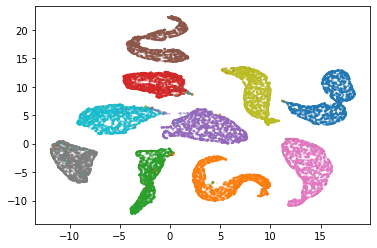

In [41]:
plt.scatter(umap_class[:,0], umap_class[:,1], c =Y_train,  cmap = plt.cm.tab10, s = 1, alpha = 0.25)

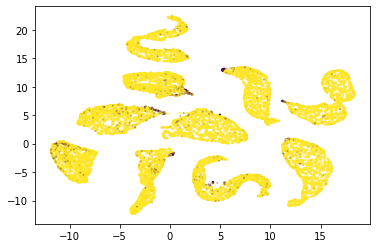

In [42]:
plt.scatter(umap_class[:,0], umap_class[:,1], c =correctness,  cmap = plt.cm.viridis, s = 1, alpha = 0.25)